In [2]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns

In [3]:

df = pd.read_csv('turkey_earthquakes(1915-2024_feb).csv', index_col="No")
df.head(4)

,Deprem Kodu,Olus tarihi,Olus zamani,Enlem,Boylam,Derinlik,xM,MD,ML,Mw,Ms,Mb,Tip,Yer
No,,,,,,,,,,,,,,
1,20231231222846,2023.12.31,22:28:46.51,37.4900,43.7095,2.6,3.8,0.0,3.8,3.8,0.0,0.0,Ke,BAYKOY- (HAKKARI) [South 6.8 km]
2,20231231170605,2023.12.31,17:06:05.42,37.4405,43.9263,5.0,4.5,0.0,4.5,4.4,0.0,0.0,Ke,YAZILI-YUKSEKOVA (HAKKARI) [South West 3.6 km]
3,20231231165304,2023.12.31,16:53:04.13,37.4942,43.6955,5.0,3.5,0.0,3.5,3.4,0.0,0.0,Ke,CIMENLI- (HAKKARI) [East 6.1 km]
4,20231231163755,2023.12.31,16:37:55.84,37.4763,43.6965,5.0,4.6,0.0,4.6,4.4,0.0,0.0,Ke,CIMENLI- (HAKKARI) [South East 6.3 km]


In [4]:
print(f"NUMBER OF EARTHQUAKES: {df.shape[0]}")
df.info()

NUMBER OF EARTHQUAKES: 20307
<class 'pandas.core.frame.DataFrame'>
Int64Index: 20307 entries, 1 to 20307
Data columns (total 14 columns):
 #   Column       Non-Null Count  Dtype  
---  ------       --------------  -----  
 0   Deprem Kodu  20307 non-null  int64  
 1   Olus tarihi  20307 non-null  object 
 2   Olus zamani  20307 non-null  object 
 3   Enlem        20307 non-null  float64
 4   Boylam       20307 non-null  float64
 5   Derinlik     20307 non-null  float64
 6   xM           20307 non-null  float64
 7   MD           20307 non-null  float64
 8   ML           20307 non-null  float64
 9   Mw           7326 non-null   float64
 10  Ms           20307 non-null  float64
 11  Mb           20307 non-null  float64
 12  Tip          20307 non-null  object 
 13  Yer          20307 non-null  object 
dtypes: float64(9), int64(1), object(4)
memory usage: 2.3+ MB


In [5]:
# This code calculates and displays the number of missing (NaN/null) values in each column of the DataFrame
# Bu kod, veri çerçevesindeki her sütunda bulunan eksik (NaN/null) değerlerin sayısını hesaplar ve gösterir
df.isna().sum()


Deprem Kodu        0
Olus tarihi        0
Olus zamani        0
Enlem              0
Boylam             0
Derinlik           0
xM                 0
MD                 0
ML                 0
Mw             12981
Ms                 0
Mb                 0
Tip                0
Yer                0
dtype: int64

In [6]:
# More efficient processing of date/time data
df['Olus zamani'] = pd.to_datetime(df['Olus zamani']).dt.time

# Check validity of coordinate data
coordinate_check = (
    (df['Enlem'].between(35, 43)) & 
    (df['Boylam'].between(25, 45))
)
print(f"Number of invalid coordinates: {(~coordinate_check).sum()}")

# Detect outliers
for col in ['Derinlik', 'Mw', 'ML', 'MD', 'Ms', 'Mb']:
    Q1 = df[col].quantile(0.25)
    Q3 = df[col].quantile(0.75)
    IQR = Q3 - Q1
    print(f"\nNumber of outliers in {col} column:", 
          ((df[col] < (Q1 - 1.5 * IQR)) | (df[col] > (Q3 + 1.5 * IQR))).sum())

Number of invalid coordinates: 0

Number of outliers in Derinlik column: 2785

Number of outliers in Mw column: 805

Number of outliers in ML column: 0

Number of outliers in MD column: 0

Number of outliers in Ms column: 1961

Number of outliers in Mb column: 0


In [7]:
# To examine outliers in more detail
for col in ['Derinlik', 'Mw', 'ML', 'MD', 'Ms', 'Mb']:
    Q1 = df[col].quantile(0.25)
    Q3 = df[col].quantile(0.75)
    IQR = Q3 - Q1
    lower_bound = Q1 - 1.5 * IQR
    upper_bound = Q3 + 1.5 * IQR
    
    outliers = df[(df[col] < lower_bound) | (df[col] > upper_bound)]
    
    print(f"\nOutlier statistics for {col}:")
    print(f"Lower bound: {lower_bound:.2f}")
    print(f"Upper bound: {upper_bound:.2f}")
    print(f"Number of outliers: {len(outliers)}")
    print(f"Outlier range (min-max): {outliers[col].min():.2f} - {outliers[col].max():.2f}")


Outlier statistics for Derinlik:
Lower bound: -8.50
Upper bound: 27.50
Number of outliers: 2785
Outlier range (min-max): 27.70 - 199.00

Outlier statistics for Mw:
Lower bound: 2.25
Upper bound: 5.85
Number of outliers: 805
Outlier range (min-max): 0.00 - 7.70

Outlier statistics for ML:
Lower bound: -6.00
Upper bound: 10.00
Number of outliers: 0
Outlier range (min-max): nan - nan

Outlier statistics for MD:
Lower bound: -5.55
Upper bound: 9.25
Number of outliers: 0
Outlier range (min-max): nan - nan

Outlier statistics for Ms:
Lower bound: 0.00
Upper bound: 0.00
Number of outliers: 1961
Outlier range (min-max): 3.30 - 7.90

Outlier statistics for Mb:
Lower bound: -5.25
Upper bound: 8.75
Number of outliers: 0
Outlier range (min-max): nan - nan


In [8]:
df

,Deprem Kodu,Olus tarihi,Olus zamani,Enlem,Boylam,Derinlik,xM,MD,ML,Mw,Ms,Mb,Tip,Yer
No,,,,,,,,,,,,,,
1,20231231222846,2023.12.31,22:28:46.510000,37.4900,43.7095,2.6,3.8,0.0,3.8,3.8,0.0,0.0,Ke,BAYKOY- (HAKKARI) [South 6.8 km]
2,20231231170605,2023.12.31,17:06:05.420000,37.4405,43.9263,5.0,4.5,0.0,4.5,4.4,0.0,0.0,Ke,YAZILI-YUKSEKOVA (HAKKARI) [South West 3.6 km]
3,20231231165304,2023.12.31,16:53:04.130000,37.4942,43.6955,5.0,3.5,0.0,3.5,3.4,0.0,0.0,Ke,CIMENLI- (HAKKARI) [East 6.1 km]
4,20231231163755,2023.12.31,16:37:55.840000,37.4763,43.6965,5.0,4.6,0.0,4.6,4.4,0.0,0.0,Ke,CIMENLI- (HAKKARI) [South East 6.3 km]
5,20231230204324,2023.12.30,20:43:24.210000,40.2272,29.1705,12.9,3.6,0.0,3.6,3.4,0.0,0.0,Ke,GURSU (BURSA) [North West 2.2 km]
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
20303,19150923072001,1915.09.23,07:20:01,40.0000,43.0000,15.0,4.4,4.4,0.0,NaN,0.0,0.0,Ke,EVYAPAN-KAGIZMAN (KARS) [South West 5.8 km]
20304,19150519044802,1915.05.19,04:48:02.400000,37.6200,39.4700,10.0,5.5,5.3,5.3,5.5,5.4,5.3,Ke,CATLI-SIVEREK (SANLIURFA) [South East 3.5 km]
20305,19150401054105,1915.04.01,05:41:05,40.5000,44.5000,35.0,4.9,4.8,4.8,4.9,4.8,4.9,Ke,AZERBAYCAN


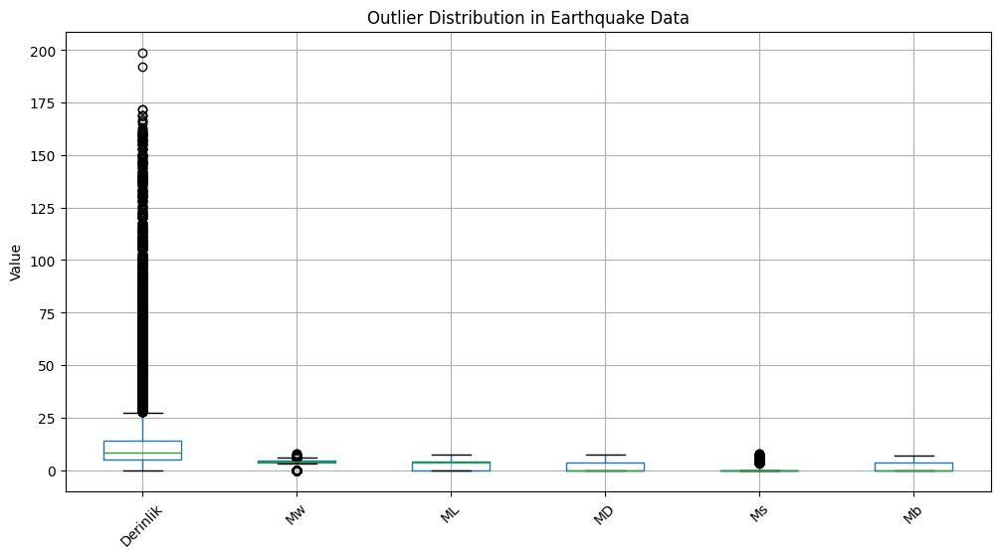

In [9]:
plt.figure(figsize=(12, 6))
df.boxplot(column=['Derinlik', 'Mw', 'ML', 'MD', 'Ms', 'Mb'])
plt.title('Outlier Distribution in Earthquake Data')
plt.xticks(rotation=45)
plt.ylabel('Value')
plt.show()


Outliers for Derinlik:
Lower bound: -8.50
Upper bound: 27.50
Number of outliers: 2785

Sample outliers:
       Derinlik Olus tarihi  Enlem  Boylam
No                                        
19449     199.0  1960.11.18  35.17   27.83
16147     192.0  1983.09.27  36.99   26.90
13627     172.0  1993.12.04  35.91   26.88
19229     172.0  1966.08.19  38.40   41.20
19107     169.0  1967.08.28  36.73   26.72

Outliers for Mw:
Lower bound: 2.25
Upper bound: 5.85
Number of outliers: 805

Sample outliers:
        Mw Olus tarihi    Enlem   Boylam
No                                      
19921  7.7  1939.12.26  39.8000  39.5100
1824   7.7  2023.02.06  37.1757  37.0850
1636   7.6  2023.02.06  38.0818  37.1773
12010  7.4  1999.08.17  40.7600  29.9700
20139  7.2  1926.06.26  36.5400  27.3300


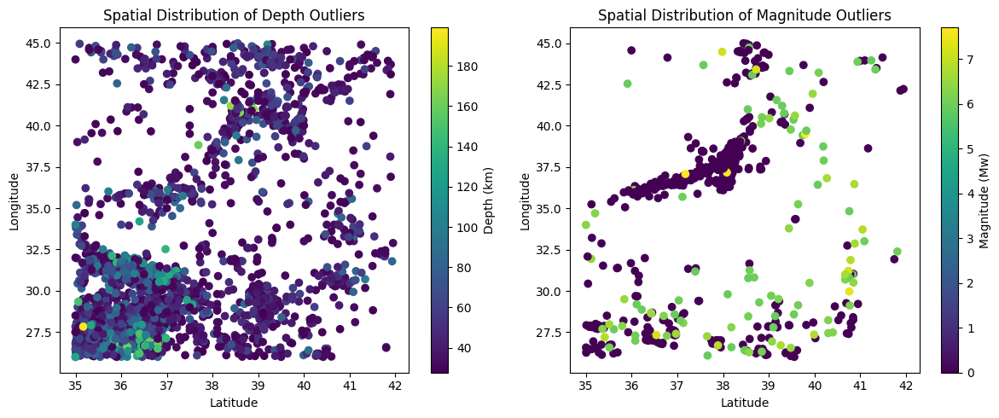

In [10]:
# Find outliers for depth and magnitude
def show_outliers(df, column):
    Q1 = df[column].quantile(0.25)
    Q3 = df[column].quantile(0.75)
    IQR = Q3 - Q1
    lower_bound = Q1 - 1.5 * IQR
    upper_bound = Q3 + 1.5 * IQR
    
    outliers = df[(df[column] < lower_bound) | (df[column] > upper_bound)]
    print(f"\nOutliers for {column}:")
    print(f"Lower bound: {lower_bound:.2f}")
    print(f"Upper bound: {upper_bound:.2f}")
    print(f"Number of outliers: {len(outliers)}")
    print("\nSample outliers:")
    print(outliers[[column, 'Olus tarihi', 'Enlem', 'Boylam']].sort_values(by=column, ascending=False).head())
    return outliers

# Outliers for depth
depth_outliers = show_outliers(df, 'Derinlik')

# Outliers for magnitude (Mw)
mw_outliers = show_outliers(df, 'Mw')

# Visualization
plt.figure(figsize=(12, 5))
plt.subplot(1, 2, 1)
plt.scatter(depth_outliers['Enlem'], depth_outliers['Boylam'], c=depth_outliers['Derinlik'], cmap='viridis')
plt.colorbar(label='Depth (km)')
plt.title('Spatial Distribution of Depth Outliers')
plt.xlabel('Latitude')
plt.ylabel('Longitude')

plt.subplot(1, 2, 2)
plt.scatter(mw_outliers['Enlem'], mw_outliers['Boylam'], c=mw_outliers['Mw'], cmap='viridis')
plt.colorbar(label='Magnitude (Mw)')
plt.title('Spatial Distribution of Magnitude Outliers')
plt.xlabel('Latitude')
plt.ylabel('Longitude')

plt.tight_layout()
plt.show()

In [11]:
# Find outliers for Depth
Q1 = df['Derinlik'].quantile(0.25)
Q3 = df['Derinlik'].quantile(0.75)
IQR = Q3 - Q1
lower_bound = Q1 - 1.5 * IQR
upper_bound = Q3 + 1.5 * IQR

# Find outliers
outliers = df[(df['Derinlik'] < lower_bound) | (df['Derinlik'] > upper_bound)]

# Show first 10 outliers
print(f"\nBoundaries for Depth:")
print(f"Lower bound: {lower_bound:.2f}")
print(f"Upper bound: {upper_bound:.2f}")
print(f"Number of outliers: {len(outliers)}")
print("\nHighest 10 depth values:")
print(outliers[['Derinlik', 'Olus tarihi', 'Enlem', 'Boylam', 'Mw']].sort_values(by='Derinlik', ascending=False).head(10))
# Show first 10 outliers with lowest depth values
print(f"\nBoundaries for Depth:")
print(f"Lower bound: {lower_bound:.2f}")
print(f"Upper bound: {upper_bound:.2f}")
print(f"Number of outliers: {len(outliers)}")
print("\nLowest 10 depth values:")
print(outliers[['Derinlik', 'Olus tarihi', 'Enlem', 'Boylam', 'Mw']].sort_values(by='Derinlik', ascending=True).head(10))


Boundaries for Depth:
Lower bound: -8.50
Upper bound: 27.50
Number of outliers: 2785

Highest 10 depth values:
       Derinlik Olus tarihi  Enlem  Boylam   Mw
No                                             
19449     199.0  1960.11.18  35.17   27.83  4.9
16147     192.0  1983.09.27  36.99   26.90  NaN
13627     172.0  1993.12.04  35.91   26.88  NaN
19229     172.0  1966.08.19  38.40   41.20  4.7
19107     169.0  1967.08.28  36.73   26.72  4.8
14678     169.0  1990.03.09  36.70   26.95  NaN
18886     169.0  1969.07.23  38.90   41.00  4.4
17088     167.0  1978.10.25  36.69   27.07  NaN
15924     166.0  1984.06.20  36.69   27.05  NaN
17902     166.0  1975.09.06  38.60   40.80  NaN

Boundaries for Depth:
Lower bound: -8.50
Upper bound: 27.50
Number of outliers: 2785

Lowest 10 depth values:
      Derinlik Olus tarihi    Enlem   Boylam   Mw
No                                               
5784      27.7  2013.09.25  35.4743  26.3215  NaN
9599      27.7  2005.05.31  37.6528  43.8433  NaN
7

In [12]:
# Derinlik için makul sınırlar belirleme
df_cleaned = df.copy()

# Negatif derinlikleri düzeltme (0'a eşitleme)
df_cleaned.loc[df_cleaned['Derinlik'] < 0, 'Derinlik'] = 0

In [13]:
print("Original depth statistics:")
print(df['Derinlik'].describe())
print("\nCleaned depth statistics:")
print(df_cleaned['Derinlik'].describe())

Original depth statistics:
count    20307.000000
mean        14.657108
std         20.563169
min          0.000000
25%          5.000000
50%          8.300000
75%         14.000000
max        199.000000
Name: Derinlik, dtype: float64

Cleaned depth statistics:
count    20307.000000
mean        14.657108
std         20.563169
min          0.000000
25%          5.000000
50%          8.300000
75%         14.000000
max        199.000000
Name: Derinlik, dtype: float64


In [14]:
# Her bir magnitüd türü için aykırı değerleri kontrol etme.
for col in ['Mw', 'ML', 'MD', 'Ms', 'Mb']:
    Q1 = df[col].quantile(0.25)
    Q3 = df[col].quantile(0.75)
    IQR = Q3 - Q1
    lower_bound = Q1 - 1.5 * IQR
    upper_bound = Q3 + 1.5 * IQR
    
    outliers = df[(df[col] < lower_bound) | (df[col] > upper_bound)]
    
    print(f"\nOutliers for {col}:")
    print(f"Lower bound: {lower_bound:.2f}")
    print(f"Upper bound: {upper_bound:.2f}")
    print(f"Number of outliers: {len(outliers)}")
    print("\nHighest 5 values:")
    print(outliers[[col, 'Olus tarihi', 'Enlem', 'Boylam']].sort_values(by=col, ascending=False).head())
    print("\nLowest 5 values:")
    print(outliers[[col, 'Olus tarihi', 'Enlem', 'Boylam']].sort_values(by=col, ascending=True).head())


Outliers for Mw:
Lower bound: 2.25
Upper bound: 5.85
Number of outliers: 805

Highest 5 values:
        Mw Olus tarihi    Enlem   Boylam
No                                      
19921  7.7  1939.12.26  39.8000  39.5100
1824   7.7  2023.02.06  37.1757  37.0850
1636   7.6  2023.02.06  38.0818  37.1773
12010  7.4  1999.08.17  40.7600  29.9700
20139  7.2  1926.06.26  36.5400  27.3300

Lowest 5 values:
       Mw Olus tarihi    Enlem   Boylam
No                                     
137   0.0  2023.08.27  36.3487  27.8080
2365  0.0  2021.08.01  36.3727  27.0055
2366  0.0  2021.08.01  36.3508  27.0077
2367  0.0  2021.08.01  36.3498  27.0112
2388  0.0  2021.07.31  36.3717  27.0183

Outliers for ML:
Lower bound: -6.00
Upper bound: 10.00
Number of outliers: 0

Highest 5 values:
Empty DataFrame
Columns: [ML, Olus tarihi, Enlem, Boylam]
Index: []

Lowest 5 values:
Empty DataFrame
Columns: [ML, Olus tarihi, Enlem, Boylam]
Index: []

Outliers for MD:
Lower bound: -5.55
Upper bound: 9.25
Number of ou

In [15]:
# Mw değerleri için detaylı analiz
df_analysis = df.copy()

# 1. Sıfır olan değerleri inceleyelim
zero_mw = df_analysis[df_analysis['Mw'] == 0]
print("Number of earthquakes with Mw = 0:", len(zero_mw))

# 2. Bu sıfır değerli depremlerin diğer magnitüd ölçeklerindeki değerlerini kontrol edelim
print("\nOther magnitude values for Mw = 0 earthquakes:")
print(zero_mw[['Mw', 'ML', 'MD', 'Ms', 'Mb']].describe())

# 3. Magnitüd değerleri arasındaki ilişkiyi görelim
print("\nCorrelation between magnitude scales:")
print(df_analysis[['Mw', 'ML', 'MD', 'Ms', 'Mb']].corr())

# 4. Sıfır Mw değerleri için alternatif magnitüd değeri var mı?
zero_with_other_mag = zero_mw[
    (zero_mw['ML'].notna()) | 
    (zero_mw['MD'].notna()) | 
    (zero_mw['Ms'].notna()) | 
    (zero_mw['Mb'].notna())
]
print("\nNumber of Mw = 0 earthquakes with other magnitude measurements:", 
      len(zero_with_other_mag))

Number of earthquakes with Mw = 0: 698

Other magnitude values for Mw = 0 earthquakes:
          Mw          ML     MD     Ms     Mb
count  698.0  698.000000  698.0  698.0  698.0
mean     0.0    3.881805    0.0    0.0    0.0
std      0.0    0.428402    0.0    0.0    0.0
min      0.0    3.500000    0.0    0.0    0.0
25%      0.0    3.600000    0.0    0.0    0.0
50%      0.0    3.700000    0.0    0.0    0.0
75%      0.0    4.000000    0.0    0.0    0.0
max      0.0    6.600000    0.0    0.0    0.0

Correlation between magnitude scales:
          Mw        ML        MD        Ms        Mb
Mw  1.000000  0.412567  0.484435  0.490036  0.486174
ML  0.412567  1.000000 -0.405172  0.321300  0.104268
MD  0.484435 -0.405172  1.000000  0.425702  0.073062
Ms  0.490036  0.321300  0.425702  1.000000  0.620059
Mb  0.486174  0.104268  0.073062  0.620059  1.000000

Number of Mw = 0 earthquakes with other magnitude measurements: 698


In [16]:
df_cleaned = df.copy()

# Sadece Mw=0 VE diğer magnitüd ölçekleri de 0 veya boş olan kayıtları işaretleme
mask = (df_cleaned['Mw'] == 0) & \
       (df_cleaned['ML'].isna() | (df_cleaned['ML'] == 0)) & \
       (df_cleaned['MD'].isna() | (df_cleaned['MD'] == 0)) & \
       (df_cleaned['Ms'].isna() | (df_cleaned['Ms'] == 0)) & \
       (df_cleaned['Mb'].isna() | (df_cleaned['Mb'] == 0))

# Bu kayıtları NaN yapma
df_cleaned.loc[mask, 'Mw'] = None

print("\nNumber of clearly erroneous records:", mask.sum())


Number of clearly erroneous records: 0


In [17]:
    
# Bu kod, veri setindeki sütunlardan %66'sınden fazlası boş (NaN) olan sütunları bulur
# df.isna().sum() -> her sütundaki boş değerlerin sayısını hesaplar
# df.shape[0] -> toplam satır sayısını verir
# 0.66 * df.shape[0] -> satır sayısının %66'sını hesaplar
# > 0.66 * df.shape[0] -> boş değer sayısının %66'dan fazla olup olmadığını kontrol eder
# df.loc[:, ...] -> bu koşulu sağlayan sütunları seçer
# .columns -> seçilen sütunların isimlerini alır
null_columns = df.loc[:, df.isna().sum() > 0.66 * df.shape[0]].columns


In [18]:
# This code shows that the number of missing values in each column
# Bu kod her sütundaki eksik değerlerin sayısını gösterir
print("\nMissing values in each column:")
print(df.isnull().sum())



Missing values in each column:
Deprem Kodu        0
Olus tarihi        0
Olus zamani        0
Enlem              0
Boylam             0
Derinlik           0
xM                 0
MD                 0
ML                 0
Mw             12981
Ms                 0
Mb                 0
Tip                0
Yer                0
dtype: int64


In [19]:
# This code shows that summary statistics for the DataFrame
# Bu kod, veri çerçevesinin özet istatistiklerini gösterir  
print("\nSummary statistics:")
print(df.describe())


Summary statistics:
        Deprem Kodu         Enlem        Boylam      Derinlik            xM  \
count  2.030700e+04  20307.000000  20307.000000  20307.000000  20307.000000   
mean   1.999319e+13     38.046572     32.508673     14.657108      3.981410   
std    2.040180e+11      1.594676      5.832697     20.563169      0.529157   
min    1.915021e+13     35.000000     26.000000      0.000000      3.500000   
25%    1.988053e+13     36.830000     27.600000      5.000000      3.600000   
50%    2.004051e+13     38.106500     29.860000      8.300000      3.800000   
75%    2.016011e+13     39.116350     37.345000     14.000000      4.200000   
max    2.023123e+13     41.998200     44.999200    199.000000      7.900000   

                 MD            ML           Mw            Ms            Mb  
count  20307.000000  20307.000000  7326.000000  20307.000000  20307.000000  
mean       1.686231      2.324519     3.800205      0.456980      1.127390  
std        1.988864      2.026609   

In [20]:
df

,Deprem Kodu,Olus tarihi,Olus zamani,Enlem,Boylam,Derinlik,xM,MD,ML,Mw,Ms,Mb,Tip,Yer
No,,,,,,,,,,,,,,
1,20231231222846,2023.12.31,22:28:46.510000,37.4900,43.7095,2.6,3.8,0.0,3.8,3.8,0.0,0.0,Ke,BAYKOY- (HAKKARI) [South 6.8 km]
2,20231231170605,2023.12.31,17:06:05.420000,37.4405,43.9263,5.0,4.5,0.0,4.5,4.4,0.0,0.0,Ke,YAZILI-YUKSEKOVA (HAKKARI) [South West 3.6 km]
3,20231231165304,2023.12.31,16:53:04.130000,37.4942,43.6955,5.0,3.5,0.0,3.5,3.4,0.0,0.0,Ke,CIMENLI- (HAKKARI) [East 6.1 km]
4,20231231163755,2023.12.31,16:37:55.840000,37.4763,43.6965,5.0,4.6,0.0,4.6,4.4,0.0,0.0,Ke,CIMENLI- (HAKKARI) [South East 6.3 km]
5,20231230204324,2023.12.30,20:43:24.210000,40.2272,29.1705,12.9,3.6,0.0,3.6,3.4,0.0,0.0,Ke,GURSU (BURSA) [North West 2.2 km]
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
20303,19150923072001,1915.09.23,07:20:01,40.0000,43.0000,15.0,4.4,4.4,0.0,NaN,0.0,0.0,Ke,EVYAPAN-KAGIZMAN (KARS) [South West 5.8 km]
20304,19150519044802,1915.05.19,04:48:02.400000,37.6200,39.4700,10.0,5.5,5.3,5.3,5.5,5.4,5.3,Ke,CATLI-SIVEREK (SANLIURFA) [South East 3.5 km]
20305,19150401054105,1915.04.01,05:41:05,40.5000,44.5000,35.0,4.9,4.8,4.8,4.9,4.8,4.9,Ke,AZERBAYCAN


In [21]:
# Bu kod, veri setindeki sütunlardan %66'sından fazlası boş (NaN) olan sütunları bulur ve bu sütunların isimlerini null_columns değişkenine atar
# This code finds columns where more than 66% of values are empty (NaN) and assigns these column names to the null_columns variable

null_columns = df.loc[:, df.isna().sum() > 0.66 * df.shape[0]].columns



In [22]:
# Identify columns with more than 66% missing values
# This code calculates the number of missing values in each column,
# compares it to 66% of the total number of rows, and selects columns
# where the number of missing values exceeds this threshold.
null_columns = df.loc[:, df.isna().sum() > 0.66 * df.shape[0]].columns

# Display the columns with more than 66% missing values
print(null_columns)

Index([], dtype='object')


In [23]:
# Drop columns with more than 66% missing values
df = df.drop(null_columns, axis=1)

In [24]:
# Fill Missing Values in 'Mw' Column
df['Mw'] = df['Mw'].fillna(df['Mw'].mean())

In [25]:
# Eksik değer içeren satırları siler ve indeksi sıfırlar
# dropna() fonksiyonu ile eksik değer içeren satırlar silinir (axis=0 satırları belirtir)
# reset_index() ile indeks numaraları 0'dan başlayarak yeniden sıralanır
df = df.dropna(axis=0).reset_index(drop=True)


In [26]:
df.isna().sum()


Deprem Kodu    0
Olus tarihi    0
Olus zamani    0
Enlem          0
Boylam         0
Derinlik       0
xM             0
MD             0
ML             0
Mw             0
Ms             0
Mb             0
Tip            0
Yer            0
dtype: int64

In [27]:
df=df.drop('Deprem Kodu',axis=1)
# Bu kod, 'Deprem Kodu' sütununu veri setinden çıkarmaktadır.
# df.drop() fonksiyonu kullanılarak 'Deprem Kodu' sütunu silinir
# axis=1 parametresi sütun bazında silme işlemi yapılacağını belirtir



In [28]:
df


,Olus tarihi,Olus zamani,Enlem,Boylam,Derinlik,xM,MD,ML,Mw,Ms,Mb,Tip,Yer
0,2023.12.31,22:28:46.510000,37.4900,43.7095,2.6,3.8,0.0,3.8,3.800000,0.0,0.0,Ke,BAYKOY- (HAKKARI) [South 6.8 km]
1,2023.12.31,17:06:05.420000,37.4405,43.9263,5.0,4.5,0.0,4.5,4.400000,0.0,0.0,Ke,YAZILI-YUKSEKOVA (HAKKARI) [South West 3.6 km]
2,2023.12.31,16:53:04.130000,37.4942,43.6955,5.0,3.5,0.0,3.5,3.400000,0.0,0.0,Ke,CIMENLI- (HAKKARI) [East 6.1 km]
3,2023.12.31,16:37:55.840000,37.4763,43.6965,5.0,4.6,0.0,4.6,4.400000,0.0,0.0,Ke,CIMENLI- (HAKKARI) [South East 6.3 km]
4,2023.12.30,20:43:24.210000,40.2272,29.1705,12.9,3.6,0.0,3.6,3.400000,0.0,0.0,Ke,GURSU (BURSA) [North West 2.2 km]
...,...,...,...,...,...,...,...,...,...,...,...,...,...
20302,1915.09.23,07:20:01,40.0000,43.0000,15.0,4.4,4.4,0.0,3.800205,0.0,0.0,Ke,EVYAPAN-KAGIZMAN (KARS) [South West 5.8 km]
20303,1915.05.19,04:48:02.400000,37.6200,39.4700,10.0,5.5,5.3,5.3,5.500000,5.4,5.3,Ke,CATLI-SIVEREK (SANLIURFA) [South East 3.5 km]
20304,1915.04.01,05:41:05,40.5000,44.5000,35.0,4.9,4.8,4.8,4.900000,4.8,4.9,Ke,AZERBAYCAN
20305,1915.02.28,12:47:02.400000,37.7000,43.1000,30.0,5.5,5.2,5.2,5.500000,5.3,5.2,Ke,MEZRA-BEYTUSSEBAP (SIRNAK) [North West 9.0 km]


In [29]:

major_earthquakes = df.sort_values('Mw', ascending=False).head(10)
print("\nTop 10 Largest Earthquakes:")
print(major_earthquakes[['Olus tarihi', 'Mw', 'Derinlik', 'Enlem', 'Boylam']])



Top 10 Largest Earthquakes:
      Olus tarihi   Mw  Derinlik    Enlem   Boylam
1823   2023.02.06  7.7       5.5  37.1757  37.0850
19920  1939.12.26  7.7      20.0  39.8000  39.5100
1635   2023.02.06  7.6       5.0  38.0818  37.1773
12009  1999.08.17  7.4      18.0  40.7600  29.9700
20138  1926.06.26  7.2     100.0  36.5400  27.3300
6998   2011.10.23  7.2       5.0  38.7212  43.4110
11793  1999.11.12  7.2      25.0  40.7400  31.2100
20063  1930.05.06  7.1      70.0  37.9800  44.4800
2943   2020.10.30  6.9      11.2  37.8877  26.7057
19684  1953.03.18  6.8      10.0  39.9900  27.3600


In [30]:
# This code block parses date and time data to create new columns:

# Converts the 'Olus tarihi' column to datetime format
df['Olus tarihi'] = pd.to_datetime(df['Olus tarihi'])

# 'Olus tarihi' sütunundan gün bilgisini çıkarıp 'Day' sütununa atar
df['Day'] = df['Olus tarihi'].dt.day

# 'Olus tarihi' sütunundan ay bilgisini çıkarıp 'Month' sütununa atar  
df['Month'] = df['Olus tarihi'].dt.month

# 'Olus tarihi' sütunundan yıl bilgisini çıkarıp 'Year' sütununa atar
df['Year'] = df['Olus tarihi'].dt.year

# 'Olus zamani' sütunundan saat bilgisini çıkarıp 'Time' sütununa atar
df['Time'] = df['Olus zamani'].apply(lambda x: x.hour)

In [31]:
# Bu kod, 'Month', 'Year' ve 'Day' sütunlarını tam sayı (integer) veri tipine dönüştürür.
# Böylece tarih bilgileri üzerinde matematiksel işlemler yapılabilir hale gelir.

# This code converts 'Month', 'Year' and 'Day' columns to integer data type.
# This allows mathematical operations to be performed on date information.

df['Month'] = df['Month'].astype(np.int64)
df['Year'] = df['Year'].astype(np.int64) 
df['Day'] = df['Day'].astype(np.int64)

In [32]:
# Convert 'Olus tarihi' column to datetime format
# This step ensures that the 'Olus tarihi' column is in datetime format for proper time-based grouping.
df['Olus tarihi'] = pd.to_datetime(df['Olus tarihi'])

# Group data by the end of each month
# This groups the DataFrame by the 'Olus tarihi' column, with a frequency of 'M' (month-end).
monthly_data = df.groupby(pd.Grouper(key='Olus tarihi', freq='M'))

# Filter significant earthquakes (Ms >= 5 or Mw >= 5)
# This filters the grouped data to include only those months where at least one earthquake has Ms >= 5 or Mw >= 5.
significant_earthquakes = monthly_data.filter(lambda x: (x['Ms'] >= 5).any() or (x['Mw'] >= 5).any())

# Print the filtered significant earthquakes
# This prints the DataFrame containing only the significant earthquakes.
print(significant_earthquakes)

# Count significant earthquakes per month
# This counts the number of significant earthquakes in each month.
monthly_counts = significant_earthquakes.groupby(pd.Grouper(key='Olus tarihi', freq='M')).size()

# Print the monthly counts of significant earthquakes
# This prints the count of significant earthquakes for each month.
print(monthly_counts)

      Olus tarihi      Olus zamani    Enlem   Boylam  Derinlik   xM   MD   ML  \
20306  1915-02-14  08:20:00.600000  38.8000  42.5000      30.0  5.7  5.4  5.4   
20305  1915-02-28  12:47:02.400000  37.7000  43.1000      30.0  5.5  5.2  5.2   
20303  1915-05-19  04:48:02.400000  37.6200  39.4700      10.0  5.5  5.3  5.3   
20301  1915-12-25  06:06:09.100000  36.4700  36.1400      10.0  5.4  5.1  5.1   
20300  1916-01-24  06:55:15.800000  40.2700  36.8300      10.0  7.1  6.6  6.6   
...           ...              ...      ...      ...       ...  ...  ...  ...   
6      2023-12-30  02:05:13.040000  36.4303  36.3330      12.3  4.1  0.0  4.1   
0      2023-12-31  22:28:46.510000  37.4900  43.7095       2.6  3.8  0.0  3.8   
1      2023-12-31  17:06:05.420000  37.4405  43.9263       5.0  4.5  0.0  4.5   
2      2023-12-31  16:53:04.130000  37.4942  43.6955       5.0  3.5  0.0  3.5   
3      2023-12-31  16:37:55.840000  37.4763  43.6965       5.0  4.6  0.0  4.6   

        Mw   Ms   Mb Tip   

In [33]:
# 'Tip' sütunundaki benzersiz değerleri gösterir
# Bu sütun depremlerin türünü belirtir:
# - 'Ke': Karasal/Kıtasal depremler (Continental earthquakes)
# - 'Sm': Sığ deniz depremleri (Shallow marine earthquakes)
# Bu ayrım, depremlerin konumlarına ve oluşum mekanizmalarına göre yapılır
# ve farklı deprem türlerinin dağılımını analiz etmemize olanak sağlar
df['Tip'].unique()


array(['Ke', 'Sm'], dtype=object)

In [34]:
df

,Olus tarihi,Olus zamani,Enlem,Boylam,Derinlik,xM,MD,ML,Mw,Ms,Mb,Tip,Yer,Day,Month,Year,Time
0,2023-12-31,22:28:46.510000,37.4900,43.7095,2.6,3.8,0.0,3.8,3.800000,0.0,0.0,Ke,BAYKOY- (HAKKARI) [South 6.8 km],31,12,2023,22
1,2023-12-31,17:06:05.420000,37.4405,43.9263,5.0,4.5,0.0,4.5,4.400000,0.0,0.0,Ke,YAZILI-YUKSEKOVA (HAKKARI) [South West 3.6 km],31,12,2023,17
2,2023-12-31,16:53:04.130000,37.4942,43.6955,5.0,3.5,0.0,3.5,3.400000,0.0,0.0,Ke,CIMENLI- (HAKKARI) [East 6.1 km],31,12,2023,16
3,2023-12-31,16:37:55.840000,37.4763,43.6965,5.0,4.6,0.0,4.6,4.400000,0.0,0.0,Ke,CIMENLI- (HAKKARI) [South East 6.3 km],31,12,2023,16
4,2023-12-30,20:43:24.210000,40.2272,29.1705,12.9,3.6,0.0,3.6,3.400000,0.0,0.0,Ke,GURSU (BURSA) [North West 2.2 km],30,12,2023,20
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
20302,1915-09-23,07:20:01,40.0000,43.0000,15.0,4.4,4.4,0.0,3.800205,0.0,0.0,Ke,EVYAPAN-KAGIZMAN (KARS) [South West 5.8 km],23,9,1915,7
20303,1915-05-19,04:48:02.400000,37.6200,39.4700,10.0,5.5,5.3,5.3,5.500000,5.4,5.3,Ke,CATLI-SIVEREK (SANLIURFA) [South East 3.5 km],19,5,1915,4
20304,1915-04-01,05:41:05,40.5000,44.5000,35.0,4.9,4.8,4.8,4.900000,4.8,4.9,Ke,AZERBAYCAN,1,4,1915,5
20305,1915-02-28,12:47:02.400000,37.7000,43.1000,30.0,5.5,5.2,5.2,5.500000,5.3,5.2,Ke,MEZRA-BEYTUSSEBAP (SIRNAK) [North West 9.0 km],28,2,1915,12


In [35]:
# Convert 'Tip' column to binary values
# This code converts the 'Tip' column to binary values where 'Ke' is replaced with 1 and all other values are replaced with 0.
# This is useful for binary classification tasks or simplifying categorical data for analysis.
df['Tip'] = df['Tip'].apply(lambda x: 1 if x == 'Ke' else 0)

In [36]:
# Binary değerlere dönüştürülmüş 'Tip' sütunundaki değerlerin sayısını göster
print("Deprem tiplerinin dağılımı:")
print("Ke (1) sayısı:", df['Tip'].value_counts()[1])  # 1 değerlerinin sayısı (Ke)
print("Sm (0) sayısı:", df['Tip'].value_counts()[0])  # 0 değerlerinin sayısı (Sm)

# Yüzdelik dağılımı görmek için
print("\nYüzdelik dağılım:")
print(df['Tip'].value_counts(normalize=True).multiply(100).round(2), "%")
# Sm tipli depremleri filtrele (Tip=0 olanlar)
sm_earthquakes = df[df['Tip'] == 0]

# İlk birkaç satırı göster
print("Sm tipli depremlerin toplam sayısı:", len(sm_earthquakes))
print("\nSm tipli depremlerden örnek kayıtlar:")
print(sm_earthquakes[['Olus tarihi', 'Enlem', 'Boylam', 'Derinlik', 'Mw']].head())

Deprem tiplerinin dağılımı:
Ke (1) sayısı: 20305
Sm (0) sayısı: 2

Yüzdelik dağılım:
1    99.99
0     0.01
Name: Tip, dtype: float64 %
Sm tipli depremlerin toplam sayısı: 2

Sm tipli depremlerden örnek kayıtlar:
     Olus tarihi    Enlem   Boylam  Derinlik        Mw
8044  2008-12-29  37.2418  38.8480       7.2  3.800205
8967  2006-10-22  37.1262  27.8877      24.6  3.800205


In [37]:
# Sayısal sütunları seç
# Bu kod, veri çerçevesinde sayısal veri tipine sahip sütunları seçer.
# Yani metin (object) tipinde olmayan tüm sütunları alır.
numeric_columns = [column for column in df.columns if df.dtypes[column] != object]

# Korelasyon matrisini hesapla
# Bu kod, seçilen sayısal sütunlar arasındaki korelasyon matrisini hesaplar.
# Korelasyon matrisi, değişkenler arasındaki ilişkinin gücünü ve yönünü gösterir.
# numeric_only=True parametresi, gelecekteki uyarıları engellemek için kullanılır.
corr = df[numeric_columns].corr(numeric_only=True)

In [38]:
df  

,Olus tarihi,Olus zamani,Enlem,Boylam,Derinlik,xM,MD,ML,Mw,Ms,Mb,Tip,Yer,Day,Month,Year,Time
0,2023-12-31,22:28:46.510000,37.4900,43.7095,2.6,3.8,0.0,3.8,3.800000,0.0,0.0,1,BAYKOY- (HAKKARI) [South 6.8 km],31,12,2023,22
1,2023-12-31,17:06:05.420000,37.4405,43.9263,5.0,4.5,0.0,4.5,4.400000,0.0,0.0,1,YAZILI-YUKSEKOVA (HAKKARI) [South West 3.6 km],31,12,2023,17
2,2023-12-31,16:53:04.130000,37.4942,43.6955,5.0,3.5,0.0,3.5,3.400000,0.0,0.0,1,CIMENLI- (HAKKARI) [East 6.1 km],31,12,2023,16
3,2023-12-31,16:37:55.840000,37.4763,43.6965,5.0,4.6,0.0,4.6,4.400000,0.0,0.0,1,CIMENLI- (HAKKARI) [South East 6.3 km],31,12,2023,16
4,2023-12-30,20:43:24.210000,40.2272,29.1705,12.9,3.6,0.0,3.6,3.400000,0.0,0.0,1,GURSU (BURSA) [North West 2.2 km],30,12,2023,20
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
20302,1915-09-23,07:20:01,40.0000,43.0000,15.0,4.4,4.4,0.0,3.800205,0.0,0.0,1,EVYAPAN-KAGIZMAN (KARS) [South West 5.8 km],23,9,1915,7
20303,1915-05-19,04:48:02.400000,37.6200,39.4700,10.0,5.5,5.3,5.3,5.500000,5.4,5.3,1,CATLI-SIVEREK (SANLIURFA) [South East 3.5 km],19,5,1915,4
20304,1915-04-01,05:41:05,40.5000,44.5000,35.0,4.9,4.8,4.8,4.900000,4.8,4.9,1,AZERBAYCAN,1,4,1915,5
20305,1915-02-28,12:47:02.400000,37.7000,43.1000,30.0,5.5,5.2,5.2,5.500000,5.3,5.2,1,MEZRA-BEYTUSSEBAP (SIRNAK) [North West 9.0 km],28,2,1915,12


Her kümedeki deprem sayısı:
0    6807
2    6330
1    6005
3    1165
Name: Cluster, dtype: int64

Kümelere göre ortalama değerler:
             Enlem     Boylam   Derinlik        Mw
Cluster                                           
0        36.538722  28.874117  11.979169  3.835571
1        39.507475  29.094460  10.343813  3.904627
2        38.576591  40.188410   9.030679  3.603839
3        36.446728  29.615991  83.108069  4.122265


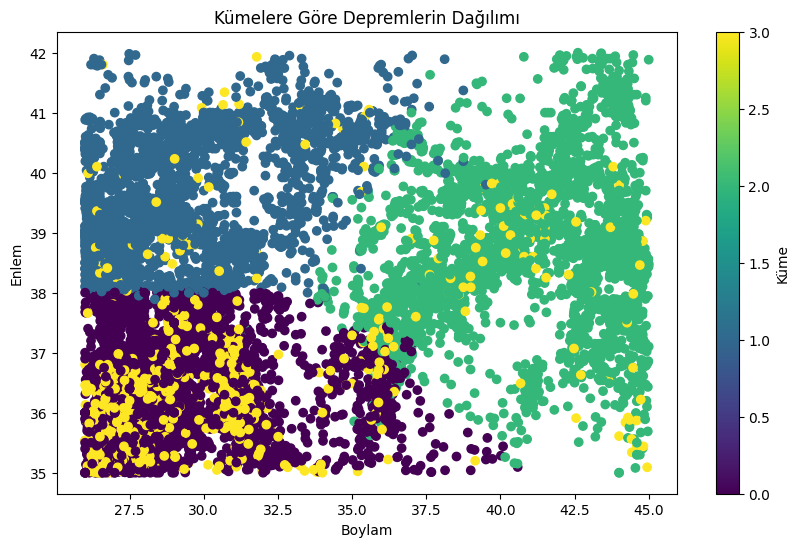

In [39]:
# K-means kümeleme uygula
from sklearn.cluster import KMeans
from sklearn.preprocessing import StandardScaler

# Kümeleme için kullanılacak özellikleri seç ve eksik değerleri temizle
features = df[['Enlem', 'Boylam', 'Derinlik', 'Mw']].dropna()

# Verileri ölçeklendir
scaler = StandardScaler()
features_scaled = scaler.fit_transform(features)

# K-means modelini oluştur ve uygula
kmeans = KMeans(n_clusters=4, random_state=42)
cluster_labels = kmeans.fit_predict(features_scaled)

# Küme etiketlerini orijinal veriye ekle
features['Cluster'] = cluster_labels

# Kümelerin özelliklerini incele
print("Her kümedeki deprem sayısı:")
print(features['Cluster'].value_counts())

print("\nKümelere göre ortalama değerler:")
cluster_analysis = features.groupby('Cluster')[['Enlem', 'Boylam', 'Derinlik', 'Mw']].mean()
print(cluster_analysis)

# Görselleştirme
plt.figure(figsize=(10, 6))
plt.scatter(features['Boylam'], features['Enlem'], c=features['Cluster'], cmap='viridis')
plt.colorbar(label='Küme')
plt.xlabel('Boylam')
plt.ylabel('Enlem')
plt.title('Kümelere Göre Depremlerin Dağılımı')
plt.show()

## Vısualization

<Figure size 1200x800 with 0 Axes>

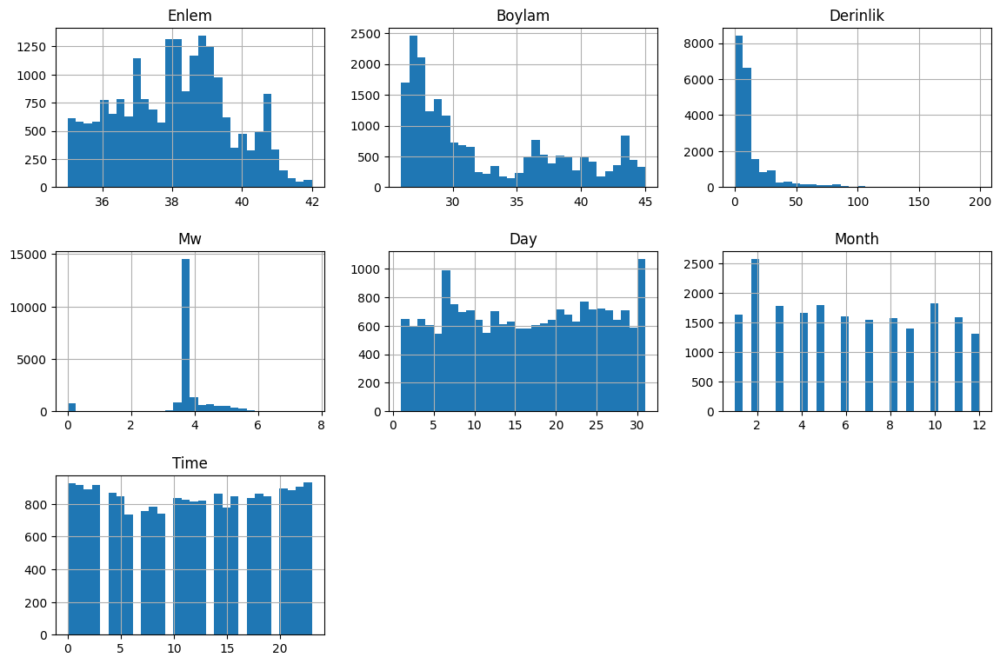

In [40]:
numeric_cols = df.select_dtypes(include=['float64', 'int64']).columns
numeric_cols = [col for col in numeric_cols if col != 'Cluster']

plt.figure(figsize=(12, 8))
df[['Enlem', 'Boylam', 'Derinlik', 'Mw', 'Day', 'Month', 'Time']].hist(figsize=(12, 8), bins=30, layout=(3,3))
plt.tight_layout(pad=2.0)  # Grafikler arası boşluk ekle
plt.show()


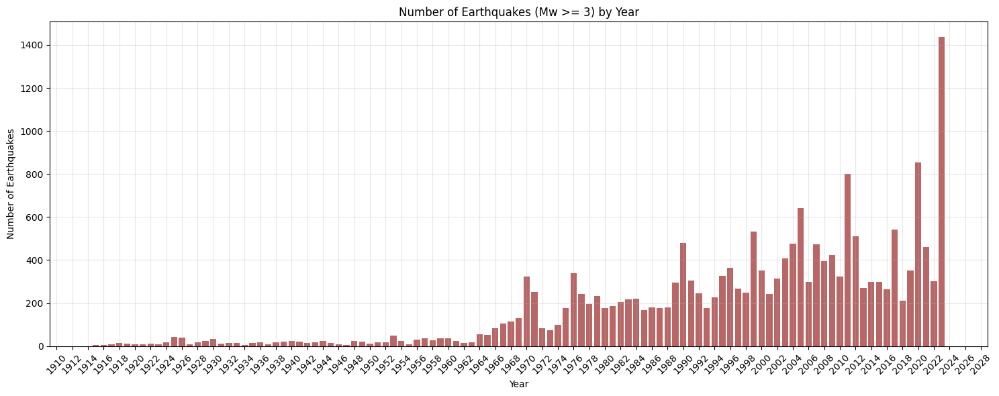

In [41]:
df['Year'] = pd.to_datetime(df['Olus tarihi']).dt.year
major_eq = df[df['Mw'] >= 3]
yearly_counts = major_eq.groupby('Year').size()
all_years = pd.Series(0, index=range(df['Year'].min(), 2024))
yearly_counts = all_years.add(yearly_counts, fill_value=0)

plt.figure(figsize=(15, 6))
plt.bar(yearly_counts.index, yearly_counts.values, color='darkred', alpha=0.6)
plt.title('Number of Earthquakes (Mw >= 3) by Year', fontsize=12)
plt.xlabel('Year', fontsize=10)
plt.ylabel('Number of Earthquakes', fontsize=10)
plt.grid(True, alpha=0.3)
plt.gca().xaxis.set_major_locator(plt.MultipleLocator(2))
plt.xticks(rotation=45)
plt.tight_layout()
plt.show()

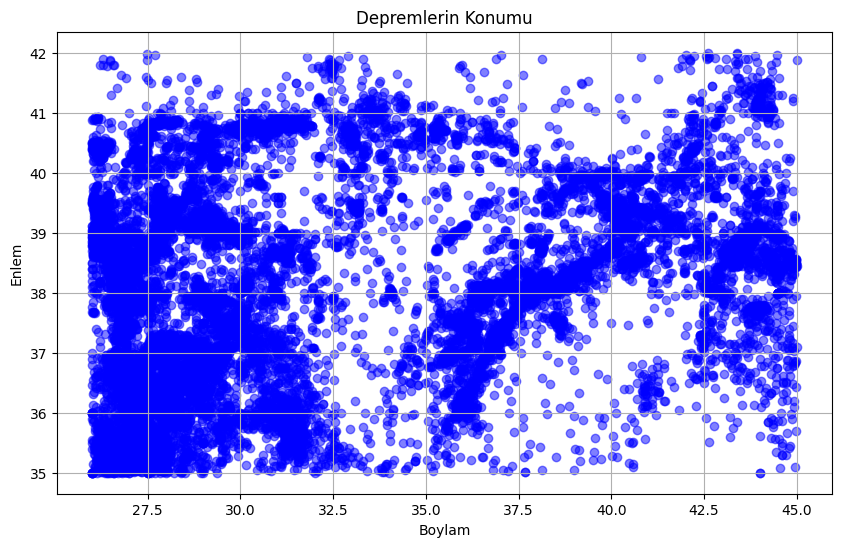

In [42]:
enlem = df['Enlem']
boylam = df['Boylam']

plt.figure(figsize=(10, 6))
plt.scatter(boylam, enlem, color='blue', alpha=0.5)
plt.title('Depremlerin Konumu')
plt.xlabel('Boylam')
plt.ylabel('Enlem')
plt.grid(True)
plt.show()

0-3       698
3-4     16005
4-5      2731
5-6       793
6-7        72
7-8         8
8-9         0
9-10        0
Name: Magnitude Range, dtype: int64


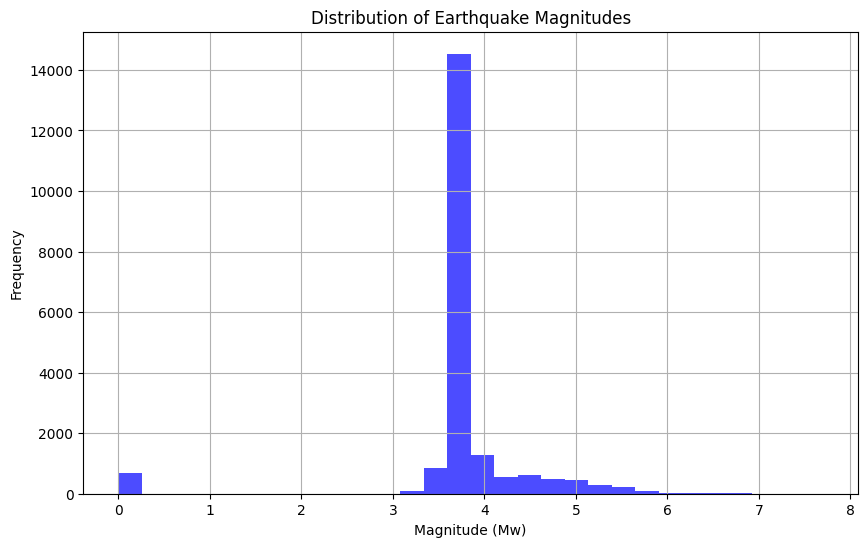

In [43]:
# Define magnitude bins
bins = [0, 3, 4, 5, 6, 7, 8, 9, 10]
labels = ['0-3', '3-4', '4-5', '5-6', '6-7', '7-8', '8-9', '9-10']

# Create a new column for binned magnitudes
df['Magnitude Range'] = pd.cut(df['Mw'], bins=bins, labels=labels, right=False)

# Count the number of earthquakes in each magnitude range
magnitude_counts = df['Magnitude Range'].value_counts().sort_index()

# Display the counts
print(magnitude_counts)

# Histogram of earthquake magnitudes
plt.figure(figsize=(10, 6))
plt.hist(df['Mw'].dropna(), bins=30, color='blue', alpha=0.7)
plt.title('Distribution of Earthquake Magnitudes')
plt.xlabel('Magnitude (Mw)')
plt.ylabel('Frequency')
plt.grid(True)
plt.show()

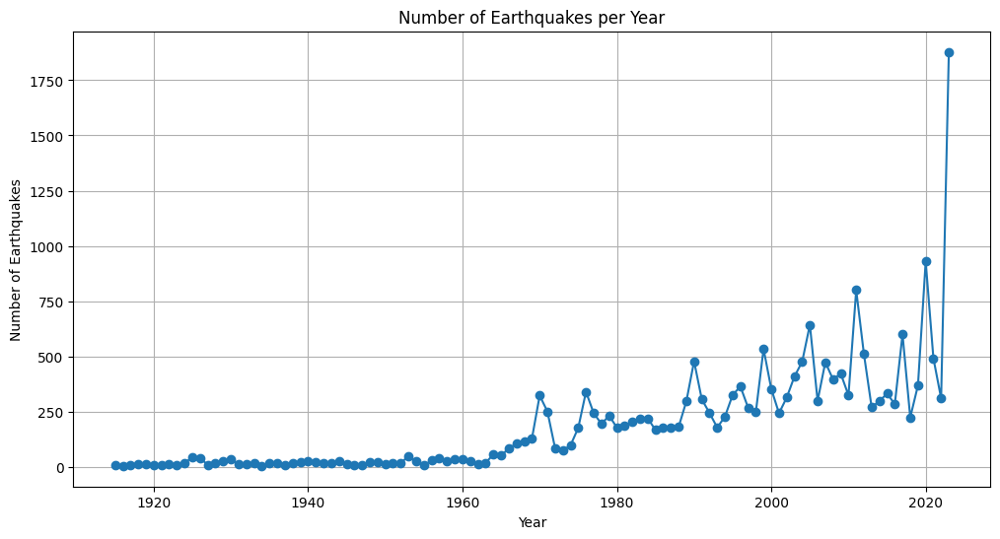

In [44]:
# Time Series Plot of Earthquake Counts by Year
df['Year'] = df['Year'].astype(int)
yearly_counts = df['Year'].value_counts().sort_index()

plt.figure(figsize=(12, 6))
plt.plot(yearly_counts.index, yearly_counts.values, marker='o', linestyle='-')
plt.title('Number of Earthquakes per Year')
plt.xlabel('Year')
plt.ylabel('Number of Earthquakes')
plt.grid(True)
plt.show()

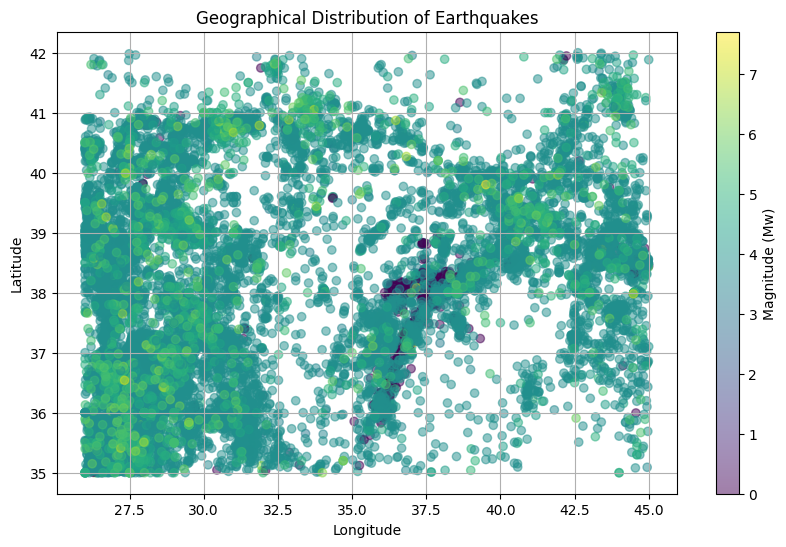

In [45]:
# Scatter Plot of Earthquake Locations
plt.figure(figsize=(10, 6))
plt.scatter(df['Boylam'], df['Enlem'], c=df['Mw'], cmap='viridis', alpha=0.5)
plt.colorbar(label='Magnitude (Mw)')
plt.title('Geographical Distribution of Earthquakes')
plt.xlabel('Longitude')
plt.ylabel('Latitude')
plt.grid(True)
plt.show()

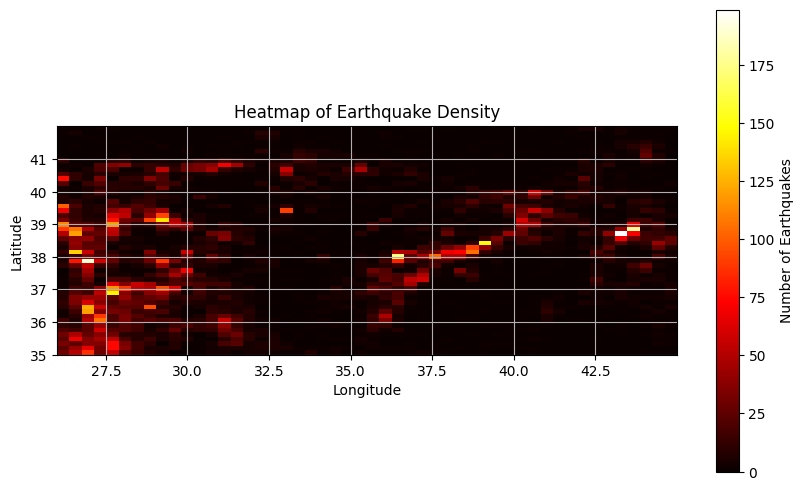

In [46]:
# Heatmap of Earthquake Density

plt.figure(figsize=(10, 6))
heatmap, xedges, yedges = np.histogram2d(df['Boylam'], df['Enlem'], bins=(50, 50))
plt.imshow(heatmap.T, origin='lower', cmap='hot', extent=[df['Boylam'].min(), df['Boylam'].max(), df['Enlem'].min(), df['Enlem'].max()])
plt.colorbar(label='Number of Earthquakes')
plt.title('Heatmap of Earthquake Density')
plt.xlabel('Longitude')
plt.ylabel('Latitude')
plt.grid(True)
plt.show()

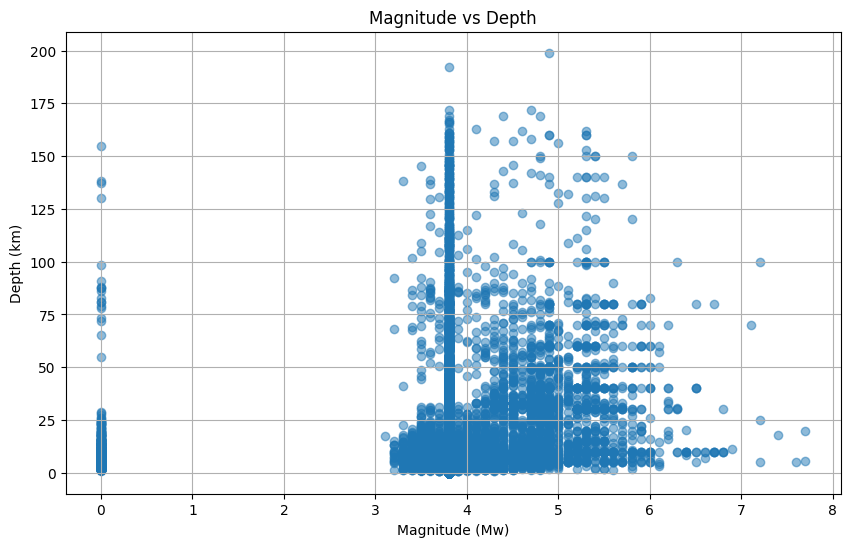

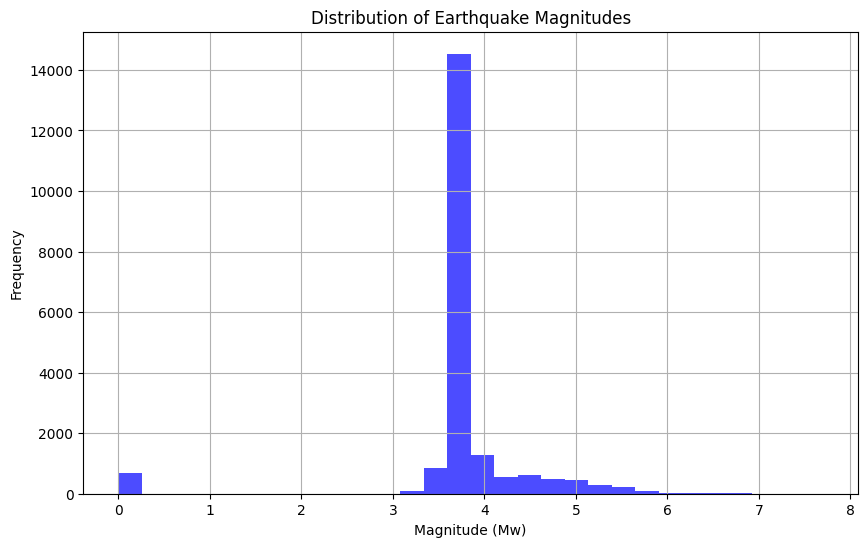

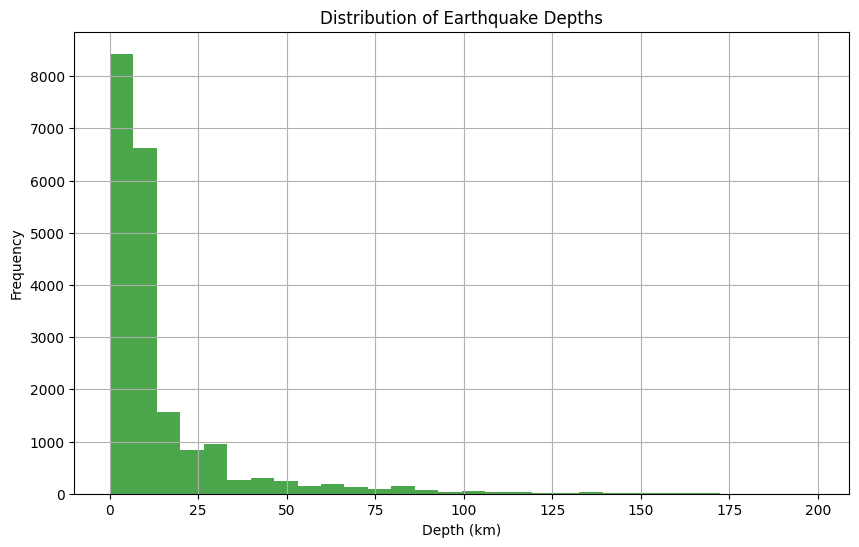

In [47]:
# Scatter plot of magnitude vs depth
plt.figure(figsize=(10, 6))
plt.scatter(df['Mw'], df['Derinlik'], alpha=0.5)
plt.title('Magnitude vs Depth')
plt.xlabel('Magnitude (Mw)')
plt.ylabel('Depth (km)')
plt.grid(True)
plt.show()

# Histogram of magnitudes
plt.figure(figsize=(10, 6))
plt.hist(df['Mw'].dropna(), bins=30, color='blue', alpha=0.7)
plt.title('Distribution of Earthquake Magnitudes')
plt.xlabel('Magnitude (Mw)')
plt.ylabel('Frequency')
plt.grid(True)
plt.show()

# Histogram of depths
plt.figure(figsize=(10, 6))
plt.hist(df['Derinlik'].dropna(), bins=30, color='green', alpha=0.7)
plt.title('Distribution of Earthquake Depths')
plt.xlabel('Depth (km)')
plt.ylabel('Frequency')
plt.grid(True)
plt.show()

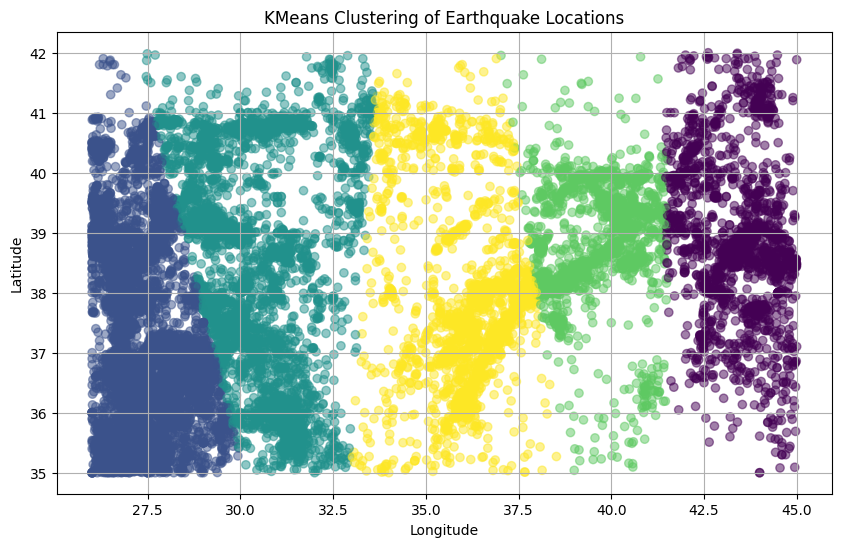

In [48]:
from sklearn.cluster import KMeans

# Prepare data for clustering
X = df[['Boylam', 'Enlem']].dropna()

# Perform KMeans clustering
kmeans = KMeans(n_clusters=5, random_state=0).fit(X)
df['Cluster'] = kmeans.labels_

# Plot clusters
plt.figure(figsize=(10, 6))
plt.scatter(df['Boylam'], df['Enlem'], c=df['Cluster'], cmap='viridis', alpha=0.5)
plt.title('KMeans Clustering of Earthquake Locations')
plt.xlabel('Longitude')
plt.ylabel('Latitude')
plt.grid(True)
plt.show()

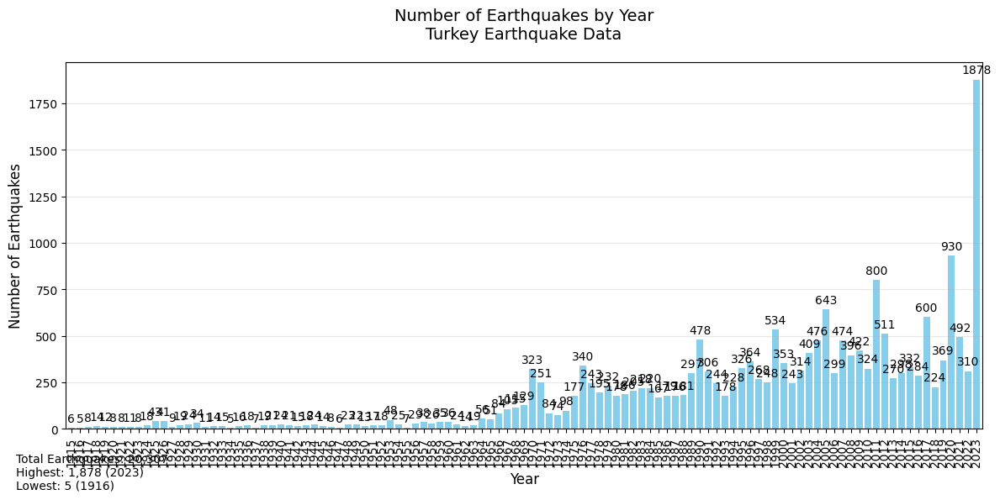

In [49]:
# Annual Earthquake Count Graph
plt.figure(figsize=(12, 6))
yearly_counts = df.groupby('Year').size()

ax = yearly_counts.plot(kind='bar', color='skyblue', width=0.8)
plt.title('Number of Earthquakes by Year\nTurkey Earthquake Data', pad=20, fontsize=14)
plt.xlabel('Year', fontsize=12)
plt.ylabel('Number of Earthquakes', fontsize=12)

# Add value labels on top of bars with offset
for i, v in enumerate(yearly_counts):
    ax.text(i, v + (yearly_counts.max() * 0.01), # Add small offset
            str(v), 
            ha='center',
            va='bottom',
            rotation=0)

plt.grid(True, alpha=0.3, axis='y')
plt.xticks(rotation=90) # Rotate labels 90 degrees
plt.subplots_adjust(bottom=0.2) # Adjust bottom margin

# Summary text
plt.figtext(0.02, 0.02,
            f"Total Earthquakes: {yearly_counts.sum():,}\n"
            f"Highest: {yearly_counts.max():,} ({yearly_counts.idxmax()})\n"
            f"Lowest: {yearly_counts.min():,} ({yearly_counts.idxmin()})",
            fontsize=10)

plt.tight_layout()
plt.show()



In [50]:
# Detaylı yıllık istatistikler
print("\nDETAYLI YILLIK DEPREM İSTATİSTİKLERİ")
print("=====================================")

# 1. Temel İstatistikler
print("\n1. TEMEL İSTATİSTİKLER:")
print(f"Toplam Deprem Sayısı: {yearly_counts.sum():,}")
print(f"Ortalama Yıllık Deprem Sayısı: {yearly_counts.mean():.0f}")
print(f"Medyan Yıllık Deprem Sayısı: {yearly_counts.median():.0f}")
print(f"Standart Sapma: {yearly_counts.std():.2f}")

# 2. Rekor Değerler
print("\n2. REKOR DEĞERLER:")
print(f"En Yüksek Deprem Sayısı: {yearly_counts.max():,} ({yearly_counts.idxmax()})")
print(f"En Düşük Deprem Sayısı: {yearly_counts.min():,} ({yearly_counts.idxmin()})")

# 3. Persentil Analizi
print("\n3. PERSENTİL ANALİZİ:")
print(f"25. Persentil: {yearly_counts.quantile(0.25):.0f} deprem/yıl")
print(f"50. Persentil (Medyan): {yearly_counts.quantile(0.50):.0f} deprem/yıl")
print(f"75. Persentil: {yearly_counts.quantile(0.75):.0f} deprem/yıl")

# 4. Yıllık Değişim Analizi
yearly_change = yearly_counts.pct_change() * 100
print("\n4. YILLIK DEĞİŞİM ANALİZİ:")
print(f"En Büyük Artış: %{yearly_change.max():.1f} ({yearly_change.idxmax()})")
print(f"En Büyük Azalış: %{yearly_change.min():.1f} ({yearly_change.idxmin()})")
print(f"Ortalama Yıllık Değişim: %{yearly_change.mean():.1f}")



DETAYLI YILLIK DEPREM İSTATİSTİKLERİ

1. TEMEL İSTATİSTİKLER:
Toplam Deprem Sayısı: 20,307
Ortalama Yıllık Deprem Sayısı: 186
Medyan Yıllık Deprem Sayısı: 98
Standart Sapma: 248.93

2. REKOR DEĞERLER:
En Yüksek Deprem Sayısı: 1,878 (2023)
En Düşük Deprem Sayısı: 5 (1916)

3. PERSENTİL ANALİZİ:
25. Persentil: 18 deprem/yıl
50. Persentil (Medyan): 98 deprem/yıl
75. Persentil: 297 deprem/yıl

4. YILLIK DEĞİŞİM ANALİZİ:
En Büyük Artış: %505.8 (2023)
En Büyük Azalış: %-78.0 (1927)
Ortalama Yıllık Değişim: %25.3


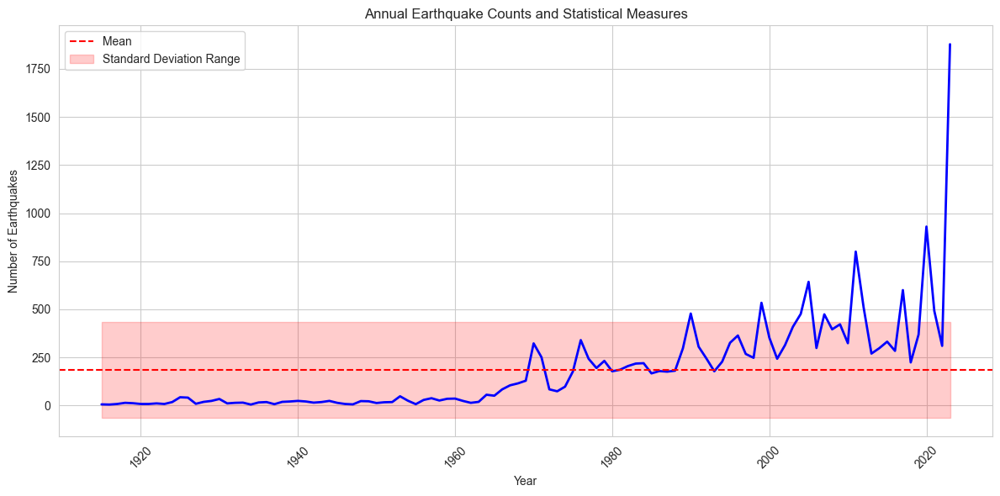

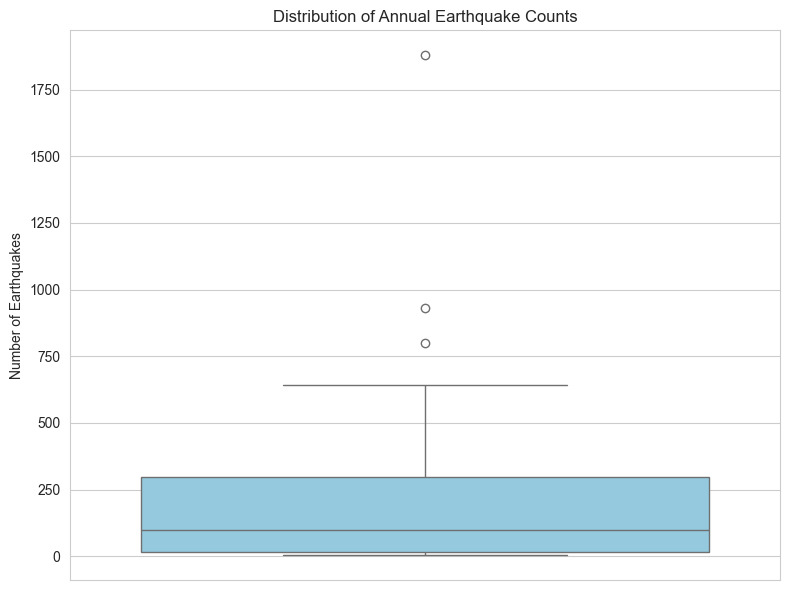

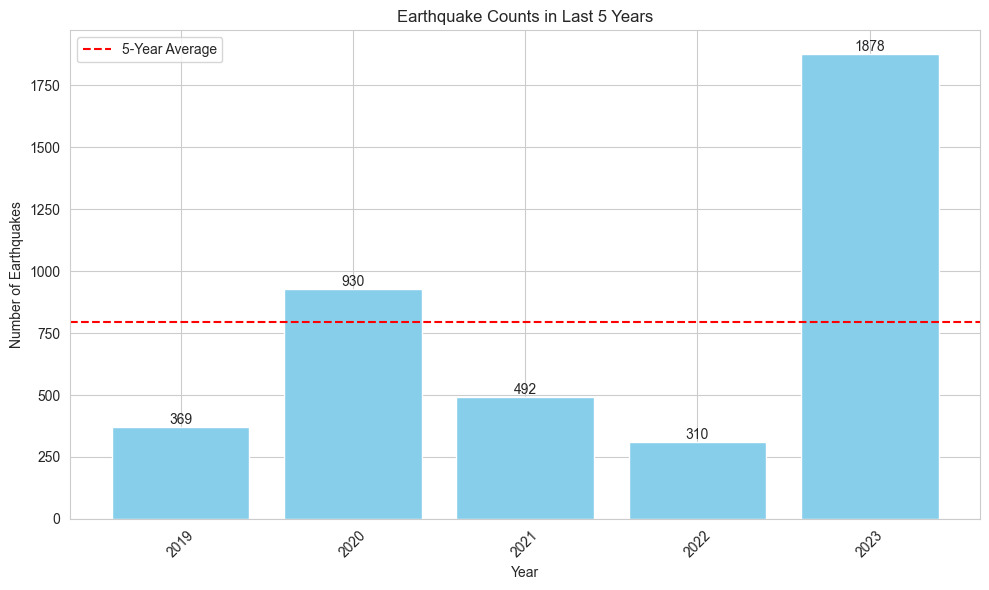

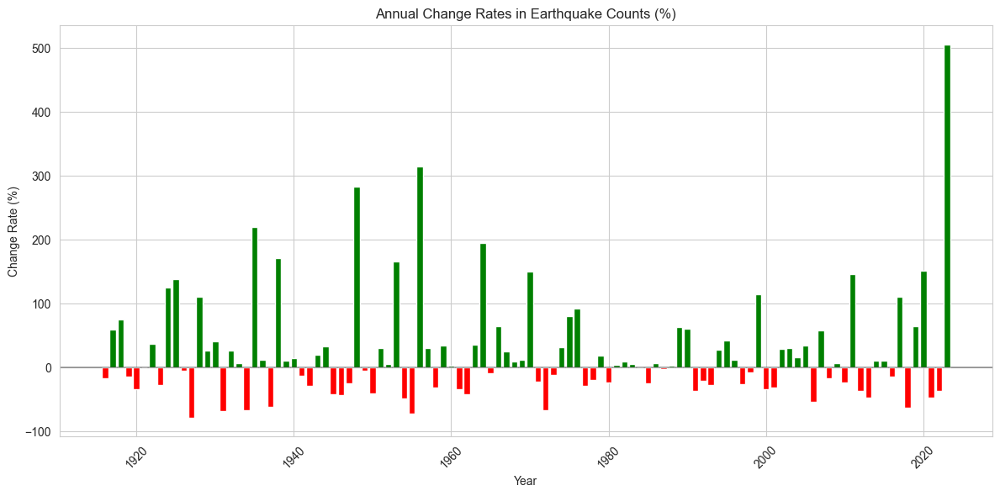

In [51]:
import matplotlib.pyplot as plt
import seaborn as sns

# Set the style
plt.style.use('default')
sns.set_style("whitegrid")

# 1. Annual Trend and Statistical Measures
plt.figure(figsize=(12, 6))
plt.plot(yearly_counts.index, yearly_counts.values, 'b-', linewidth=2)
plt.axhline(y=yearly_counts.mean(), color='r', linestyle='--', label='Mean')
plt.fill_between(yearly_counts.index, 
                 yearly_counts.mean() - yearly_counts.std(),
                 yearly_counts.mean() + yearly_counts.std(), 
                 alpha=0.2, color='r', label='Standard Deviation Range')

plt.title('Annual Earthquake Counts and Statistical Measures')
plt.xlabel('Year')
plt.ylabel('Number of Earthquakes')
plt.legend()
plt.xticks(rotation=45)
plt.tight_layout()
plt.show()

# 2. Box Plot Distribution
plt.figure(figsize=(8, 6))
sns.boxplot(y=yearly_counts.values, color='skyblue')
plt.title('Distribution of Annual Earthquake Counts')
plt.ylabel('Number of Earthquakes')
plt.tight_layout()
plt.show()

# 3. Last 5 Years Comparison
recent_years = yearly_counts.tail(5)
plt.figure(figsize=(10, 6))
bars = plt.bar(recent_years.index, recent_years.values, color='skyblue')
plt.axhline(y=recent_years.mean(), color='r', linestyle='--', label='5-Year Average')
plt.title('Earthquake Counts in Last 5 Years')
plt.xlabel('Year')
plt.ylabel('Number of Earthquakes')
plt.legend()

# Add value labels on bars
for bar in bars:
    height = bar.get_height()
    plt.text(bar.get_x() + bar.get_width()/2., height,
             f'{int(height)}',
             ha='center', va='bottom')

plt.xticks(rotation=45)
plt.tight_layout()
plt.show()

# 4. Annual Change Rates
yearly_change = yearly_counts.pct_change() * 100
plt.figure(figsize=(12, 6))
colors = ['green' if x > 0 else 'red' for x in yearly_change]
plt.bar(yearly_change.index, yearly_change.values, color=colors)
plt.title('Annual Change Rates in Earthquake Counts (%)')
plt.xlabel('Year')
plt.ylabel('Change Rate (%)')
plt.axhline(y=0, color='black', linestyle='-', alpha=0.3)
plt.xticks(rotation=45)
plt.tight_layout()
plt.show()

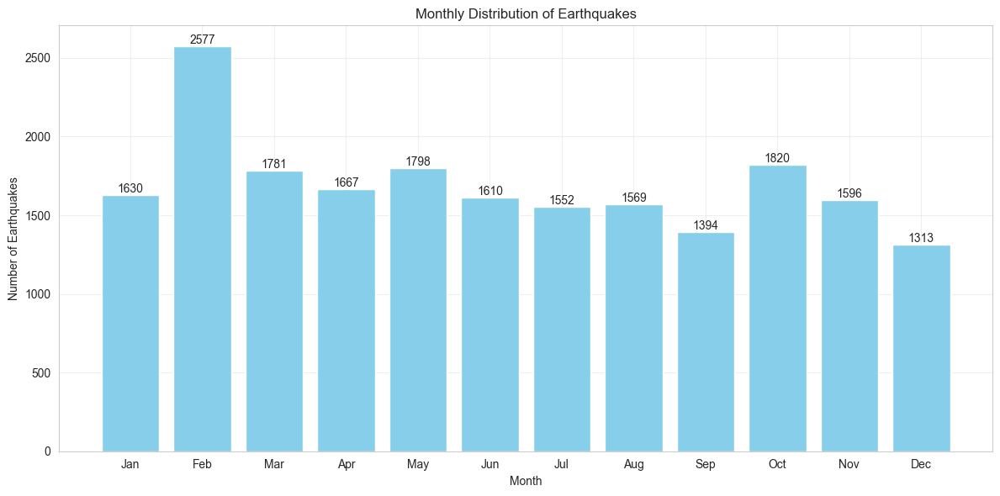


Monthly Earthquake Statistics:
Month with most earthquakes: 2 (2577 earthquakes)
Month with least earthquakes: 12 (1313 earthquakes)
Average monthly earthquakes: 1692.25
Standard deviation: 317.14


In [52]:
# Monthly analysis with detailed statistics
df['Month'] = pd.to_datetime(df['Olus tarihi']).dt.month
monthly_counts = df.groupby('Month').size()

# Plotting
plt.figure(figsize=(12, 6))
bars = plt.bar(monthly_counts.index, monthly_counts.values, color='skyblue')
plt.title('Monthly Distribution of Earthquakes')
plt.xlabel('Month')
plt.ylabel('Number of Earthquakes')

# Add value labels
for bar in bars:
    height = bar.get_height()
    plt.text(bar.get_x() + bar.get_width()/2., height,
             f'{int(height)}',
             ha='center', va='bottom')

plt.xticks(range(1, 13), ['Jan', 'Feb', 'Mar', 'Apr', 'May', 'Jun', 
                          'Jul', 'Aug', 'Sep', 'Oct', 'Nov', 'Dec'])
plt.grid(True, alpha=0.3)
plt.tight_layout()
plt.show()

# Print monthly statistics
print("\nMonthly Earthquake Statistics:")
print("==============================")
print(f"Month with most earthquakes: {monthly_counts.idxmax()} ({monthly_counts.max()} earthquakes)")
print(f"Month with least earthquakes: {monthly_counts.idxmin()} ({monthly_counts.min()} earthquakes)")
print(f"Average monthly earthquakes: {monthly_counts.mean():.2f}")
print(f"Standard deviation: {monthly_counts.std():.2f}")

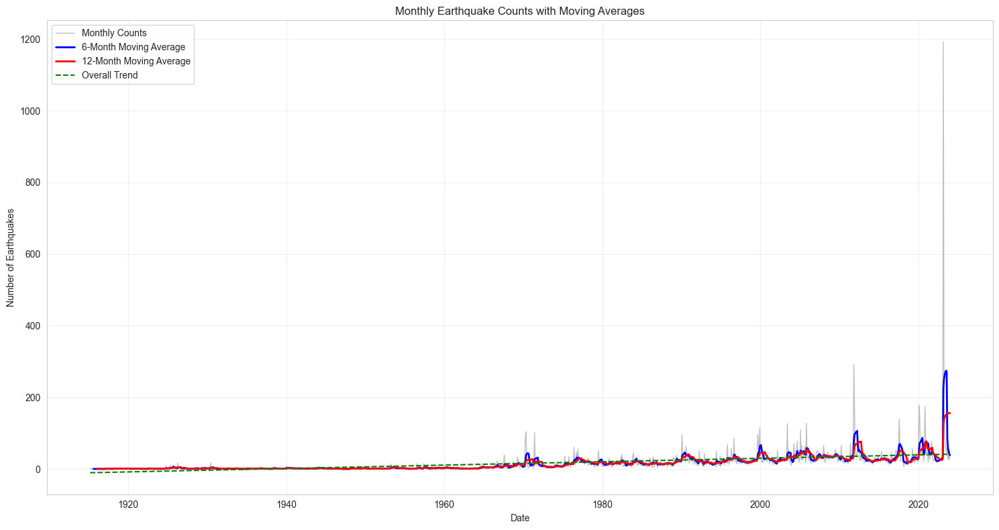


Moving Average Analysis:
Average number of earthquakes per month: 15.54
Maximum monthly count: 1192 (2023-02)
Minimum monthly count: 0 (1915-03)

Trend Analysis:
Overall trend change: -502.7%


In [53]:
# Create monthly time series
monthly_time_series = df.groupby(pd.Grouper(key='Olus tarihi', freq='M')).size()

# Calculate different moving averages
ma_6 = monthly_time_series.rolling(window=6).mean()
ma_12 = monthly_time_series.rolling(window=12).mean()

# Plotting
plt.figure(figsize=(15, 8))
plt.plot(monthly_time_series.index, monthly_time_series.values, 
         label='Monthly Counts', alpha=0.5, color='gray', linewidth=1)
plt.plot(monthly_time_series.index, ma_6, 
         label='6-Month Moving Average', linewidth=2, color='blue')
plt.plot(monthly_time_series.index, ma_12, 
         label='12-Month Moving Average', linewidth=2, color='red')

plt.title('Monthly Earthquake Counts with Moving Averages')
plt.xlabel('Date')
plt.ylabel('Number of Earthquakes')
plt.legend()
plt.grid(True, alpha=0.3)

# Add trend analysis
z = np.polyfit(range(len(monthly_time_series)), monthly_time_series.values, 1)
p = np.poly1d(z)
plt.plot(monthly_time_series.index, p(range(len(monthly_time_series))), 
         "--", color='green', label='Overall Trend')

plt.legend()
plt.tight_layout()
plt.show()

# Print statistics
print("\nMoving Average Analysis:")
print("=======================")
print(f"Average number of earthquakes per month: {monthly_time_series.mean():.2f}")
print(f"Maximum monthly count: {monthly_time_series.max()} ({monthly_time_series.idxmax().strftime('%Y-%m')})")
print(f"Minimum monthly count: {monthly_time_series.min()} ({monthly_time_series.idxmin().strftime('%Y-%m')})")

# Calculate trend
start_value = p(0)
end_value = p(len(monthly_time_series))
trend_change = ((end_value - start_value) / start_value) * 100

print(f"\nTrend Analysis:")
print(f"Overall trend change: {trend_change:.1f}%")

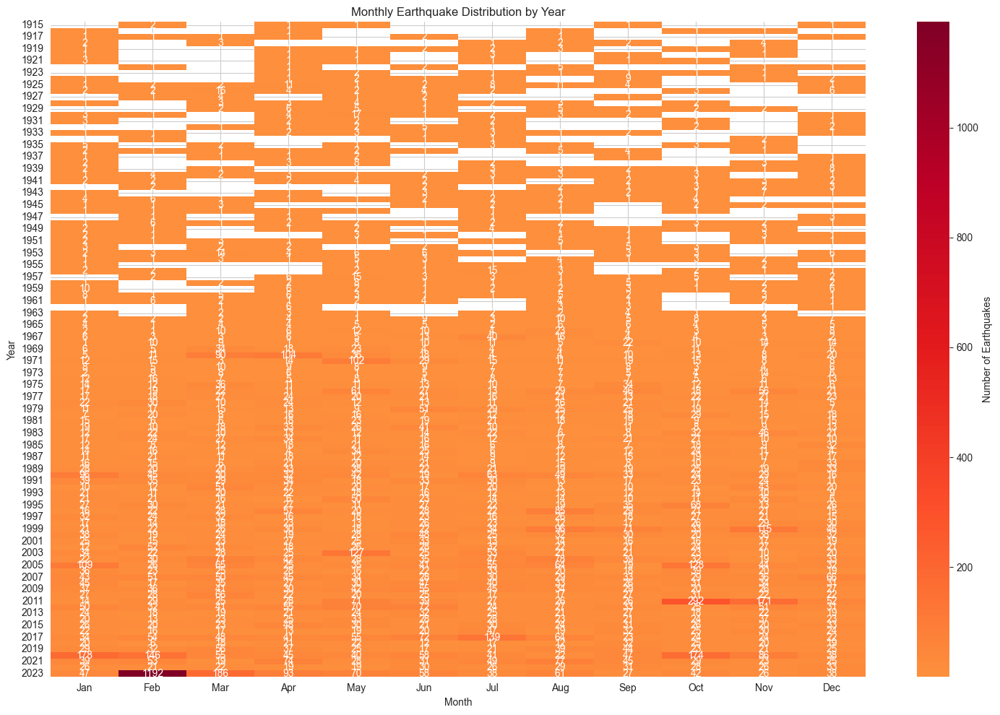


Monthly Distribution Analysis:
Average earthquakes per month: 18.4
Maximum monthly count: 1192.0 (Year: Feb)

Monthly Averages:
Jan    16.6
Feb    29.6
Mar    20.7
Apr    16.8
May    18.5
Jun    17.5
Jul    16.3
Aug    16.5
Sep    15.2
Oct    20.7
Nov    17.9
Dec    14.4
dtype: float64

Yearly Averages:
Year
1915      1.2
1916      1.0
1917      1.1
1918      2.3
1919      1.5
        ...  
2019     30.8
2020     77.5
2021     41.0
2022     25.8
2023    156.5
Length: 109, dtype: float64

Months with Unusually High Activity (>2 std from mean):
Mar 1970: 90 earthquakes
Apr 1970: 104 earthquakes
May 1971: 102 earthquakes
Jan 1990: 96 earthquakes
Aug 1996: 85 earthquakes
Aug 1999: 96 earthquakes
Nov 1999: 115 earthquakes
May 2003: 127 earthquakes
Jan 2005: 109 earthquakes
Oct 2005: 128 earthquakes
Oct 2011: 292 earthquakes
Nov 2011: 171 earthquakes
Jul 2017: 139 earthquakes
Jan 2020: 178 earthquakes
Feb 2020: 146 earthquakes
Oct 2020: 174 earthquakes
Nov 2020: 86 earthquakes
Feb 2023: 119

In [54]:
# Create month-year matrix for heatmap
df['Year'] = pd.to_datetime(df['Olus tarihi']).dt.year
df['Month'] = pd.to_datetime(df['Olus tarihi']).dt.month
monthly_matrix = df.groupby(['Year', 'Month']).size().unstack()

# Rename months for better visualization
month_names = ['Jan', 'Feb', 'Mar', 'Apr', 'May', 'Jun', 
               'Jul', 'Aug', 'Sep', 'Oct', 'Nov', 'Dec']
monthly_matrix.columns = month_names

# Create heatmap
plt.figure(figsize=(15, 10))
sns.heatmap(monthly_matrix, 
            cmap='YlOrRd',
            annot=True,           # Show numbers in cells
            fmt='g',              # Format as integer
            cbar_kws={'label': 'Number of Earthquakes'},
            center=monthly_matrix.mean().mean())  # Center colormap around mean

plt.title('Monthly Earthquake Distribution by Year')
plt.xlabel('Month')
plt.ylabel('Year')
plt.tight_layout()
plt.show()

# Print statistical analysis
print("\nMonthly Distribution Analysis:")
print("=============================")
print(f"Average earthquakes per month: {monthly_matrix.mean().mean():.1f}")
print(f"Maximum monthly count: {monthly_matrix.max().max()} (Year: {monthly_matrix.max().idxmax()})")
print("\nMonthly Averages:")
print(monthly_matrix.mean().round(1))
print("\nYearly Averages:")
print(monthly_matrix.mean(axis=1).round(1))

# Find months with unusually high activity
threshold = monthly_matrix.mean().mean() + 2*monthly_matrix.std().std()
high_activity = monthly_matrix.stack()
high_activity = high_activity[high_activity > threshold]
print("\nMonths with Unusually High Activity (>2 std from mean):")
for (year, month), count in high_activity.items():
    print(f"{month} {year}: {int(count)} earthquakes")

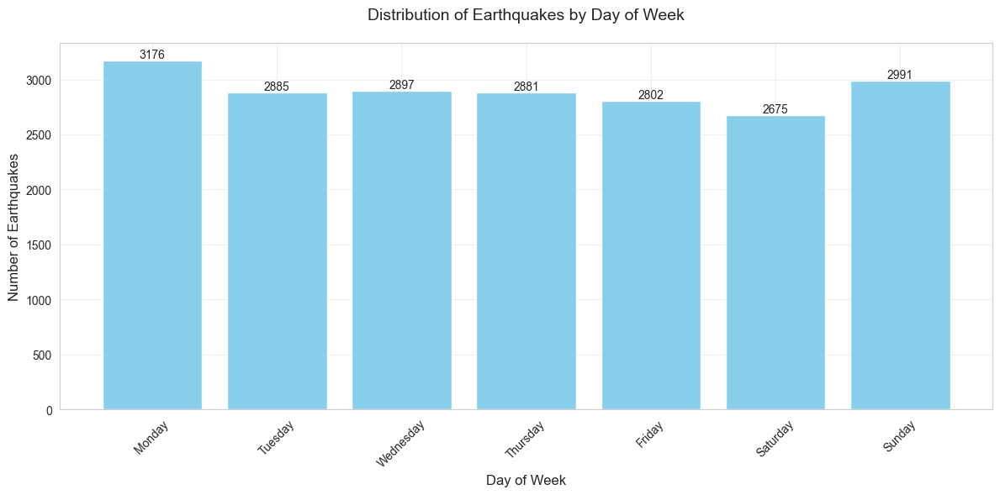


Daily Distribution Analysis:

Total number of earthquakes: 20307
Average earthquakes per day: 2901.00

Most active day: Monday (3176 earthquakes)
Least active day: Saturday (2675 earthquakes)

Variation from average (%):
Monday: +9.48%
Tuesday: -0.55%
Wednesday: -0.14%
Thursday: -0.69%
Friday: -3.41%
Saturday: -7.79%
Sunday: +3.10%

Basic Statistics:
count       7.0
mean     2901.0
std       155.6
min      2675.0
25%      2841.5
50%      2885.0
75%      2944.0
max      3176.0
dtype: float64

Weekday vs Weekend Comparison:
Weekday average: 2928.20 earthquakes per day
Weekend average: 2833.00 earthquakes per day
Difference: -3.25% more/less on weekends


In [55]:
# Günlük dağılım analizi
df['DayOfWeek'] = pd.to_datetime(df['Olus tarihi']).dt.day_name()

# 1. Haftanın Günlerine Göre Dağılım
plt.figure(figsize=(12, 6))
day_order = ['Monday', 'Tuesday', 'Wednesday', 'Thursday', 'Friday', 'Saturday', 'Sunday']
daily_counts = df.groupby('DayOfWeek').size().reindex(day_order)

# Çubuk grafiği
bars = plt.bar(daily_counts.index, daily_counts.values, color='skyblue')
plt.title('Distribution of Earthquakes by Day of Week', pad=20, fontsize=14)
plt.xlabel('Day of Week', fontsize=12)
plt.ylabel('Number of Earthquakes', fontsize=12)

# Değerleri çubukların üzerine ekleme
for bar in bars:
    height = bar.get_height()
    plt.text(bar.get_x() + bar.get_width()/2., height,
             f'{int(height)}',
             ha='center', va='bottom')

plt.grid(True, alpha=0.3)
plt.xticks(rotation=45)
plt.tight_layout()
plt.show()

# Detaylı istatistiksel analiz
print("\nDaily Distribution Analysis:")
print("==========================")
print(f"\nTotal number of earthquakes: {daily_counts.sum()}")
print(f"Average earthquakes per day: {daily_counts.mean():.2f}")
print(f"\nMost active day: {daily_counts.idxmax()} ({daily_counts.max()} earthquakes)")
print(f"Least active day: {daily_counts.idxmin()} ({daily_counts.min()} earthquakes)")

# Günlük varyasyon analizi
daily_variation = ((daily_counts - daily_counts.mean()) / daily_counts.mean() * 100).round(2)
print("\nVariation from average (%):")
for day in day_order:
    print(f"{day}: {daily_variation[day]:+.2f}%")

# Temel istatistikler
print("\nBasic Statistics:")
print(daily_counts.describe().round(2))

# Hafta içi vs Hafta sonu karşılaştırması
weekday_avg = daily_counts[['Monday', 'Tuesday', 'Wednesday', 'Thursday', 'Friday']].mean()
weekend_avg = daily_counts[['Saturday', 'Sunday']].mean()

print("\nWeekday vs Weekend Comparison:")
print(f"Weekday average: {weekday_avg:.2f} earthquakes per day")
print(f"Weekend average: {weekend_avg:.2f} earthquakes per day")
print(f"Difference: {((weekend_avg - weekday_avg) / weekday_avg * 100):.2f}% more/less on weekends")

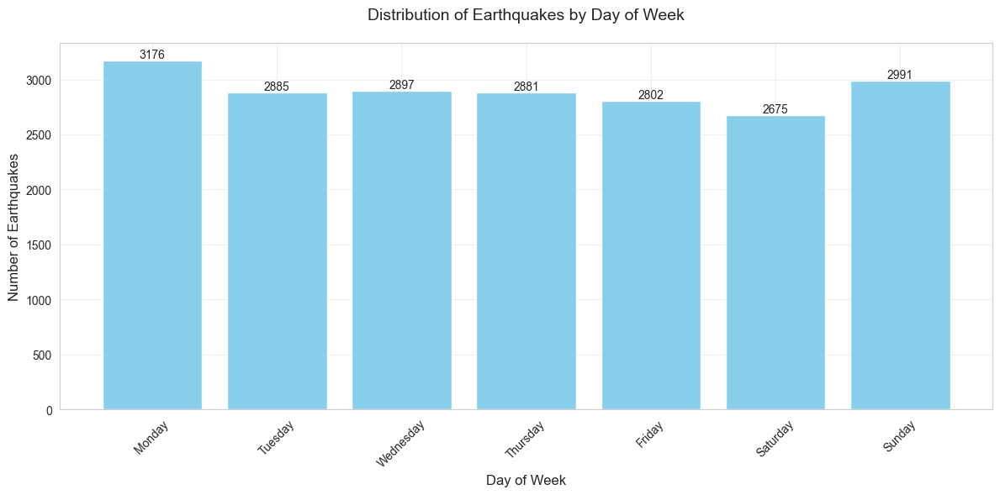


Daily Distribution Analysis:

Total number of earthquakes: 20307
Average earthquakes per day: 2901.00

Most active day: Monday (3176 earthquakes)
Least active day: Saturday (2675 earthquakes)

Variation from average (%):
Monday: +9.48%
Tuesday: -0.55%
Wednesday: -0.14%
Thursday: -0.69%
Friday: -3.41%
Saturday: -7.79%
Sunday: +3.10%

Basic Statistics:
count       7.0
mean     2901.0
std       155.6
min      2675.0
25%      2841.5
50%      2885.0
75%      2944.0
max      3176.0
dtype: float64

Weekday vs Weekend Comparison:
Weekday average: 2928.20 earthquakes per day
Weekend average: 2833.00 earthquakes per day
Difference: -3.25% more/less on weekends


In [56]:
# Günlük dağılım analizi
df['DayOfWeek'] = pd.to_datetime(df['Olus tarihi']).dt.day_name()

# 1. Haftanın Günlerine Göre Dağılım
plt.figure(figsize=(12, 6))
day_order = ['Monday', 'Tuesday', 'Wednesday', 'Thursday', 'Friday', 'Saturday', 'Sunday']
daily_counts = df.groupby('DayOfWeek').size().reindex(day_order)

# Çubuk grafiği
bars = plt.bar(daily_counts.index, daily_counts.values, color='skyblue')
plt.title('Distribution of Earthquakes by Day of Week', pad=20, fontsize=14)
plt.xlabel('Day of Week', fontsize=12)
plt.ylabel('Number of Earthquakes', fontsize=12)

# Değerleri çubukların üzerine ekleme
for bar in bars:
    height = bar.get_height()
    plt.text(bar.get_x() + bar.get_width()/2., height,
             f'{int(height)}',
             ha='center', va='bottom')

plt.grid(True, alpha=0.3)
plt.xticks(rotation=45)
plt.tight_layout()
plt.show()

# Detaylı istatistiksel analiz
print("\nDaily Distribution Analysis:")
print("==========================")
print(f"\nTotal number of earthquakes: {daily_counts.sum()}")
print(f"Average earthquakes per day: {daily_counts.mean():.2f}")
print(f"\nMost active day: {daily_counts.idxmax()} ({daily_counts.max()} earthquakes)")
print(f"Least active day: {daily_counts.idxmin()} ({daily_counts.min()} earthquakes)")

# Günlük varyasyon analizi
daily_variation = ((daily_counts - daily_counts.mean()) / daily_counts.mean() * 100).round(2)
print("\nVariation from average (%):")
for day in day_order:
    print(f"{day}: {daily_variation[day]:+.2f}%")

# Temel istatistikler
print("\nBasic Statistics:")
print(daily_counts.describe().round(2))

# Hafta içi vs Hafta sonu karşılaştırması
weekday_avg = daily_counts[['Monday', 'Tuesday', 'Wednesday', 'Thursday', 'Friday']].mean()
weekend_avg = daily_counts[['Saturday', 'Sunday']].mean()

print("\nWeekday vs Weekend Comparison:")
print(f"Weekday average: {weekday_avg:.2f} earthquakes per day")
print(f"Weekend average: {weekend_avg:.2f} earthquakes per day")
print(f"Difference: {((weekend_avg - weekday_avg) / weekday_avg * 100):.2f}% more/less on weekends")

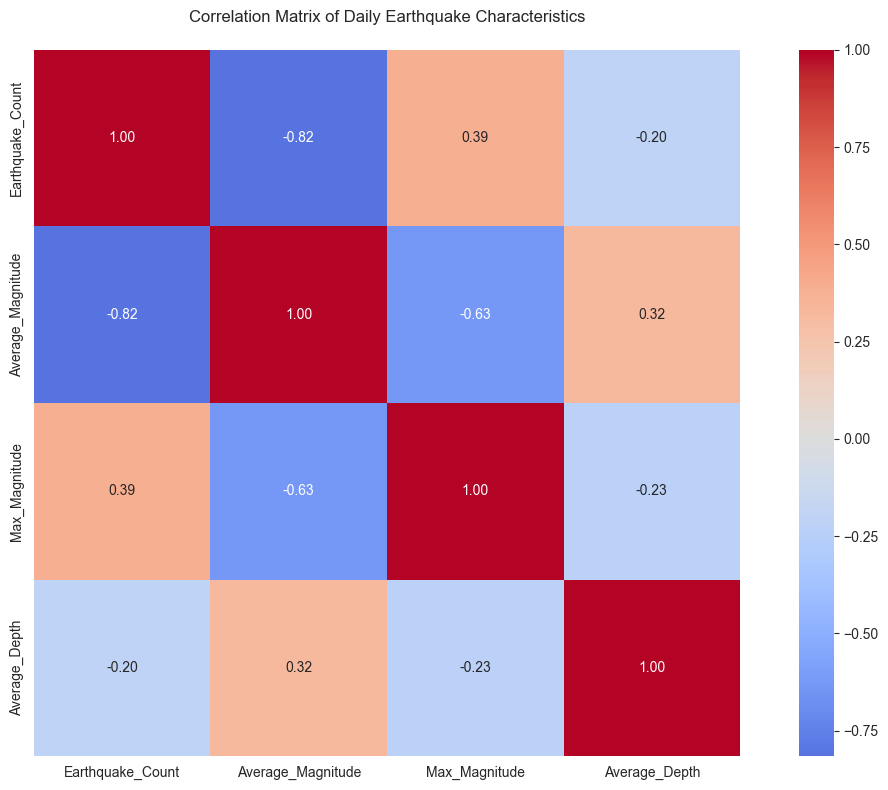


Daily Statistics:
           Earthquake_Count  Average_Magnitude  Max_Magnitude  Average_Depth
DayOfWeek                                                                   
Monday                 3176               3.58            7.7          14.34
Tuesday                2885               3.79            7.7          14.88
Wednesday              2897               3.86            6.8          15.65
Thursday               2881               3.83            6.7          14.36
Friday                 2802               3.83            7.2          13.93
Saturday               2675               3.88            7.2          14.99
Sunday                 2991               3.85            7.2          14.49

Key Correlations:
Average_Magnitude vs Earthquake_Count: -0.815
Average_Magnitude vs Max_Magnitude: -0.631

Chi-square Test for Uniform Distribution:
Chi-square statistic: 50.08
p-value: 0.0000
Interpretation: Non-uniform distribution

Day-to-Day Variation Analysis:
Monday to Tuesday: -

In [57]:
# Günlük veriyi hazırlama
df['DayOfWeek'] = pd.to_datetime(df['Olus tarihi']).dt.day_name()
day_order = ['Monday', 'Tuesday', 'Wednesday', 'Thursday', 'Friday', 'Saturday', 'Sunday']

# Günlük deprem sayıları ve özellikleri
daily_stats = df.groupby('DayOfWeek').agg({
    'Mw': ['count', 'mean', 'max'],
    'Derinlik': 'mean'
}).reindex(day_order)

# Sütun isimlerini düzenleme
daily_stats.columns = ['Earthquake_Count', 'Average_Magnitude', 'Max_Magnitude', 'Average_Depth']

# Korelasyon matrisi
correlation_matrix = daily_stats.corr()

# Görselleştirme
plt.figure(figsize=(12, 8))
sns.heatmap(correlation_matrix, 
            annot=True,
            cmap='coolwarm',
            center=0,
            fmt='.2f',
            square=True)
plt.title('Correlation Matrix of Daily Earthquake Characteristics', pad=20)
plt.tight_layout()
plt.show()

# Detaylı istatistikler
print("\nDaily Statistics:")
print("================")
print(daily_stats.round(2))

# Korelasyon analizi sonuçları
print("\nKey Correlations:")
print("================")
for col1 in daily_stats.columns:
    for col2 in daily_stats.columns:
        if col1 < col2:  # Her korelasyonu sadece bir kez yazdır
            corr = daily_stats[col1].corr(daily_stats[col2])
            if abs(corr) > 0.5:  # Sadece güçlü korelasyonları göster
                print(f"{col1} vs {col2}: {corr:.3f}")

# Günlük dağılım testi
from scipy import stats

# Ki-kare testi
expected = np.full(7, daily_stats['Earthquake_Count'].mean())
chi2, p_value = stats.chisquare(daily_stats['Earthquake_Count'], expected)

print("\nChi-square Test for Uniform Distribution:")
print("=======================================")
print(f"Chi-square statistic: {chi2:.2f}")
print(f"p-value: {p_value:.4f}")
print("Interpretation:", "Non-uniform distribution" if p_value < 0.05 else "Uniform distribution")

# Günler arası fark analizi
print("\nDay-to-Day Variation Analysis:")
print("============================")
for i in range(len(day_order)-1):
    day1 = day_order[i]
    day2 = day_order[i+1]
    count_diff = daily_stats.loc[day2, 'Earthquake_Count'] - daily_stats.loc[day1, 'Earthquake_Count']
    percent_change = (count_diff / daily_stats.loc[day1, 'Earthquake_Count']) * 100
    print(f"{day1} to {day2}: {count_diff:+.0f} earthquakes ({percent_change:+.1f}%)")

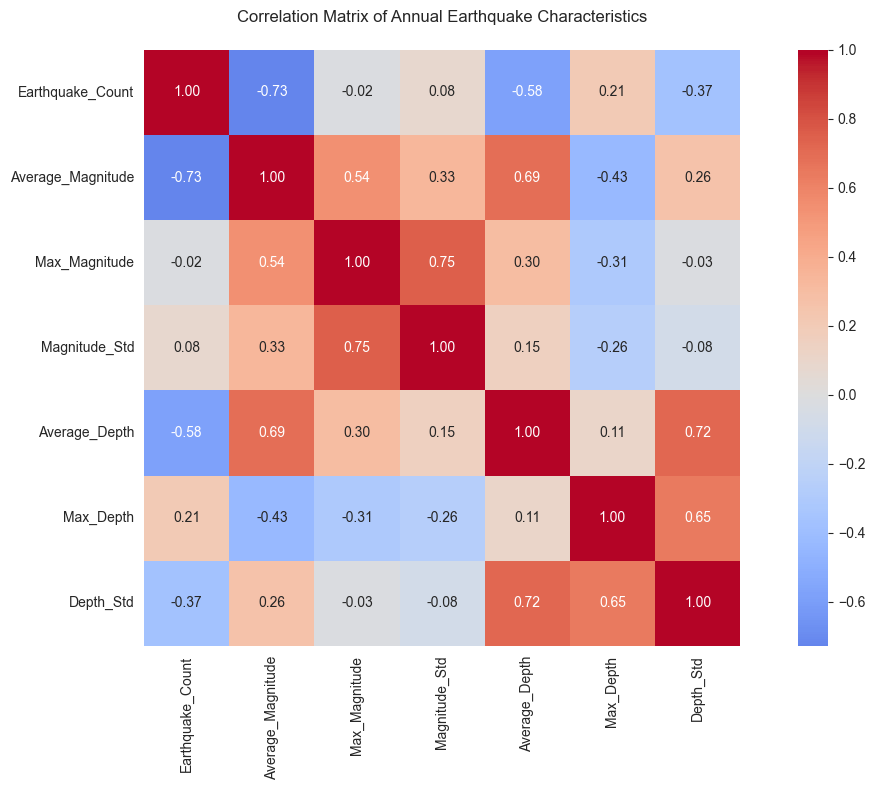

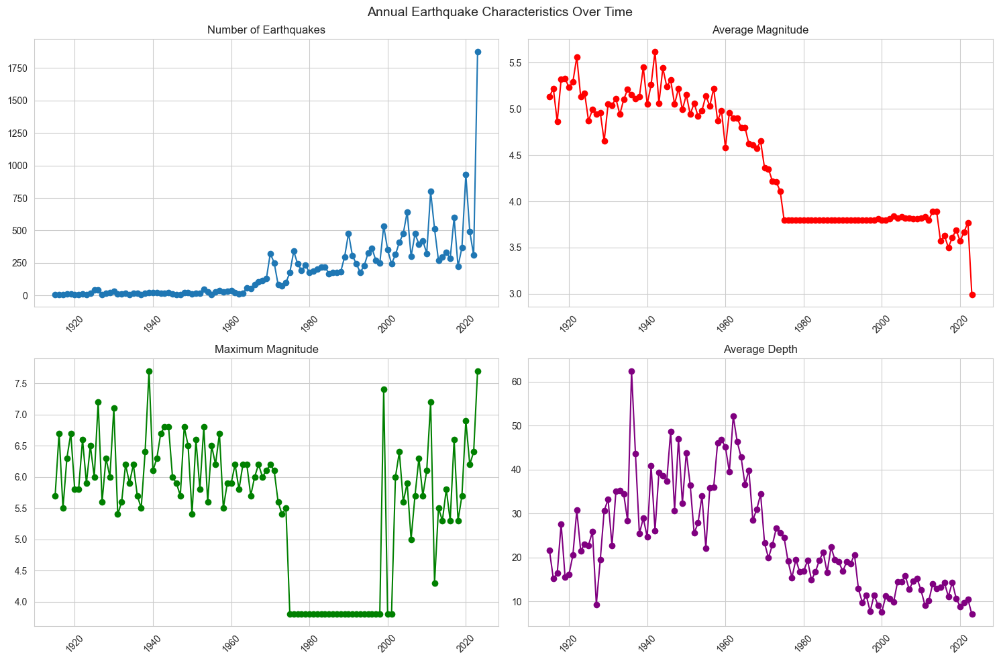


Annual Earthquake Statistics:
       Earthquake_Count  Average_Magnitude  Max_Magnitude  Magnitude_Std  \
count            109.00             109.00         109.00         109.00   
mean             186.30               4.44           5.55           0.43   
std              248.93               0.66           1.11           0.34   
min                5.00               2.99           3.80           0.00   
25%               18.00               3.80           5.00           0.12   
50%               98.00               4.57           5.80           0.48   
75%              297.00               5.05           6.30           0.63   
max             1878.00               5.62           7.70           1.70   

       Average_Depth  Max_Depth  Depth_Std  
count         109.00     109.00     109.00  
mean           23.89     117.68      22.47  
std            11.98      43.67       9.42  
min             7.07      15.00       4.24  
25%            14.40      83.00      15.72  
50%           

In [58]:
# Yıllık veriyi hazırlama
df['Year'] = pd.to_datetime(df['Olus tarihi']).dt.year

# Yıllık deprem istatistikleri
yearly_stats = df.groupby('Year').agg({
    'Mw': ['count', 'mean', 'max', 'std'],
    'Derinlik': ['mean', 'max', 'std']
}).round(2)

# Sütun isimlerini düzenleme
yearly_stats.columns = ['Earthquake_Count', 'Average_Magnitude', 'Max_Magnitude', 'Magnitude_Std',
                       'Average_Depth', 'Max_Depth', 'Depth_Std']

# Korelasyon matrisi
correlation_matrix = yearly_stats.corr()

# Görselleştirme 1: Korelasyon Heatmap
plt.figure(figsize=(12, 8))
sns.heatmap(correlation_matrix, 
            annot=True,
            cmap='coolwarm',
            center=0,
            fmt='.2f',
            square=True)
plt.title('Correlation Matrix of Annual Earthquake Characteristics', pad=20)
plt.tight_layout()
plt.show()

# Görselleştirme 2: Yıllık Trend Analizi
fig, axes = plt.subplots(2, 2, figsize=(15, 10))
fig.suptitle('Annual Earthquake Characteristics Over Time', fontsize=14)

# Deprem Sayısı Trendi
axes[0,0].plot(yearly_stats.index, yearly_stats['Earthquake_Count'], marker='o')
axes[0,0].set_title('Number of Earthquakes')
axes[0,0].grid(True)
axes[0,0].tick_params(axis='x', rotation=45)

# Ortalama Büyüklük Trendi
axes[0,1].plot(yearly_stats.index, yearly_stats['Average_Magnitude'], marker='o', color='red')
axes[0,1].set_title('Average Magnitude')
axes[0,1].grid(True)
axes[0,1].tick_params(axis='x', rotation=45)

# Maksimum Büyüklük Trendi
axes[1,0].plot(yearly_stats.index, yearly_stats['Max_Magnitude'], marker='o', color='green')
axes[1,0].set_title('Maximum Magnitude')
axes[1,0].grid(True)
axes[1,0].tick_params(axis='x', rotation=45)

# Ortalama Derinlik Trendi
axes[1,1].plot(yearly_stats.index, yearly_stats['Average_Depth'], marker='o', color='purple')
axes[1,1].set_title('Average Depth')
axes[1,1].grid(True)
axes[1,1].tick_params(axis='x', rotation=45)

plt.tight_layout()
plt.show()

# İstatistiksel Analiz
print("\nAnnual Earthquake Statistics:")
print("===========================")
print(yearly_stats.describe().round(2))

# Güçlü Korelasyonları Bulma
print("\nStrong Correlations (|r| > 0.5):")
print("================================")
for col1 in yearly_stats.columns:
    for col2 in yearly_stats.columns:
        if col1 < col2:
            corr = yearly_stats[col1].corr(yearly_stats[col2])
            if abs(corr) > 0.5:
                print(f"{col1} vs {col2}: {corr:.3f}")

# Trend Analizi
from scipy import stats

print("\nTrend Analysis:")
print("==============")
for column in yearly_stats.columns:
    slope, intercept, r_value, p_value, std_err = stats.linregress(range(len(yearly_stats.index)), 
                                                                  yearly_stats[column])
    trend = "Increasing" if slope > 0 else "Decreasing"
    significance = "Significant" if p_value < 0.05 else "Not significant"
    
    print(f"\n{column}:")
    print(f"Trend: {trend} ({slope:.4f} per year)")
    print(f"Statistical Significance: {significance} (p={p_value:.4f})")
    print(f"R-squared: {r_value**2:.4f}")

C:\Users\İSAILICA\AppData\Local\Temp\ipykernel_12860\1223920420.py:14: UserWarning: Tight layout not applied. The bottom and top margins cannot be made large enough to accommodate all Axes decorations.
  plt.tight_layout()


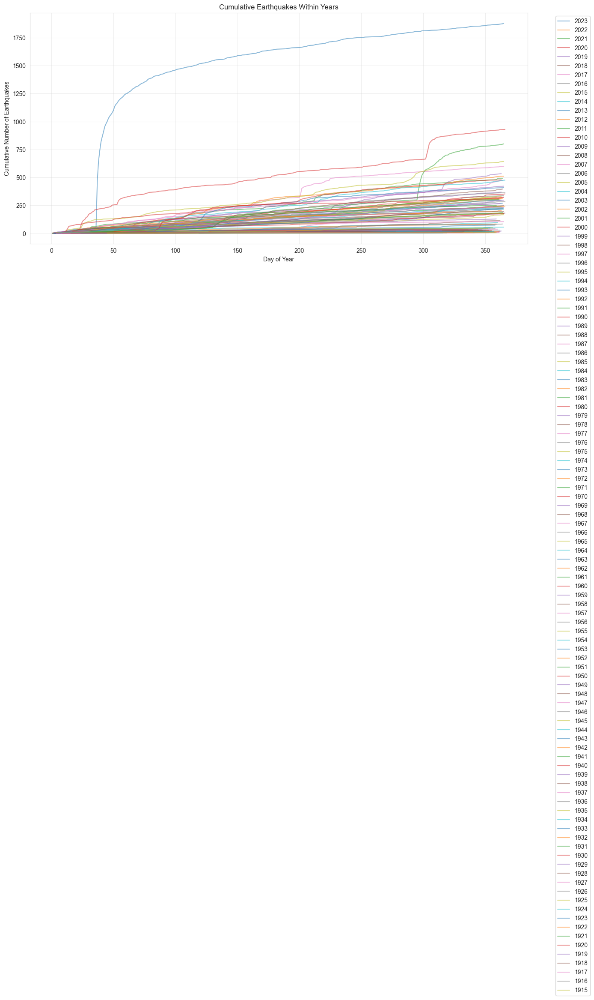

In [59]:
df['DayOfYear'] = pd.to_datetime(df['Olus tarihi']).dt.dayofyear
df['Year'] = pd.to_datetime(df['Olus tarihi']).dt.year

plt.figure(figsize=(15, 7))
for year in df['Year'].unique():
    year_data = df[df['Year'] == year].groupby('DayOfYear').size().cumsum()
    plt.plot(year_data.index, year_data.values, label=str(year), alpha=0.5)

plt.title('Cumulative Earthquakes Within Years')
plt.xlabel('Day of Year')
plt.ylabel('Cumulative Number of Earthquakes')
plt.grid(True, alpha=0.3)
plt.legend(bbox_to_anchor=(1.05, 1), loc='upper left')
plt.tight_layout()
plt.show()


**MEKANSAL ANALİZ** 

In [60]:
import folium
from folium import plugins
import numpy as np

# Türkiye'nin merkez koordinatları
turkey_center = [39.0, 35.0]

# Ana haritayı oluştur
m = folium.Map(location=turkey_center, zoom_start=6)

# Deprem noktalarını haritaya ekle
for idx, row in df.iterrows():
    folium.CircleMarker(
        location=[row['Enlem'], row['Boylam']],
        radius=row['Mw']*2,  # Büyüklüğe göre daire boyutu
        popup=f"Magnitude: {row['Mw']}, Depth: {row['Derinlik']}km",
        color='red',
        fill=True,
        fill_color='red'
    ).add_to(m)

# Isı haritası katmanı ekle
heat_data = [[row['Enlem'], row['Boylam']] for idx, row in df.iterrows()]
plugins.HeatMap(heat_data).add_to(m)

# Haritayı göster
m.save('turkiye_deprem_haritasi.html')

# İstatistiksel mekansal analiz
print("\nMekansal İstatistikler:")
print("=====================")
print(f"En kuzey nokta: {df['Enlem'].max():.2f}°N")
print(f"En güney nokta: {df['Enlem'].min():.2f}°N")
print(f"En doğu nokta: {df['Boylam'].max():.2f}°E")
print(f"En batı nokta: {df['Boylam'].min():.2f}°E")

# Bölgesel yoğunluk analizi
lat_bins = np.linspace(df['Enlem'].min(), df['Enlem'].max(), 5)
lon_bins = np.linspace(df['Boylam'].min(), df['Boylam'].max(), 5)

print("\nBölgesel Deprem Yoğunluğu:")
print("=========================")
for i in range(len(lat_bins)-1):
    for j in range(len(lon_bins)-1):
        region_quakes = df[
            (df['Enlem'] >= lat_bins[i]) & 
            (df['Enlem'] < lat_bins[i+1]) &
            (df['Boylam'] >= lon_bins[j]) & 
            (df['Boylam'] < lon_bins[j+1])
        ]
        print(f"Bölge {i+1}-{j+1}: {len(region_quakes)} deprem")


Mekansal İstatistikler:
En kuzey nokta: 42.00°N
En güney nokta: 35.00°N
En doğu nokta: 45.00°E
En batı nokta: 26.00°E

Bölgesel Deprem Yoğunluğu:
Bölge 1-1: 3571 deprem
Bölge 1-2: 722 deprem
Bölge 1-3: 364 deprem
Bölge 1-4: 166 deprem
Bölge 2-1: 3553 deprem
Bölge 2-2: 429 deprem
Bölge 2-3: 2350 deprem
Bölge 2-4: 657 deprem
Bölge 3-1: 3050 deprem
Bölge 3-2: 484 deprem
Bölge 3-3: 825 deprem
Bölge 3-4: 1968 deprem
Bölge 4-1: 919 deprem
Bölge 4-2: 776 deprem
Bölge 4-3: 140 deprem
Bölge 4-4: 331 deprem


In [61]:
# Deprem kümelenmesi analizi
from sklearn.cluster import DBSCAN
from sklearn.preprocessing import StandardScaler

# Koordinatları ölçeklendirme
coords = df[['Enlem', 'Boylam']].values
coords_scaled = StandardScaler().fit_transform(coords)

# DBSCAN ile kümeleme
db = DBSCAN(eps=0.3, min_samples=5).fit(coords_scaled)
df['Cluster'] = db.labels_

# Küme istatistikleri
n_clusters = len(set(db.labels_)) - (1 if -1 in db.labels_ else 0)
print(f"\nToplam küme sayısı: {n_clusters}")
print(f"Kümelenmeyen deprem sayısı: {list(db.labels_).count(-1)}")

# Her kümedeki deprem sayısı
for i in range(n_clusters):
    cluster_size = list(db.labels_).count(i)
    print(f"Küme {i}: {cluster_size} deprem")


Toplam küme sayısı: 1
Kümelenmeyen deprem sayısı: 0
Küme 0: 20307 deprem


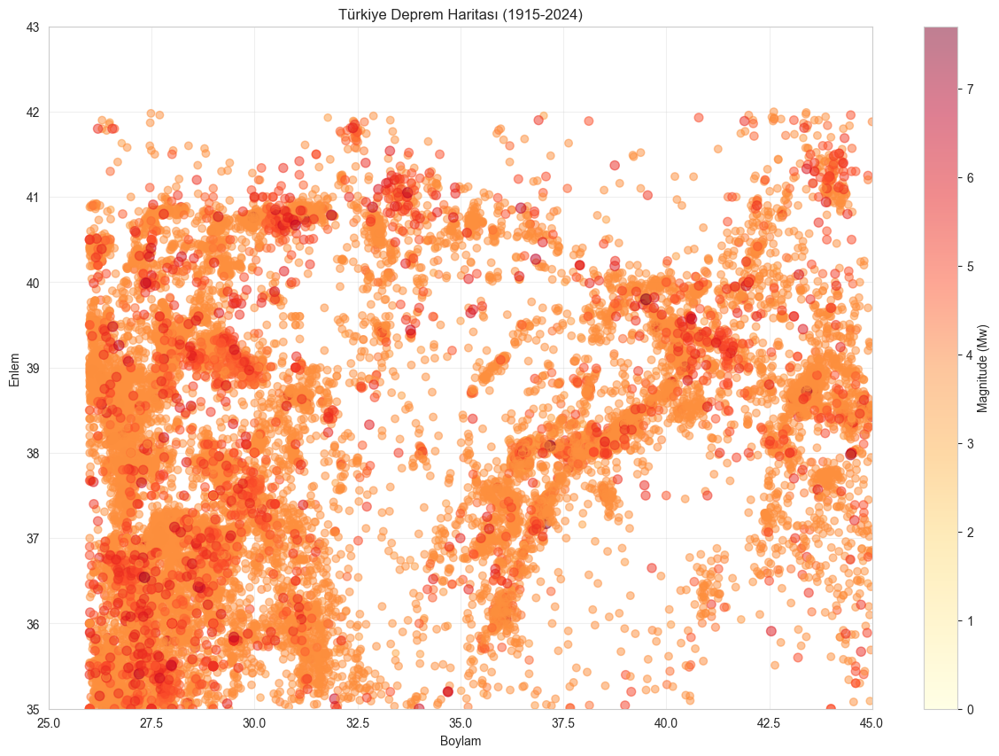

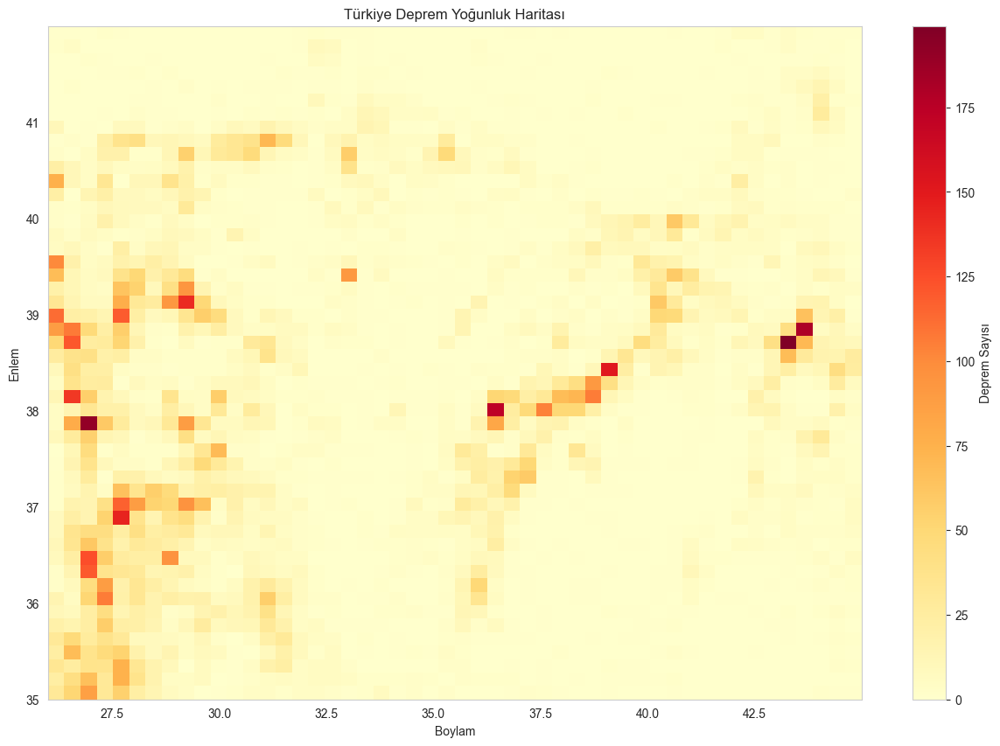

In [62]:
import matplotlib.pyplot as plt

# Türkiye haritası sınırları
plt.figure(figsize=(15, 10))

# Depremleri scatter plot olarak göster
plt.scatter(df['Boylam'], df['Enlem'], 
           c=df['Mw'],  # Büyüklüğe göre renklendirme
           s=df['Mw']*10,  # Büyüklüğe göre nokta boyutu
           alpha=0.5,
           cmap='YlOrRd')

plt.colorbar(label='Magnitude (Mw)')

# Harita sınırlarını ayarla (Türkiye'yi kapsayacak şekilde)
plt.xlim(25, 45)
plt.ylim(35, 43)

plt.title('Türkiye Deprem Haritası (1915-2024)')
plt.xlabel('Boylam')
plt.ylabel('Enlem')
plt.grid(True, alpha=0.3)

plt.show()

# Yoğunluk haritası
plt.figure(figsize=(15, 10))
plt.hist2d(df['Boylam'], df['Enlem'], 
          bins=50, 
          cmap='YlOrRd')
plt.colorbar(label='Deprem Sayısı')

plt.title('Türkiye Deprem Yoğunluk Haritası')
plt.xlabel('Boylam')
plt.ylabel('Enlem')
plt.grid(True, alpha=0.3)

plt.show()

In [63]:
import folium
from folium import plugins

# Filter earthquakes with magnitude 6 and above
major_earthquakes = df[df['Mw'] >= 6.0]

# Center coordinates of Turkey
turkey_center = [39.0, 35.0]

# Create main map
m = folium.Map(location=turkey_center, zoom_start=6)

# Add earthquake points to map
for idx, row in major_earthquakes.iterrows():
    folium.CircleMarker(
        location=[row['Enlem'], row['Boylam']],
        radius=row['Mw']*2,  # Circle size based on magnitude
        popup=f"Date: {row['Olus tarihi']}<br>"
              f"Magnitude: {row['Mw']}<br>"
              f"Depth: {row['Derinlik']}km",
        color='red',
        fill=True,
        fill_color='red'
    ).add_to(m)

# Add heatmap layer
heat_data = [[row['Enlem'], row['Boylam']] for idx, row in major_earthquakes.iterrows()]
plugins.HeatMap(heat_data).add_to(m)

# Display map
display(m)

# Show statistical information
print(f"\nTotal {len(major_earthquakes)} earthquakes with magnitude 6+")
print("\nMagnitude Statistics:")
print("=====================")
print(f"Largest earthquake: {major_earthquakes['Mw'].max():.1f}")
print(f"Average magnitude: {major_earthquakes['Mw'].mean():.1f}")

# Show distribution by years
print("\nEarthquakes 6+ by Year:")
print("=====================")
major_earthquakes['Year'] = major_earthquakes['Year'].astype(int)
by_year = major_earthquakes.groupby('Year').size()
for year, count in by_year.items():
    print(f"{year}: {count} earthquakes")


Total 80 earthquakes with magnitude 6+

Magnitude Statistics:
Largest earthquake: 7.7
Average magnitude: 6.4

Earthquakes 6+ by Year:
1916: 1 earthquakes
1918: 2 earthquakes
1919: 1 earthquakes
1922: 2 earthquakes
1924: 1 earthquakes
1925: 1 earthquakes
1926: 4 earthquakes
1928: 2 earthquakes
1929: 1 earthquakes
1930: 1 earthquakes
1933: 1 earthquakes
1935: 4 earthquakes
1938: 1 earthquakes
1939: 2 earthquakes
1940: 1 earthquakes
1941: 3 earthquakes
1942: 3 earthquakes
1943: 2 earthquakes
1944: 3 earthquakes
1945: 1 earthquakes
1948: 1 earthquakes
1949: 2 earthquakes
1951: 1 earthquakes
1953: 2 earthquakes
1955: 1 earthquakes
1956: 1 earthquakes
1957: 3 earthquakes
1961: 1 earthquakes
1963: 1 earthquakes
1964: 1 earthquakes
1966: 1 earthquakes
1967: 1 earthquakes
1968: 1 earthquakes
1969: 1 earthquakes
1970: 1 earthquakes
1971: 2 earthquakes
1999: 2 earthquakes
2002: 2 earthquakes
2003: 2 earthquakes
2008: 1 earthquakes
2010: 1 earthquakes
2011: 2 earthquakes
2017: 2 earthquakes
2020:

C:\Users\İSAILICA\AppData\Local\Temp\ipykernel_12860\3478054558.py:43: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  major_earthquakes['Year'] = major_earthquakes['Year'].astype(int)



Total number of earthquakes (M5+): 873

Magnitude Statistics:
Maximum magnitude: 7.7
Average magnitude: 5.4
Median magnitude: 5.3


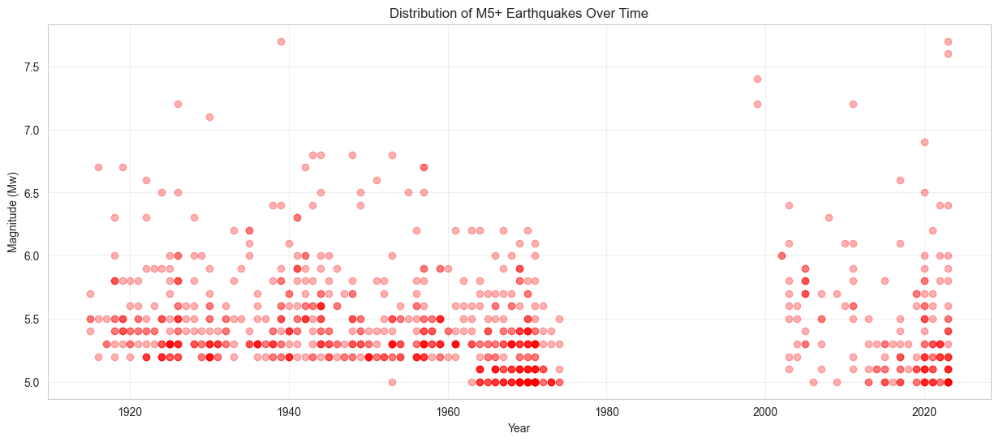

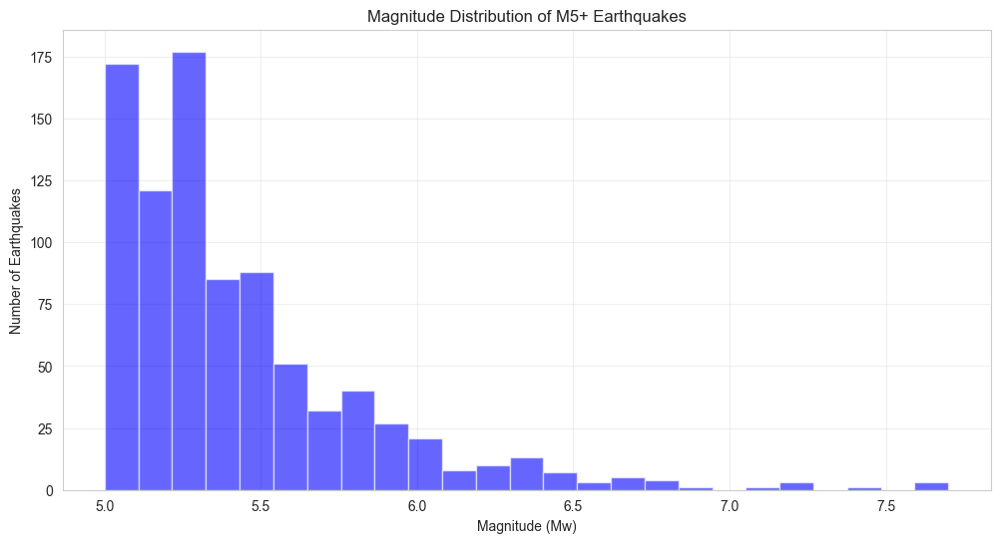

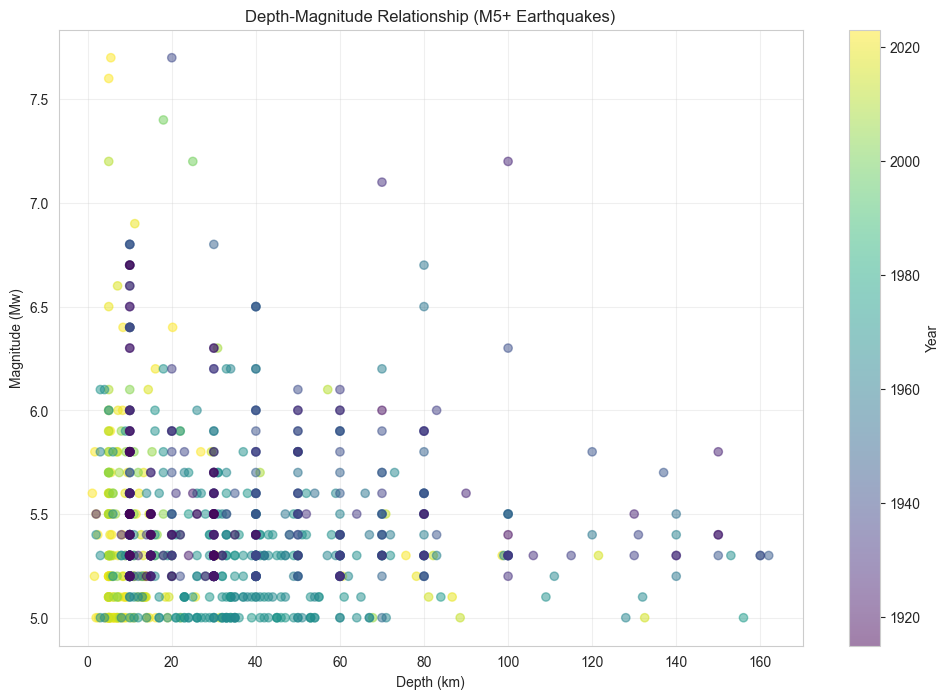


Number of M5+ Earthquakes by Region:
Western Anatolia    460
Eastern Anatolia    264
Central Anatolia    149
Name: Region, dtype: int64

Number of M5+ Earthquakes by Decade:
Decade
1910     30
1920    102
1930     89
1940    116
1950    110
1960    150
1970     94
1990      2
2000     34
2010     54
2020     92
dtype: int64

Average annual number of M5+ earthquakes: 10.6


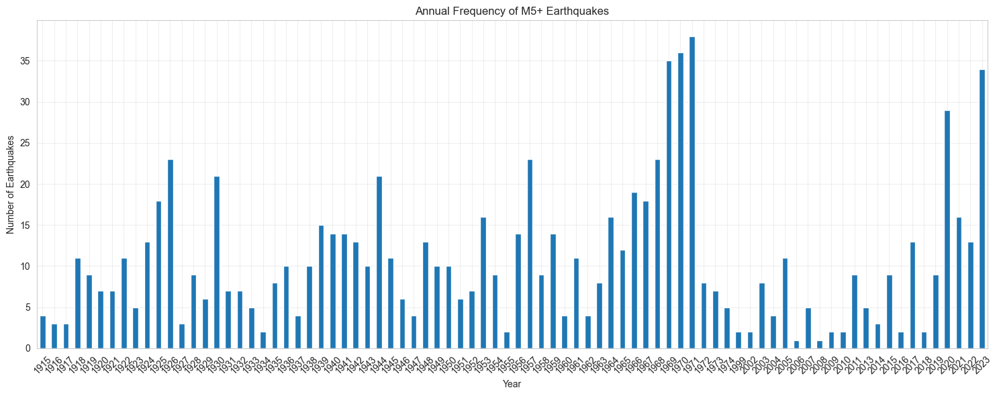

In [64]:
import seaborn as sns
import matplotlib.pyplot as plt
import folium
from folium import plugins

# Filter earthquakes >= 5.0
major_quakes = df[df['Mw'] >= 5.0].copy()
major_quakes['Year'] = major_quakes['Year']  # Tarih sütunu yerine Year kullanıldı
major_quakes['Decade'] = (major_quakes['Year'] // 10) * 10

# Folium map
turkey_center = [39.0, 35.0]
m = folium.Map(location=turkey_center, zoom_start=6)

# Add earthquake points to map
for idx, row in major_quakes.iterrows():
    folium.CircleMarker(
        location=[row['Enlem'], row['Boylam']],
        radius=row['Mw']*1.5,
        popup=f"Date: {row['Olus tarihi']}<br>"  # Tarih yerine Olus tarihi kullanıldı
              f"Magnitude: {row['Mw']:.1f}<br>"
              f"Depth: {row['Derinlik']}km",
        color='red',
        fill=True,
        fill_color='red',
        fill_opacity=0.6
    ).add_to(m)

# Add heatmap
heat_data = [[row['Enlem'], row['Boylam']] for idx, row in major_quakes.iterrows()]
plugins.HeatMap(heat_data).add_to(m)

display(m)

# Statistical information
print(f"\nTotal number of earthquakes (M5+): {len(major_quakes)}")
print("\nMagnitude Statistics:")
print("=====================")
print(f"Maximum magnitude: {major_quakes['Mw'].max():.1f}")
print(f"Average magnitude: {major_quakes['Mw'].mean():.1f}")
print(f"Median magnitude: {major_quakes['Mw'].median():.1f}")

# 1. Time series plot
plt.figure(figsize=(15, 6))
plt.plot(major_quakes['Year'], major_quakes['Mw'], 'ro', alpha=0.3)
plt.grid(True, alpha=0.3)
plt.title('Distribution of M5+ Earthquakes Over Time')
plt.xlabel('Year')
plt.ylabel('Magnitude (Mw)')
plt.show()

# 2. Magnitude distribution
plt.figure(figsize=(12, 6))
plt.hist(major_quakes['Mw'], bins=25, color='blue', alpha=0.6)
plt.title('Magnitude Distribution of M5+ Earthquakes')
plt.xlabel('Magnitude (Mw)')
plt.ylabel('Number of Earthquakes')
plt.grid(True, alpha=0.3)
plt.show()

# 3. Depth-Magnitude relationship
plt.figure(figsize=(12, 8))
plt.scatter(major_quakes['Derinlik'], major_quakes['Mw'], 
           alpha=0.5, c=major_quakes['Year'], cmap='viridis')
plt.colorbar(label='Year')
plt.title('Depth-Magnitude Relationship (M5+ Earthquakes)')
plt.xlabel('Depth (km)')
plt.ylabel('Magnitude (Mw)')
plt.grid(True, alpha=0.3)
plt.show()

# Regional analysis
def determine_region(row):
    if row['Boylam'] < 30:
        return 'Western Anatolia'
    elif row['Boylam'] < 35:
        return 'Central Anatolia'
    else:
        return 'Eastern Anatolia'

major_quakes['Region'] = major_quakes.apply(determine_region, axis=1)

# Summary statistics
print("\nNumber of M5+ Earthquakes by Region:")
print("================================")
print(major_quakes['Region'].value_counts())

print("\nNumber of M5+ Earthquakes by Decade:")
print("================================")
decade_counts = major_quakes.groupby('Decade').size()
print(decade_counts)

# Annual average
yearly_quakes = major_quakes.groupby('Year').size()
print(f"\nAverage annual number of M5+ earthquakes: {yearly_quakes.mean():.1f}")

# 4. Annual frequency plot
plt.figure(figsize=(15, 6))
yearly_quakes.plot(kind='bar')
plt.title('Annual Frequency of M5+ Earthquakes')
plt.xlabel('Year')
plt.ylabel('Number of Earthquakes')
plt.xticks(rotation=45)
plt.grid(True, alpha=0.3)
plt.tight_layout()
plt.show()


Toplam deprem sayısı (M5+): 873

Büyüklük İstatistikleri:
Maksimum büyüklük: 7.7
Ortalama büyüklük: 5.4
Medyan büyüklük: 5.3


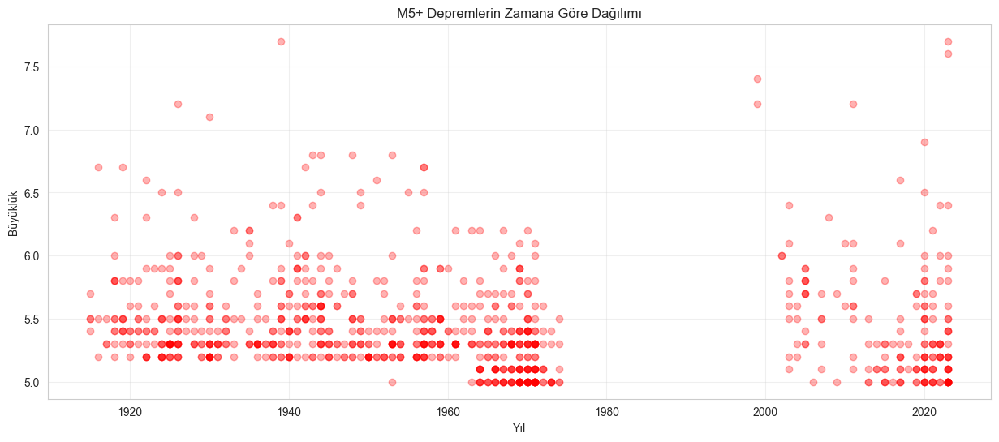

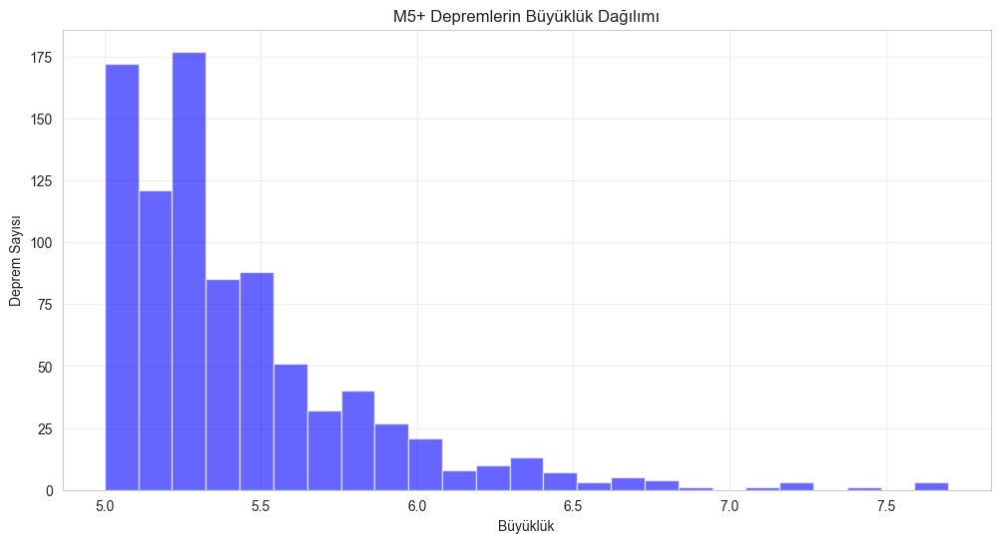

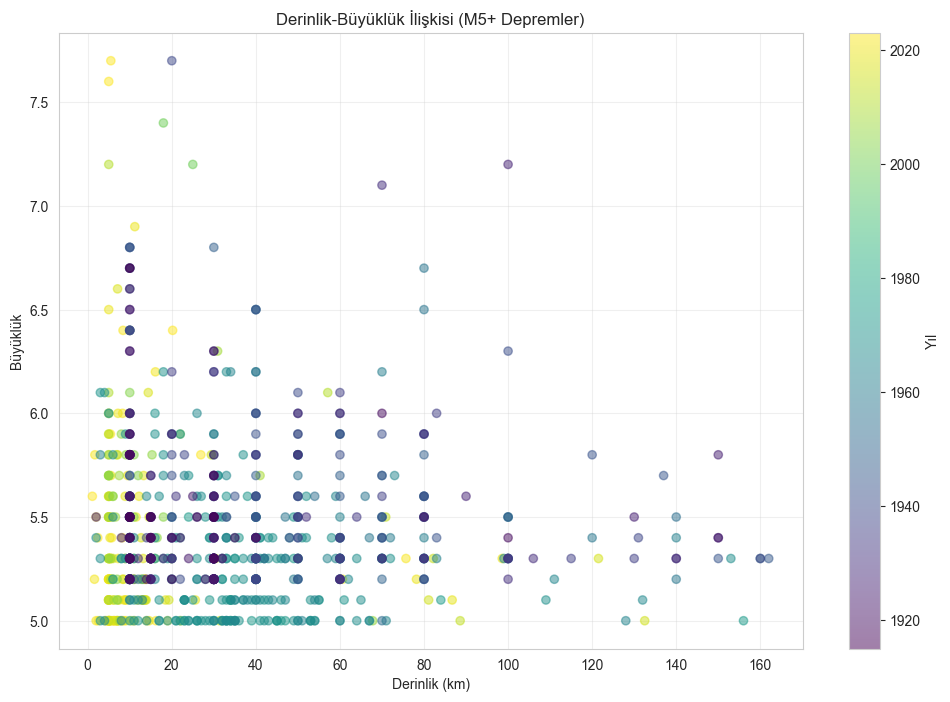


Bölgelere Göre M5+ Deprem Sayısı:
Batı Anadolu    460
Doğu Anadolu    264
Orta Anadolu    149
Name: Region, dtype: int64

Onluk Yıllara Göre M5+ Deprem Sayısı:
Decade
1910     30
1920    102
1930     89
1940    116
1950    110
1960    150
1970     94
1990      2
2000     34
2010     54
2020     92
dtype: int64

Ortalama yıllık M5+ deprem sayısı: 10.6


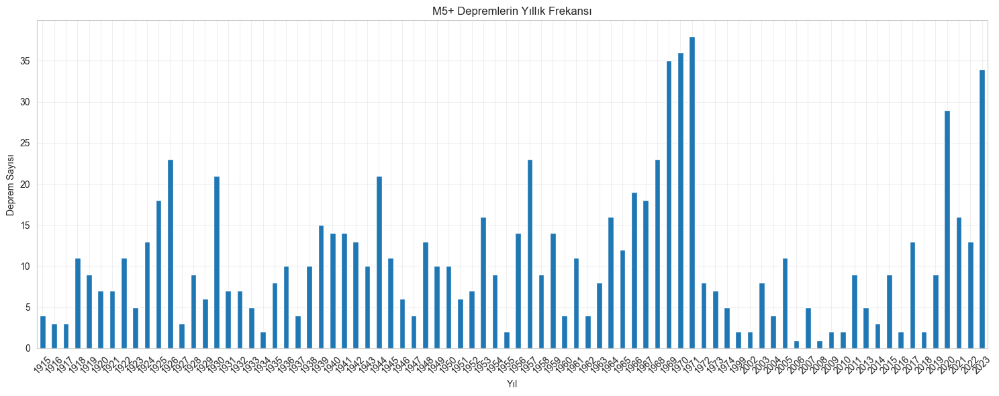

In [65]:
import seaborn as sns
import matplotlib.pyplot as plt
import folium
from folium import plugins

# 5.0 ve üzeri depremleri filtrele
major_quakes = df[df['Mw'] >= 5.0].copy()
major_quakes['Year'] = major_quakes['Year'] 
major_quakes['Decade'] = (major_quakes['Year'] // 10) * 10

# Folium haritası
turkey_center = [39.0, 35.0]
m = folium.Map(location=turkey_center, zoom_start=6)

# Deprem noktalarını haritaya ekle
for idx, row in major_quakes.iterrows():
    folium.CircleMarker(
        location=[row['Enlem'], row['Boylam']],
        radius=row['Mw']*1.5,
        popup=f"Tarih: {row['Olus tarihi']}<br>"
              f"Büyüklük: {row['Mw']:.1f}<br>"
              f"Derinlik: {row['Derinlik']}km",
        color='red',
        fill=True,
        fill_color='red',
        fill_opacity=0.6
    ).add_to(m)

# Isı haritası ekle
heat_data = [[row['Enlem'], row['Boylam']] for idx, row in major_quakes.iterrows()]
plugins.HeatMap(heat_data).add_to(m)

display(m)

# İstatistiksel bilgiler
print(f"\nToplam deprem sayısı (M5+): {len(major_quakes)}")
print("\nBüyüklük İstatistikleri:")
print("=====================")
print(f"Maksimum büyüklük: {major_quakes['Mw'].max():.1f}")
print(f"Ortalama büyüklük: {major_quakes['Mw'].mean():.1f}")
print(f"Medyan büyüklük: {major_quakes['Mw'].median():.1f}")

# 1. Zaman serisi grafiği
plt.figure(figsize=(15, 6))
plt.plot(major_quakes['Year'], major_quakes['Mw'], 'ro', alpha=0.3)
plt.grid(True, alpha=0.3)
plt.title('M5+ Depremlerin Zamana Göre Dağılımı')
plt.xlabel('Yıl')
plt.ylabel('Büyüklük')
plt.show()

# 2. Büyüklük dağılımı
plt.figure(figsize=(12, 6))
plt.hist(major_quakes['Mw'], bins=25, color='blue', alpha=0.6)
plt.title('M5+ Depremlerin Büyüklük Dağılımı')
plt.xlabel('Büyüklük')
plt.ylabel('Deprem Sayısı')
plt.grid(True, alpha=0.3)
plt.show()

# 3. Derinlik-Büyüklük ilişkisi
plt.figure(figsize=(12, 8))
plt.scatter(major_quakes['Derinlik'], major_quakes['Mw'], 
           alpha=0.5, c=major_quakes['Year'], cmap='viridis')
plt.colorbar(label='Yıl')
plt.title('Derinlik-Büyüklük İlişkisi (M5+ Depremler)')
plt.xlabel('Derinlik (km)')
plt.ylabel('Büyüklük')
plt.grid(True, alpha=0.3)
plt.show()

# Bölgesel analiz
def determine_region(row):
    if row['Boylam'] < 30:
        return 'Batı Anadolu'
    elif row['Boylam'] < 35:
        return 'Orta Anadolu'
    else:
        return 'Doğu Anadolu'

major_quakes['Region'] = major_quakes.apply(determine_region, axis=1)

# Özet istatistikler
print("\nBölgelere Göre M5+ Deprem Sayısı:")
print("================================")
print(major_quakes['Region'].value_counts())

print("\nOnluk Yıllara Göre M5+ Deprem Sayısı:")
print("================================")
decade_counts = major_quakes.groupby('Decade').size()
print(decade_counts)

# Yıllık ortalama
yearly_quakes = major_quakes.groupby('Year').size()
print(f"\nOrtalama yıllık M5+ deprem sayısı: {yearly_quakes.mean():.1f}")

# 4. Yıllık frekans grafiği
plt.figure(figsize=(15, 6))
yearly_quakes.plot(kind='bar')
plt.title('M5+ Depremlerin Yıllık Frekansı')
plt.xlabel('Yıl')
plt.ylabel('Deprem Sayısı')
plt.xticks(rotation=45)
plt.grid(True, alpha=0.3)
plt.tight_layout()
plt.show()

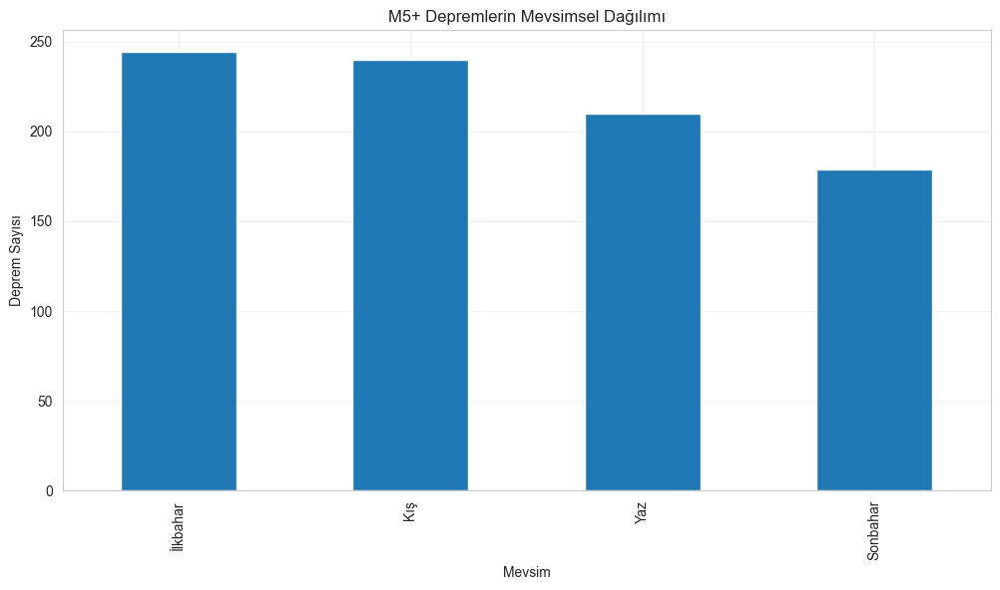

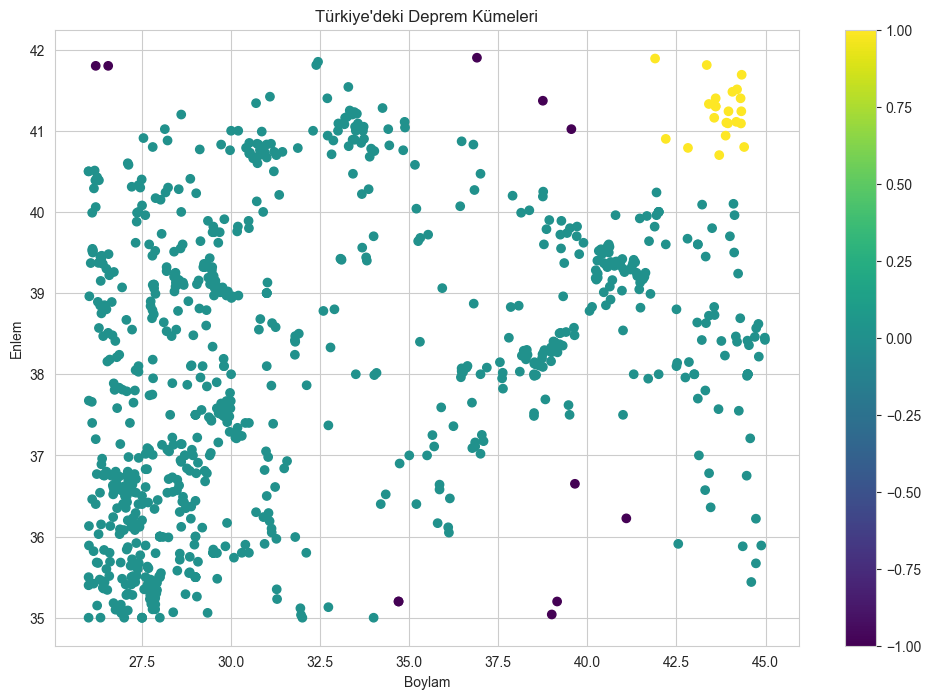

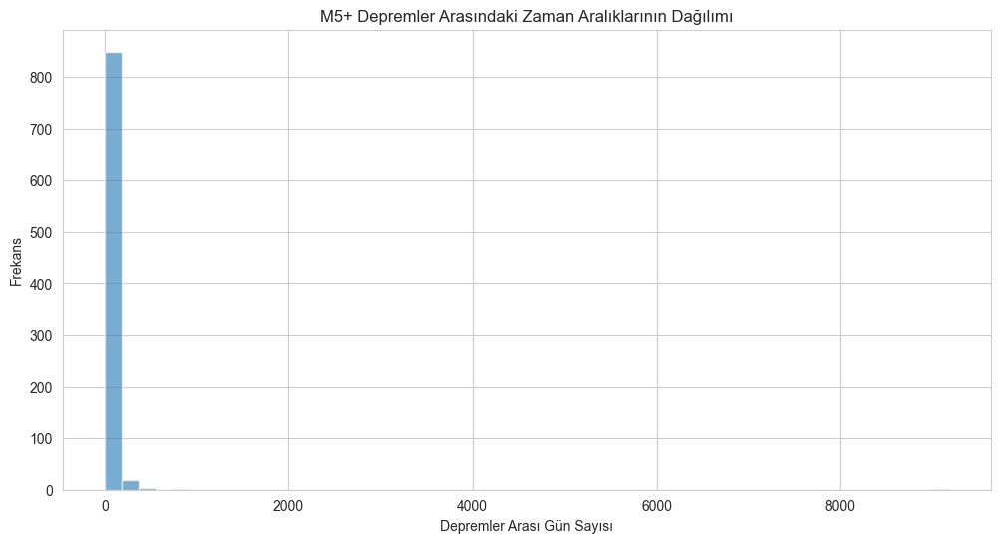


Zaman Aralığı İstatistikleri (gün):
Ortalama aralık: 45.6
Medyan aralık: 16.0
Maksimum aralık: 9170.0


C:\Users\İSAILICA\AppData\Local\Temp\ipykernel_12860\2927617109.py:62: RuntimeWarning: divide by zero encountered in log10
  log_N = np.log10(np.cumsum(hist[::-1])[::-1])


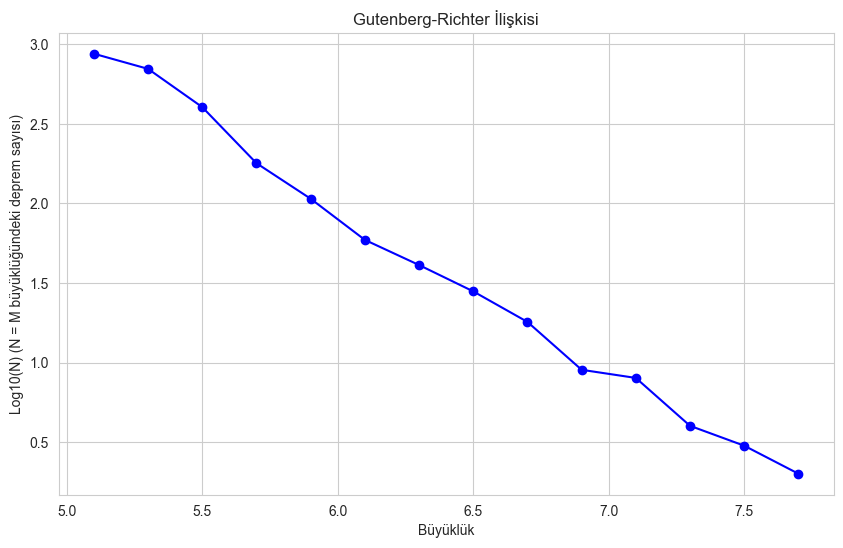


Gutenberg-Richter b-değeri: nan
R-kare değeri: nan


C:\Users\İSAILICA\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.12_qbz5n2kfra8p0\LocalCache\local-packages\Python312\site-packages\numpy\lib\function_base.py:2742: RuntimeWarning: invalid value encountered in subtract
  X -= avg[:, None]


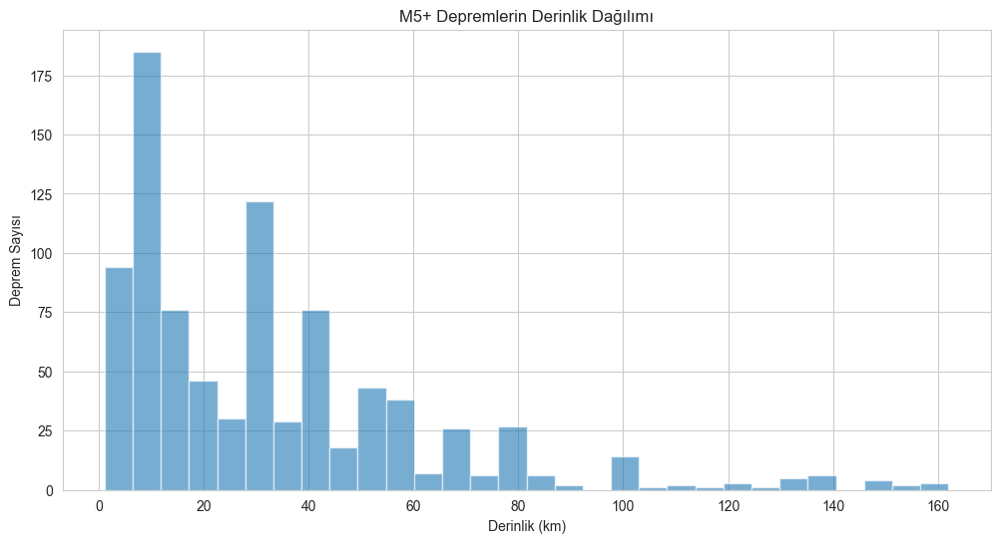


Derinlik İstatistikleri (km):
Ortalama derinlik: 33.0
Medyan derinlik: 29.0
En sık görülen derinlik aralığı: 10.0


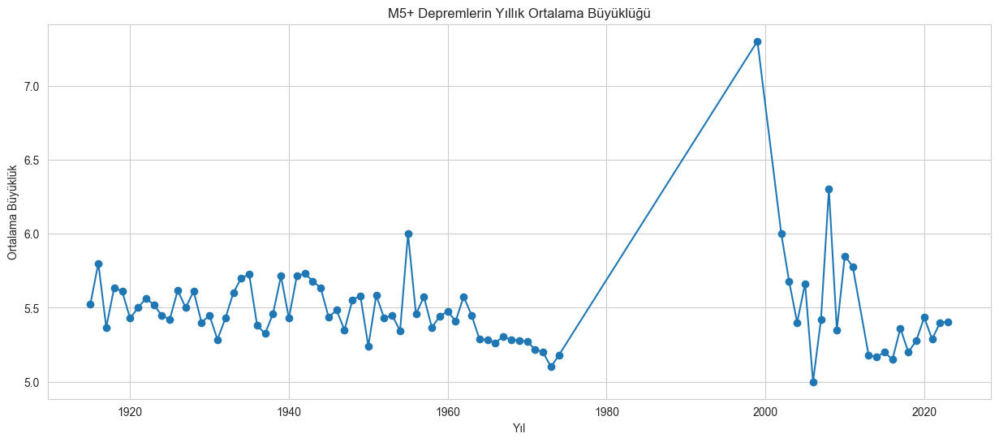

In [66]:
import numpy as np
from scipy import stats
import matplotlib.pyplot as plt
from sklearn.cluster import DBSCAN
from sklearn.preprocessing import StandardScaler

# 1. Mevsimsel Analiz
major_quakes['Month'] = pd.to_datetime(major_quakes['Olus tarihi']).dt.month
major_quakes['Season'] = pd.cut(major_quakes['Month'], 
                               bins=[0,3,6,9,12], 
                               labels=['Kış', 'İlkbahar', 'Yaz', 'Sonbahar'])

plt.figure(figsize=(12, 6))
season_counts = major_quakes['Season'].value_counts()
season_counts.plot(kind='bar')
plt.title('M5+ Depremlerin Mevsimsel Dağılımı')
plt.xlabel('Mevsim')
plt.ylabel('Deprem Sayısı')
plt.grid(True, alpha=0.3)
plt.show()

# 2. Kümeleme Analizi (DBSCAN)
coords = major_quakes[['Enlem', 'Boylam']].values
coords_scaled = StandardScaler().fit_transform(coords)
db = DBSCAN(eps=0.3, min_samples=5).fit(coords_scaled)
major_quakes['Cluster'] = db.labels_

# Kümeleri görselleştir
plt.figure(figsize=(12, 8))
scatter = plt.scatter(major_quakes['Boylam'], 
                     major_quakes['Enlem'],
                     c=major_quakes['Cluster'],
                     cmap='viridis')
plt.colorbar(scatter)
plt.title('Türkiye\'deki Deprem Kümeleri')
plt.xlabel('Boylam')
plt.ylabel('Enlem')
plt.grid(True)
plt.show()

# 3. Zaman Aralığı Analizi
major_quakes_sorted = major_quakes.sort_values('Olus tarihi')
time_gaps = pd.to_datetime(major_quakes_sorted['Olus tarihi']).diff().dt.days

plt.figure(figsize=(12, 6))
plt.hist(time_gaps, bins=50, alpha=0.6)
plt.title('M5+ Depremler Arasındaki Zaman Aralıklarının Dağılımı')
plt.xlabel('Depremler Arası Gün Sayısı')
plt.ylabel('Frekans')
plt.grid(True)
plt.show()

print("\nZaman Aralığı İstatistikleri (gün):")
print(f"Ortalama aralık: {time_gaps.mean():.1f}")
print(f"Medyan aralık: {time_gaps.median():.1f}")
print(f"Maksimum aralık: {time_gaps.max():.1f}")

# 4. Büyüklük-Frekans İlişkisi (Gutenberg-Richter Yasası)
magnitudes = np.array(major_quakes['Mw'])
bins = np.arange(5, 9, 0.2)
hist, bin_edges = np.histogram(magnitudes, bins=bins)
log_N = np.log10(np.cumsum(hist[::-1])[::-1])
magnitude_centers = (bin_edges[:-1] + bin_edges[1:]) / 2

plt.figure(figsize=(10, 6))
plt.plot(magnitude_centers, log_N, 'bo-')
plt.title('Gutenberg-Richter İlişkisi')
plt.xlabel('Büyüklük')
plt.ylabel('Log10(N) (N = M büyüklüğündeki deprem sayısı)')
plt.grid(True)
plt.show()

# b-değerini hesapla
slope, intercept, r_value, p_value, std_err = stats.linregress(magnitude_centers, log_N)
print(f"\nGutenberg-Richter b-değeri: {-slope:.2f}")
print(f"R-kare değeri: {r_value**2:.3f}")

# 5. Derinlik Dağılımı Analizi
plt.figure(figsize=(12, 6))
plt.hist(major_quakes['Derinlik'], bins=30, alpha=0.6)
plt.title('M5+ Depremlerin Derinlik Dağılımı')
plt.xlabel('Derinlik (km)')
plt.ylabel('Deprem Sayısı')
plt.grid(True)
plt.show()

# Derinlik istatistiklerini hesapla
print("\nDerinlik İstatistikleri (km):")
print(f"Ortalama derinlik: {major_quakes['Derinlik'].mean():.1f}")
print(f"Medyan derinlik: {major_quakes['Derinlik'].median():.1f}")
print(f"En sık görülen derinlik aralığı: {major_quakes['Derinlik'].mode().iloc[0]:.1f}")

# 6. Yıllık Büyüklük Trendleri
yearly_avg_magnitude = major_quakes.groupby('Year')['Mw'].mean()

plt.figure(figsize=(15, 6))
yearly_avg_magnitude.plot(kind='line', marker='o')
plt.title('M5+ Depremlerin Yıllık Ortalama Büyüklüğü')
plt.xlabel('Yıl')
plt.ylabel('Ortalama Büyüklük')
plt.grid(True)
plt.show()

Spatial Statistics:
Average nearest neighbor distance: 0.13 degrees


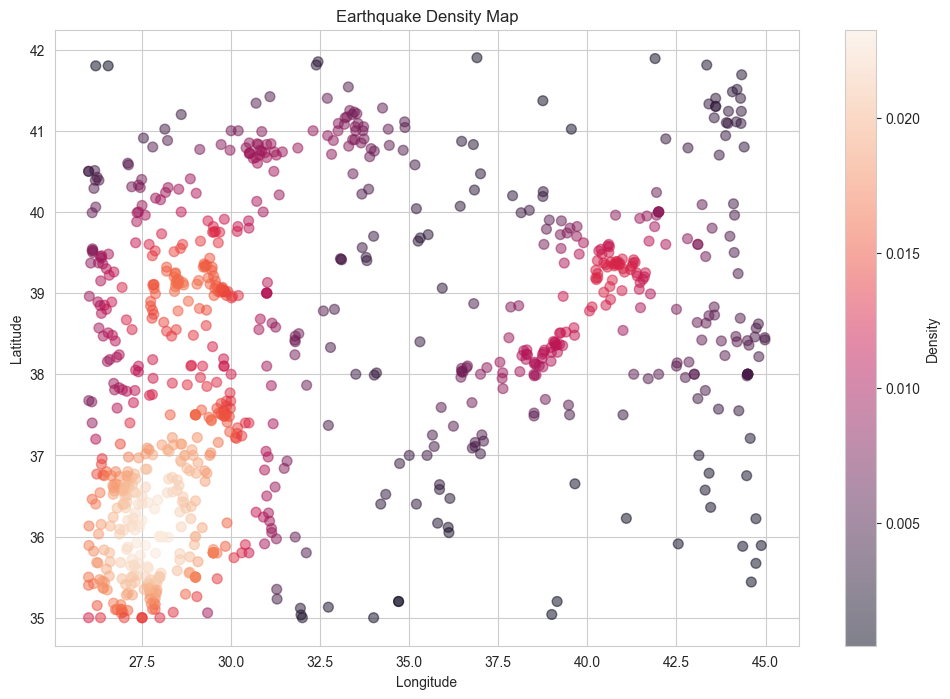

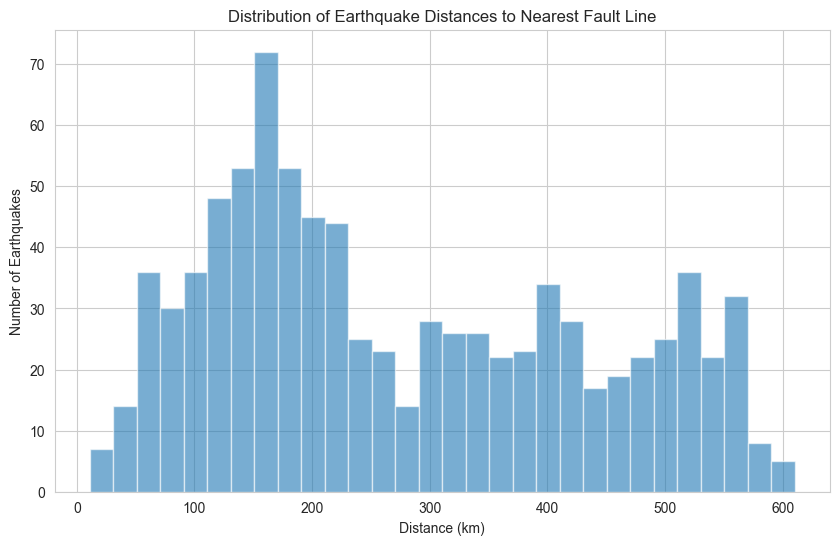

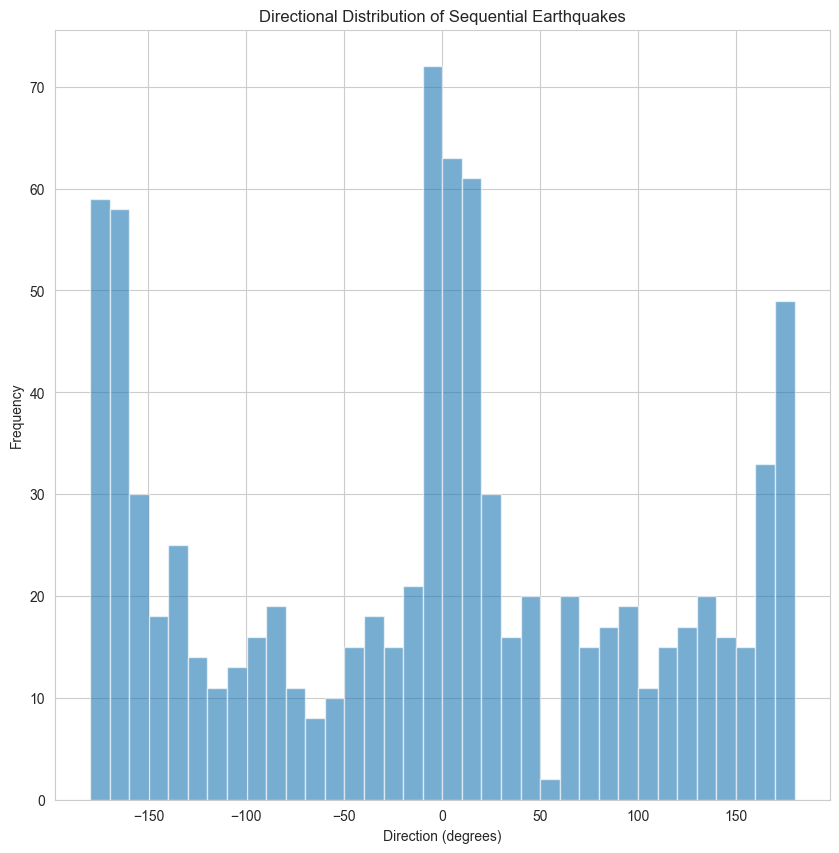

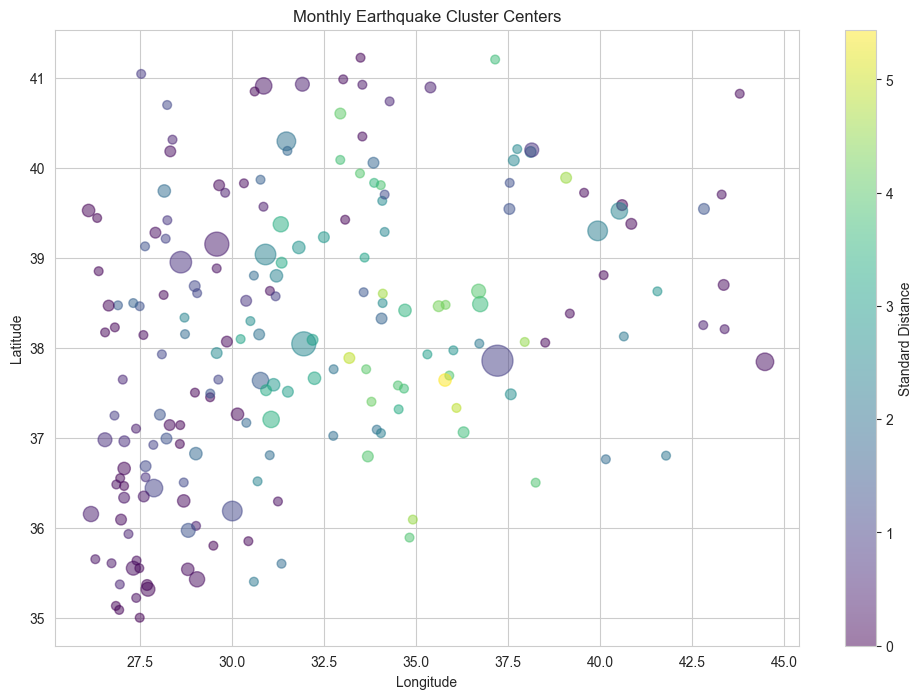


Spatial Statistics Summary:
Geographic Center: [42.8  38.25]
Standard Distance: [0.3  0.55]
Spatial Extent: [0.6 1.1]


In [67]:
import numpy as np
from scipy.spatial import distance
from scipy.stats import gaussian_kde
import matplotlib.pyplot as plt

# 1. Nearest Neighbor Analysis
def calculate_nearest_neighbor(points):
    distances = []
    for i, point1 in enumerate(points):
        other_points = np.delete(points, i, axis=0)
        min_distance = min(distance.euclidean(point1, point2) for point2 in other_points)
        distances.append(min_distance)
    return np.mean(distances)

coordinates = major_quakes[['Boylam', 'Enlem']].values
avg_nearest_distance = calculate_nearest_neighbor(coordinates)

print("Spatial Statistics:")
print(f"Average nearest neighbor distance: {avg_nearest_distance:.2f} degrees")

# 2. Spatial Density Analysis
x = major_quakes['Boylam']
y = major_quakes['Enlem']
xy = np.vstack([x, y])
z = gaussian_kde(xy)(xy)

plt.figure(figsize=(12, 8))
plt.scatter(x, y, c=z, s=50, alpha=0.5)
plt.colorbar(label='Density')
plt.title('Earthquake Density Map')
plt.xlabel('Longitude')
plt.ylabel('Latitude')
plt.grid(True)
plt.show()

# 3. Distance Analysis to Fault Lines
# Approximate coordinates of major fault lines in Turkey
fault_points = np.array([
    [26, 40], # North Anatolian Fault start
    [30, 40.5],
    [34, 41],
    [38, 40.5],
    [42, 39], # North Anatolian Fault end
    [35, 38], # East Anatolian Fault
    [38, 37],
    [41, 36]
])

# Function to convert degrees to kilometers
def degrees_to_km(degrees):
    return degrees * 111.32

distances_to_fault = []
for _, quake in major_quakes.iterrows():
    quake_point = np.array([quake['Boylam'], quake['Enlem']])
    min_distance = min(distance.euclidean(quake_point, fault_point) 
                      for fault_point in fault_points)
    distances_to_fault.append(degrees_to_km(min_distance))

plt.figure(figsize=(10, 6))
plt.hist(distances_to_fault, bins=30, alpha=0.6)
plt.title('Distribution of Earthquake Distances to Nearest Fault Line')
plt.xlabel('Distance (km)')
plt.ylabel('Number of Earthquakes')
plt.grid(True)
plt.show()

# 4. Directional Analysis
def calculate_direction(point1, point2):
    return np.degrees(np.arctan2(point2[1] - point1[1], point2[0] - point1[0]))

directions = []
for i in range(len(coordinates)-1):
    direction = calculate_direction(coordinates[i], coordinates[i+1])
    directions.append(direction)

plt.figure(figsize=(10, 10))
plt.hist(directions, bins=36, alpha=0.6)
plt.title('Directional Distribution of Sequential Earthquakes')
plt.xlabel('Direction (degrees)')
plt.ylabel('Frequency')
plt.grid(True)
plt.show()

# 5. Temporal-Spatial Clustering
major_quakes['YearMonth'] = pd.to_datetime(major_quakes['Olus tarihi']).dt.to_period('M')
temporal_spatial_clusters = {}

for year_month in major_quakes['YearMonth'].unique():
    month_earthquakes = major_quakes[major_quakes['YearMonth'] == year_month]
    if len(month_earthquakes) > 1:
        coordinates = month_earthquakes[['Boylam', 'Enlem']].values
        center = coordinates.mean(axis=0)
        std_distance = np.std(coordinates, axis=0)
        temporal_spatial_clusters[year_month] = {
            'count': len(month_earthquakes),
            'center': center,
            'std_distance': np.mean(std_distance)
        }

# Plot temporal-spatial cluster centers
plt.figure(figsize=(12, 8))
centers = np.array([cluster['center'] for cluster in temporal_spatial_clusters.values()])
counts = np.array([cluster['count'] for cluster in temporal_spatial_clusters.values()])

plt.scatter(centers[:, 0], centers[:, 1], 
           s=counts*20, alpha=0.5, 
           c=[cluster['std_distance'] for cluster in temporal_spatial_clusters.values()],
           cmap='viridis')
plt.colorbar(label='Standard Distance')
plt.title('Monthly Earthquake Cluster Centers')
plt.xlabel('Longitude')
plt.ylabel('Latitude')
plt.grid(True)
plt.show()

# 6. Calculate spatial statistics
print("\nSpatial Statistics Summary:")
print("===========================")
print(f"Geographic Center: {coordinates.mean(axis=0)}")
print(f"Standard Distance: {np.std(coordinates, axis=0)}")
print(f"Spatial Extent: {coordinates.max(axis=0) - coordinates.min(axis=0)}")

In [68]:
# Bu kod parçası deprem verilerini harita üzerinde görselleştiriyor ve fay hatlarıyla ilişkisini analiz ediyor.

# 1. Harita Oluşturma ve Fay Hatları
# - Türkiye'nin ana fay hatlarının koordinatları tanımlanıyor (NAFZ, EAFZ, Ege Grabeni vs.)
# - Folium kütüphanesi kullanılarak interaktif bir harita oluşturuluyor
# - Fay hatları kırmızı kesikli çizgilerle haritaya ekleniyor

# 2. Depremlerin Görselleştirilmesi  
# - Büyük depremler (M5+) haritaya daire şeklinde işaretleniyor
# - Büyüklüğe göre renk kodlaması yapılıyor:
# Define major fault lines of Turkey (with detailed coordinates)
fault_lines = [
    # North Anatolian Fault Zone (NAFZ)
    [[40.70, 27.00], [40.85, 29.00], [41.00, 31.00], [41.10, 33.00], 
     [40.95, 35.00], [40.80, 37.00], [40.60, 39.00], [40.40, 41.00]],
    
    # East Anatolian Fault Zone (EAFZ)  
    [[38.40, 38.00], [38.20, 38.50], [37.90, 39.00], [37.60, 39.50], 
     [37.30, 40.00], [37.10, 40.50], [36.90, 41.00]],
    
    # Aegean Graben System
    [[38.50, 26.80], [38.30, 27.20], [38.10, 27.80], [37.90, 28.50], 
     [37.70, 29.20], [37.50, 29.80]],
    
    # Western Anatolian Fault Zone
    [[38.20, 27.00], [38.00, 28.00], [37.80, 29.00], [37.60, 30.00]],
    
    # Salt Lake Fault Zone
    [[39.20, 33.00], [38.80, 33.20], [38.40, 33.40], [38.00, 33.60]]
]

# Create map
m = folium.Map(location=[39.0, 35.0], zoom_start=6)

# Add fault lines
for fault in fault_lines:
    folium.PolyLine(
        locations=fault,
        weight=3,
        color='red',
        opacity=0.8,
        popup='Major Fault Line',
        dash_array='10'  # Dashed line
    ).add_to(m)

# Add earthquakes magnitude 5 and above
for idx, row in major_quakes.iterrows():
    magnitude = row['xM']
    color = 'yellow' if magnitude < 6 else ('orange' if magnitude < 7 else 'red')
    
    folium.CircleMarker(
        location=[row['Enlem'], row['Boylam']],
        radius=magnitude*1.5,
        popup=f"Date: {row['Olus tarihi']}<br>"
              f"Magnitude: {magnitude:.1f}<br>"
              f"Depth: {row['Derinlik']}km",
        color=color,
        fill=True,
        fill_color=color,
        fill_opacity=0.7,
        weight=2
    ).add_to(m)

# Add heatmap layer
heat_data = [[row['Enlem'], row['Boylam']] for idx, row in major_quakes.iterrows()]
plugins.HeatMap(heat_data, name='Heat Map').add_to(m)

# Add legend
legend_html = '''
<div style="position: fixed; 
            bottom: 50px; left: 50px; width: 150px; height: 90px; 
            border:2px solid grey; z-index:9999; background-color:white;
            opacity:0.8;
            font-size:12px;
            padding: 10px">
            <b>Magnitude Scale</b><br>
            <i class="fa fa-circle" style="color:yellow"></i> 5.0 - 5.9<br>
            <i class="fa fa-circle" style="color:orange"></i> 6.0 - 6.9<br>
            <i class="fa fa-circle" style="color:red"></i> 7.0+
</div>
'''
m.get_root().html.add_child(folium.Element(legend_html))

# Add layer control
folium.LayerControl().add_to(m)

# Display map
display(m)

# Fault proximity analysis
def calculate_fault_distance(point, fault_lines):
    min_dist = float('inf')
    for fault in fault_lines:
        for i in range(len(fault)-1):
            p1 = fault[i]
            p2 = fault[i+1]
            dist = abs((p2[0]-p1[0])*(p1[1]-point[1]) - (p1[0]-point[0])*(p2[1]-p1[1])) / \
                   ((p2[0]-p1[0])**2 + (p2[1]-p1[1])**2)**0.5
            min_dist = min(min_dist, dist)
    return min_dist

# Statistical analysis
distances = []
for _, quake in major_quakes.iterrows():
    dist = calculate_fault_distance([quake['Enlem'], quake['Boylam']], fault_lines)
    distances.append(dist)

major_quakes['Fault_Distance'] = distances

print("\nFault Proximity Analysis:")
print("================================")
print(f"Total number of analyzed earthquakes: {len(major_quakes)}")
print(f"Number of earthquakes within 0.5 degrees of fault lines: {len(major_quakes[major_quakes['Fault_Distance'] < 0.5])}")
print(f"Average distance to nearest fault line: {np.mean(distances):.2f} degrees")
print(f"Percentage of earthquakes near fault lines: {len(major_quakes[major_quakes['Fault_Distance'] < 0.5])/len(major_quakes)*100:.1f}%")


Fault Proximity Analysis:
Total number of analyzed earthquakes: 873
Number of earthquakes within 0.5 degrees of fault lines: 336
Average distance to nearest fault line: 0.94 degrees
Percentage of earthquakes near fault lines: 38.5%


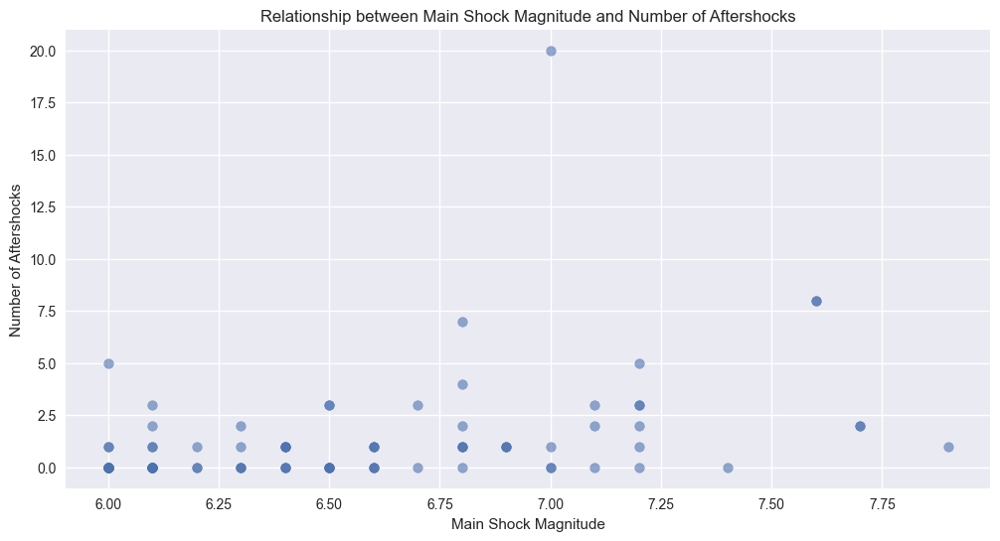

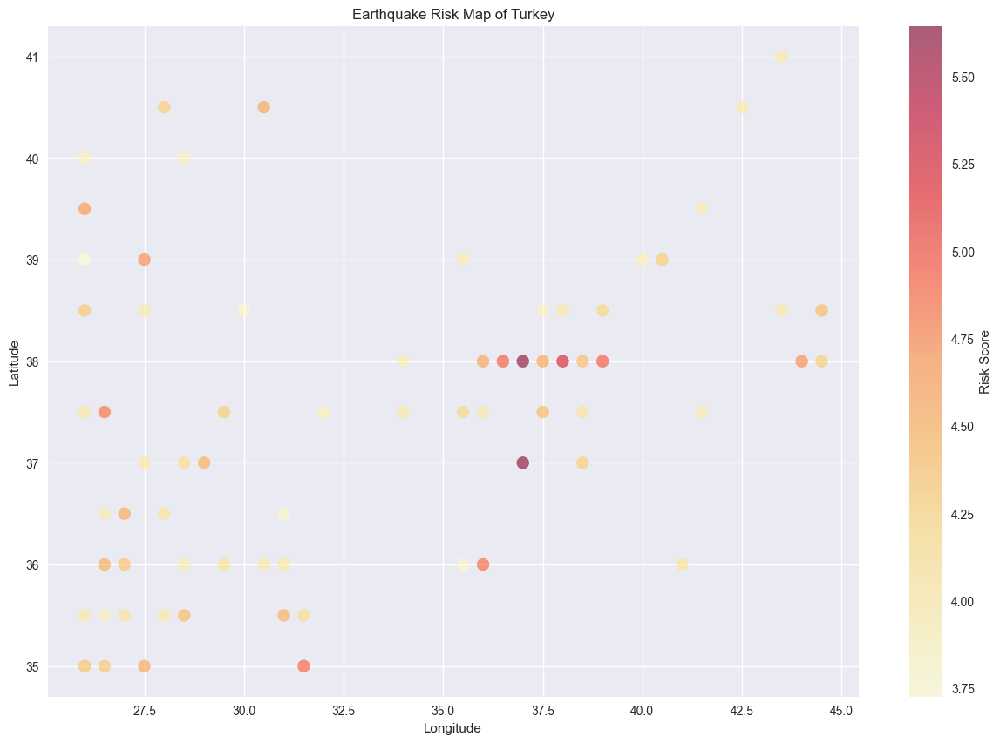


Aftershock Analysis:
Average number of aftershocks per M6+ event: 1.3
Maximum number of aftershocks observed: 20
Percentage of events with foreshocks: 13.8%

Risk Analysis:
High Risk Areas (top 5):
Location: 37.00N, 37.00E, Risk Score: 5.64
Location: 38.00N, 37.00E, Risk Score: 5.62
Location: 38.00N, 38.00E, Risk Score: 5.25
Location: 38.00N, 39.00E, Risk Score: 4.95
Location: 38.00N, 36.50E, Risk Score: 4.95


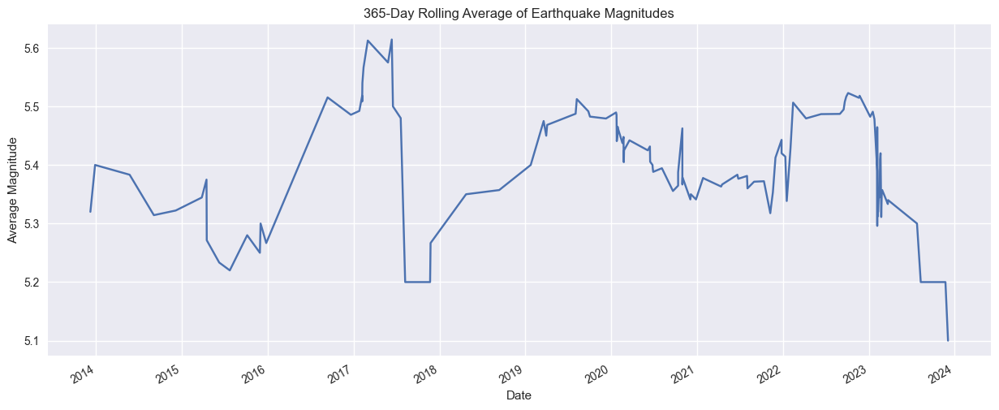

In [69]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
from datetime import timedelta
from scipy.stats import gaussian_kde

# 1. Foreshock/Aftershock Analysis
def analyze_sequence(main_quake, all_quakes, days_before=30, days_after=90, distance_km=100):
    """
    Analyzes foreshocks and aftershocks for a main earthquake
    """
    main_date = pd.to_datetime(main_quake['Olus tarihi'])
    start_date = main_date - pd.Timedelta(days=days_before)
    end_date = main_date + pd.Timedelta(days=days_after)
    
    # Filter earthquakes within time window
    sequence = all_quakes[
        (pd.to_datetime(all_quakes['Olus tarihi']) >= start_date) & 
        (pd.to_datetime(all_quakes['Olus tarihi']) <= end_date)
    ].copy()
    
    # Calculate distance from main earthquake
    def calculate_distance(row):
        R = 6371  # Earth's radius (km)
        lat1, lon1 = np.radians(main_quake['Enlem']), np.radians(main_quake['Boylam'])
        lat2, lon2 = np.radians(row['Enlem']), np.radians(row['Boylam'])
        
        dlat = lat2 - lat1
        dlon = lon2 - lon1
        
        a = np.sin(dlat/2)**2 + np.cos(lat1) * np.cos(lat2) * np.sin(dlon/2)**2
        c = 2 * np.arctan2(np.sqrt(a), np.sqrt(1-a))
        return R * c
    
    sequence['Distance'] = sequence.apply(calculate_distance, axis=1)
    sequence = sequence[sequence['Distance'] <= distance_km]
    
    # Separate foreshocks and aftershocks
    foreshocks = sequence[pd.to_datetime(sequence['Olus tarihi']) < main_date]
    aftershocks = sequence[pd.to_datetime(sequence['Olus tarihi']) > main_date]
    
    return foreshocks, aftershocks

# Select major earthquakes (M6.0+)
major_events = major_quakes[major_quakes['xM'] >= 6.0].copy()

# Analyze each major earthquake
sequence_stats = []
for idx, main_quake in major_events.iterrows():
    foreshocks, aftershocks = analyze_sequence(main_quake, major_quakes)
    
    stats = {
        'Main_Date': pd.to_datetime(main_quake['Olus tarihi']),
        'Main_Magnitude': main_quake['xM'],
        'Foreshock_Count': len(foreshocks),
        'Aftershock_Count': len(aftershocks),
        'Max_Foreshock': foreshocks['xM'].max() if not foreshocks.empty else None,
        'Max_Aftershock': aftershocks['xM'].max() if not aftershocks.empty else None,
        'Latitude': main_quake['Enlem'],
        'Longitude': main_quake['Boylam']
    }
    sequence_stats.append(stats)

sequence_df = pd.DataFrame(sequence_stats)

# 2. Risk Analysis
def calculate_risk_score(group):
    """
    Calculate risk score based on:
    - Earthquake frequency
    - Average magnitude
    - Maximum magnitude
    - Aftershock density
    """
    freq_score = len(group) / (group['Olus tarihi'].dt.year.max() - group['Olus tarihi'].dt.year.min() + 1)
    mag_score = group['xM'].mean()
    max_score = group['xM'].max()
    
    return (freq_score * 0.3 + 
            mag_score * 0.3 + 
            max_score * 0.4)

# Create regional grid
major_quakes['Grid_Lat'] = np.floor(major_quakes['Enlem'] * 2) / 2
major_quakes['Grid_Lon'] = np.floor(major_quakes['Boylam'] * 2) / 2

# Convert Olus tarihi to datetime if not already
major_quakes['Olus tarihi'] = pd.to_datetime(major_quakes['Olus tarihi'])

# Last 10 years of data
recent_quakes = major_quakes[
    major_quakes['Olus tarihi'] >= major_quakes['Olus tarihi'].max() - pd.Timedelta(days=3650)
]

# Calculate risk scores
risk_scores = recent_quakes.groupby(['Grid_Lat', 'Grid_Lon']).apply(calculate_risk_score)
risk_df = pd.DataFrame(risk_scores).reset_index()
risk_df.columns = ['Latitude', 'Longitude', 'Risk_Score']

# Visualizations
plt.style.use('seaborn-v0_8')  # Using updated seaborn style name

# 1. Aftershock Analysis Plot
plt.figure(figsize=(12, 6))
plt.scatter(sequence_df['Main_Magnitude'], 
           sequence_df['Aftershock_Count'],
           alpha=0.6)
plt.title('Relationship between Main Shock Magnitude and Number of Aftershocks')
plt.xlabel('Main Shock Magnitude')
plt.ylabel('Number of Aftershocks')
plt.grid(True)
plt.show()

# 2. Risk Map
plt.figure(figsize=(15, 10))
plt.scatter(risk_df['Longitude'], 
           risk_df['Latitude'],
           c=risk_df['Risk_Score'],
           s=100,
           cmap='YlOrRd',
           alpha=0.6)
plt.colorbar(label='Risk Score')
plt.title('Earthquake Risk Map of Turkey')
plt.xlabel('Longitude')
plt.ylabel('Latitude')
plt.grid(True)
plt.show()

# Statistics and Results
print("\nAftershock Analysis:")
print("===================")
print(f"Average number of aftershocks per M6+ event: {sequence_df['Aftershock_Count'].mean():.1f}")
print(f"Maximum number of aftershocks observed: {sequence_df['Aftershock_Count'].max()}")
print(f"Percentage of events with foreshocks: {(sequence_df['Foreshock_Count'] > 0).mean()*100:.1f}%")

print("\nRisk Analysis:")
print("=============")
print("High Risk Areas (top 5):")
high_risk = risk_df.nlargest(5, 'Risk_Score')
for idx, row in high_risk.iterrows():
    print(f"Location: {row['Latitude']:.2f}N, {row['Longitude']:.2f}E, Risk Score: {row['Risk_Score']:.2f}")

# 3. Temporal Risk Analysis
plt.figure(figsize=(15, 6))
recent_quakes.set_index('Olus tarihi')['xM'].rolling('365D').mean().plot()
plt.title('365-Day Rolling Average of Earthquake Magnitudes')
plt.xlabel('Date')
plt.ylabel('Average Magnitude')
plt.grid(True)
plt.show()

In [70]:
import folium
from folium import plugins
import numpy as np
from branca.colormap import LinearColormap

# Normalize risk scores between 0-1
risk_df['Risk_Score_Normalized'] = (risk_df['Risk_Score'] - risk_df['Risk_Score'].min()) / \
                                  (risk_df['Risk_Score'].max() - risk_df['Risk_Score'].min())

# Create map
m = folium.Map(location=[39.0, 35.0], zoom_start=6)

# Create custom colormap
colormap = LinearColormap(
    colors=['green', 'yellow', 'orange', 'red'],
    vmin=risk_df['Risk_Score'].min(),
    vmax=risk_df['Risk_Score'].max(),
    caption='Earthquake Risk Score'
)

# Add risk points
for idx, row in risk_df.iterrows():
    # Determine color based on risk score
    color = colormap(row['Risk_Score'])
    
    # Determine risk level
    if row['Risk_Score_Normalized'] < 0.25:
        risk_level = "Low"
    elif row['Risk_Score_Normalized'] < 0.5:
        risk_level = "Moderate"
    elif row['Risk_Score_Normalized'] < 0.75:
        risk_level = "High"
    else:
        risk_level = "Very High"
    
    # Add circle marker
    folium.CircleMarker(
        location=[row['Latitude'], row['Longitude']],
        radius=15,
        popup=f"Risk Score: {row['Risk_Score']:.2f}<br>"
              f"Risk Level: {risk_level}",
        color=color,
        fill=True,
        fill_color=color,
        fill_opacity=0.7,
        weight=2
    ).add_to(m)

# Add fault lines
fault_lines = [
    # North Anatolian Fault Zone (NAFZ)
    [[40.70, 27.00], [40.85, 29.00], [41.00, 31.00], [41.10, 33.00], 
     [40.95, 35.00], [40.80, 37.00], [40.60, 39.00], [40.40, 41.00]],
    
    # East Anatolian Fault Zone (EAFZ)
    [[38.40, 38.00], [38.20, 38.50], [37.90, 39.00], [37.60, 39.50], 
     [37.30, 40.00], [37.10, 40.50], [36.90, 41.00]],
    
    # Aegean Graben System
    [[38.50, 26.80], [38.30, 27.20], [38.10, 27.80], [37.90, 28.50], 
     [37.70, 29.20], [37.50, 29.80]]
]

# Add fault lines to map
for fault in fault_lines:
    folium.PolyLine(
        locations=fault,
        weight=2,
        color='black',
        opacity=0.8,
        popup='Fault Line',
        dash_array='10'
    ).add_to(m)

# Add heatmap layer
heat_data = [[row['Latitude'], row['Longitude'], row['Risk_Score']] 
             for idx, row in risk_df.iterrows()]
plugins.HeatMap(heat_data, name='Heat Map').add_to(m)

# Add colormap to map
colormap.add_to(m)

# Add layer control
folium.LayerControl().add_to(m)

# Add legend
legend_html = '''
<div style="position: fixed; 
            bottom: 50px; left: 50px; width: 150px; height: 120px; 
            border:2px solid grey; z-index:9999; background-color:white;
            opacity:0.8;
            font-size:12px;
            padding: 10px">
            <b>Risk Levels</b><br>
            <i class="fa fa-circle" style="color:red"></i> Very High<br>
            <i class="fa fa-circle" style="color:orange"></i> High<br>
            <i class="fa fa-circle" style="color:yellow"></i> Moderate<br>
            <i class="fa fa-circle" style="color:green"></i> Low
</div>
'''
m.get_root().html.add_child(folium.Element(legend_html))

# Display map
display(m)

# Print risk statistics
print("\nRisk Analysis Statistics:")
print("=======================")
risk_levels = pd.cut(risk_df['Risk_Score_Normalized'], 
                    bins=[0, 0.25, 0.5, 0.75, 1],
                    labels=['Low', 'Moderate', 'High', 'Very High'])
risk_distribution = risk_levels.value_counts()
print("\nRisk Level Distribution:")
for level, count in risk_distribution.items():
    print(f"{level}: {count} regions ({count/len(risk_df)*100:.1f}%)")

print("\nTop 5 Highest Risk Regions:")
top_risks = risk_df.nlargest(5, 'Risk_Score')
for idx, row in top_risks.iterrows():
    print(f"Location: {row['Latitude']:.2f}N, {row['Longitude']:.2f}E")
    print(f"Risk Score: {row['Risk_Score']:.2f}")


Risk Analysis Statistics:

Risk Level Distribution:
Low: 35 regions (50.0%)
Moderate: 24 regions (34.3%)
High: 7 regions (10.0%)
Very High: 3 regions (4.3%)

Top 5 Highest Risk Regions:
Location: 37.00N, 37.00E
Risk Score: 5.64
Location: 38.00N, 37.00E
Risk Score: 5.62
Location: 38.00N, 38.00E
Risk Score: 5.25
Location: 38.00N, 39.00E
Risk Score: 4.95
Location: 38.00N, 36.50E
Risk Score: 4.95


In [71]:
import folium
from folium import plugins
import numpy as np
from branca.colormap import LinearColormap

def calculate_enhanced_risk_score(group):
    """
    Calculate enhanced risk score based on:
    - Historical earthquakes
    - Seismic characteristics of the region
    """
    # Basic earthquake score
    freq_score = len(group)
    mag_score = group['xM'].mean() 
    max_score = group['xM'].max()
    basic_score = (freq_score * 0.3 + mag_score * 0.3 + max_score * 0.4)
    
    # Center coordinates
    center_lat = group['Enlem'].iloc[0]
    center_lon = group['Boylam'].iloc[0]
    
    # Known high risk zones
    high_risk_zones = {
        'Istanbul': {'lat': 41.0082, 'lon': 28.9784, 'radius': 0.5},
        'Izmir': {'lat': 38.4189, 'lon': 27.1287, 'radius': 0.4}, 
        'Marmara': {'lat': 40.8, 'lon': 29.0, 'radius': 0.6},
        'Van': {'lat': 38.5012, 'lon': 43.3736, 'radius': 0.4},
        'Bingol': {'lat': 38.8850, 'lon': 40.4983, 'radius': 0.4}
    }
    
    # Check proximity to high risk zones
    zone_score = 0
    for zone in high_risk_zones.values():
        dist = np.sqrt((center_lat - zone['lat'])**2 + (center_lon - zone['lon'])**2)
        if dist <= zone['radius']:
            zone_score = 1
            break
            
    # Calculate final risk score
    final_score = (basic_score * 0.7 + zone_score * 0.3)
    
    return final_score

# Create grid and calculate risk scores
risk_scores = []
lat_range = np.arange(36, 42.5, 0.5)
lon_range = np.arange(26, 45, 0.5)

for lat in lat_range:
    for lon in lon_range:
        # Filter earthquakes in this grid point
        grid_quakes = df[
            (df['Enlem'] >= lat - 0.25) &
            (df['Enlem'] < lat + 0.25) &
            (df['Boylam'] >= lon - 0.25) &
            (df['Boylam'] < lon + 0.25)
        ]
        
        if len(grid_quakes) > 0:
            grid_quakes['Grid_Lat'] = lat
            grid_quakes['Grid_Lon'] = lon
            risk_score = calculate_enhanced_risk_score(grid_quakes)
            
            risk_scores.append({
                'Latitude': lat,
                'Longitude': lon,
                'Risk_Score': risk_score
            })

risk_df = pd.DataFrame(risk_scores)

# Create map
m = folium.Map(location=[39.0, 35.0], zoom_start=6)

# Color map
colormap = LinearColormap(
    colors=['green', 'yellow', 'orange', 'red'],
    vmin=risk_df['Risk_Score'].min(),
    vmax=risk_df['Risk_Score'].max(),
    caption='Enhanced Earthquake Risk Score'
)

# Add risk points
for idx, row in risk_df.iterrows():
    color = colormap(row['Risk_Score'])
    
    folium.CircleMarker(
        location=[row['Latitude'], row['Longitude']],
        radius=15,
        popup=f"Risk Score: {row['Risk_Score']:.2f}",
        color=color,
        fill=True,
        fill_color=color,
        fill_opacity=0.7,
        weight=2
    ).add_to(m)

# Add color scale and controls
colormap.add_to(m)
folium.LayerControl().add_to(m)

# Display map
display(m)

# Print highest risk regions
print("\nTop 10 Highest Risk Regions:")
top_risks = risk_df.nlargest(10, 'Risk_Score')
for idx, row in top_risks.iterrows():
    print(f"Location: {row['Latitude']:.2f}N, {row['Longitude']:.2f}E")
    print(f"Risk Score: {row['Risk_Score']:.2f}")

C:\Users\İSAILICA\AppData\Local\Temp\ipykernel_12860\1586399339.py:60: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  grid_quakes['Grid_Lat'] = lat
C:\Users\İSAILICA\AppData\Local\Temp\ipykernel_12860\1586399339.py:61: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  grid_quakes['Grid_Lon'] = lon
C:\Users\İSAILICA\AppData\Local\Temp\ipykernel_12860\1586399339.py:60: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead


Top 10 Highest Risk Regions:
Location: 36.50N, 27.00E
Risk Score: 91.59
Location: 38.00N, 36.50E
Risk Score: 80.00
Location: 37.00N, 27.50E
Risk Score: 78.89
Location: 38.00N, 27.00E
Risk Score: 78.72
Location: 39.00N, 43.50E
Risk Score: 71.51
Location: 39.00N, 28.00E
Risk Score: 63.39
Location: 36.00N, 27.00E
Risk Score: 61.98
Location: 37.00N, 28.00E
Risk Score: 58.70
Location: 39.00N, 29.00E
Risk Score: 58.33
Location: 38.00N, 26.50E
Risk Score: 55.87


In [89]:
import pandas as pd
import numpy as np
from sklearn.model_selection import train_test_split, GridSearchCV
from sklearn.ensemble import RandomForestRegressor, GradientBoostingRegressor
from sklearn.svm import SVR
from sklearn.preprocessing import StandardScaler
from sklearn.metrics import mean_squared_error, mean_absolute_error, r2_score
import matplotlib.pyplot as plt
from datetime import datetime
from geopy.distance import geodesic
from sklearn.linear_model import LinearRegression, Ridge, Lasso, ElasticNet, BayesianRidge
from sklearn.preprocessing import PolynomialFeatures
from sklearn.tree import DecisionTreeRegressor
from sklearn.feature_selection import RFE
from sklearn.linear_model import LinearRegression
from sklearn.pipeline import Pipeline

# Data cleaning and preparation
major_quakes = major_quakes.copy()
major_quakes = major_quakes.dropna(subset=['Olus tarihi', 'xM'])
major_quakes = major_quakes.reset_index(drop=True)

# Enhance date features
major_quakes['Olus tarihi'] = pd.to_datetime(major_quakes['Olus tarihi'])
major_quakes['Year'] = major_quakes['Olus tarihi'].dt.year
major_quakes['Month'] = major_quakes['Olus tarihi'].dt.month
major_quakes['Day'] = major_quakes['Olus tarihi'].dt.day
major_quakes['DayOfWeek'] = major_quakes['Olus tarihi'].dt.dayofweek
major_quakes['WeekOfYear'] = major_quakes['Olus tarihi'].dt.isocalendar().week
major_quakes['IsWeekend'] = major_quakes['DayOfWeek'].isin([5,6]).astype(int)
major_quakes['Season'] = pd.cut(major_quakes['Month'], 
                               bins=[0,3,6,9,12], 
                               labels=['Winter','Spring','Summer','Fall'])

# Previous earthquake features
def get_previous_features(df, windows=[365, 730, 1095]):  # Changed to yearly windows
    df = df.sort_values('Olus tarihi')
    features = pd.DataFrame()
    
    for window in windows:
        prev_mags = df['xM'].rolling(window=window, min_periods=1).mean().shift()
        prev_depths = df['Derinlik'].rolling(window=window, min_periods=1).mean().shift()
        prev_count = df['xM'].rolling(window=window, min_periods=1).count().shift()
        prev_max = df['xM'].rolling(window=window, min_periods=1).max().shift()
        prev_min = df['xM'].rolling(window=window, min_periods=1).min().shift()
        
        features[f'Prev_{window}d_Magnitude'] = prev_mags.fillna(df['xM'].mean())
        features[f'Prev_{window}d_Depth'] = prev_depths.fillna(df['Derinlik'].mean())
        features[f'Prev_{window}d_Count'] = prev_count.fillna(0)
        features[f'Prev_{window}d_MaxMag'] = prev_max.fillna(df['xM'].max())
        features[f'Prev_{window}d_MinMag'] = prev_min.fillna(df['xM'].min())
        
    return features

prev_features = get_previous_features(major_quakes)

# Calculate distance between earthquakes
def calculate_distance_features(df):
    df = df.sort_values('Olus tarihi')
    distances = []
    for i in range(len(df)):
        if i == 0:
            distances.append(0)
        else:
            prev_coords = (df.iloc[i-1]['Enlem'], df.iloc[i-1]['Boylam'])
            curr_coords = (df.iloc[i]['Enlem'], df.iloc[i]['Boylam'])
            distance = geodesic(prev_coords, curr_coords).kilometers
            distances.append(distance)
    return pd.Series(distances, name='Distance_From_Previous')

distance_features = calculate_distance_features(major_quakes)

# Combine features
features = pd.concat([
    major_quakes[['Year', 'Month', 'Day', 'Enlem', 'Boylam', 'Derinlik']].rename(
        columns={'Enlem': 'Latitude', 'Boylam': 'Longitude', 'Derinlik': 'Depth'}),
    prev_features,
    pd.get_dummies(major_quakes['Season'], prefix='Season'),
    pd.DataFrame({
        'DayOfWeek': major_quakes['DayOfWeek'],
        'IsWeekend': major_quakes['IsWeekend'],
        'Distance_From_Previous': distance_features
    })
], axis=1)

# Prepare data for modeling
X = features.fillna(features.mean())
y = major_quakes['xM'].fillna(major_quakes['xM'].mean())

X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

scaler = StandardScaler()
X_train_scaled = scaler.fit_transform(X_train)
X_test_scaled = scaler.transform(X_test)

# Define models with parameter grids for GridSearchCV
model_params = {
    'Random Forest': {
        'model': RandomForestRegressor(random_state=42, n_jobs=-1),
        'params': {
            'n_estimators': [100, 200, 300],
            'max_depth': [20, 30, 40],
            'min_samples_split': [2, 5, 10],
            'min_samples_leaf': [1, 2, 4]
        }
    },
    'Gradient Boosting': {
        'model': GradientBoostingRegressor(random_state=42),
        'params': {
            'n_estimators': [100, 200, 300],
            'learning_rate': [0.01, 0.1, 0.3],
            'max_depth': [3, 5, 7],
            'subsample': [0.8, 0.9, 1.0]
        }
    },
    'SVR': {
        'model': SVR(),
        'params': {
            'kernel': ['rbf', 'linear'],
            'C': [0.1, 1.0, 10.0],
            'gamma': ['scale', 'auto', 0.1, 0.01]
        }
    },
    'Linear Regression': {
        'model': LinearRegression(),
        'params': {}
    },
    'Polynomial Regression': {
        'model': Pipeline([
            ('poly', PolynomialFeatures(degree=2)),
            ('linear', LinearRegression())
        ]),
        'params': {}
    },
    'Decision Tree': {
        'model': DecisionTreeRegressor(random_state=42),
        'params': {
            'max_depth': [5, 10, 15],
            'min_samples_split': [2, 5, 10]
        }
    },
    'Ridge': {
        'model': Ridge(random_state=42),
        'params': {
            'alpha': [0.1, 1.0, 10.0]
        }
    },
    'Lasso': {
        'model': Lasso(random_state=42),
        'params': {
            'alpha': [0.1, 1.0, 10.0]
        }
    },
    'ElasticNet': {
        'model': ElasticNet(random_state=42),
        'params': {
            'alpha': [0.1, 1.0, 10.0],
            'l1_ratio': [0.2, 0.5, 0.8]
        }
    },
    'Bayesian Ridge': {
        'model': BayesianRidge(),
        'params': {
            'alpha_1': [1e-6, 1e-5, 1e-4],
            'alpha_2': [1e-6, 1e-5, 1e-4]
        }
    }
}

# Train and evaluate each model with GridSearchCV
results = {}
print("\nModel Training and Performance Metrics:")
for name, model_info in model_params.items():
    print(f"\nTraining {name} with GridSearchCV...")
    grid_search = GridSearchCV(
        model_info['model'],
        model_info['params'],
        cv=5,
        scoring='r2',
        n_jobs=-1,
        verbose=1
    )
    
    grid_search.fit(X_train_scaled, y_train)
    y_pred = grid_search.predict(X_test_scaled)
    
    results[name] = {
        'best_params': grid_search.best_params_,
        'best_score': grid_search.best_score_,
        'R2': r2_score(y_test, y_pred),
        'MSE': mean_squared_error(y_test, y_pred),
        'RMSE': np.sqrt(mean_squared_error(y_test, y_pred)),
        'MAE': mean_absolute_error(y_test, y_pred)
    }

# Create performance metrics table
metrics_df = pd.DataFrame({
    'R2 Score': [results[model]['R2'] for model in model_params.keys()],
    'MSE': [results[model]['MSE'] for model in model_params.keys()],
    'RMSE': [results[model]['RMSE'] for model in model_params.keys()],
    'MAE': [results[model]['MAE'] for model in model_params.keys()]
}, index=model_params.keys())

print("\nModel Performance Metrics Table:")
print(metrics_df.round(4))

# Select best performing model
best_model_name = max(results, key=lambda k: results[k]['R2'])
best_model = model_params[best_model_name]['model'].set_params(**results[best_model_name]['best_params'])
best_model.fit(X_train_scaled, y_train)
print(f"\nBest performing model: {best_model_name}")

# Cities for prediction
regions = {
    'Istanbul': {'lat': 41.0082, 'lon': 28.9784},
    'Izmir': {'lat': 38.4192, 'lon': 27.1287},
    'Ankara': {'lat': 39.9334, 'lon': 32.8597},
    'Van': {'lat': 38.4891, 'lon': 43.4089},
    'Erzincan': {'lat': 39.7500, 'lon': 39.5000},
    'Bursa': {'lat': 40.1885, 'lon': 29.0610},
    'Antalya': {'lat': 36.8969, 'lon': 30.7133},
    'Kahramanmaras': {'lat': 37.5858, 'lon': 36.9371}
}

print("\nYearly Earthquake Predictions (2024-2028):")
years = range(2024, 2029)
feature_columns = X.columns

for region, coords in regions.items():
    print(f"\n{region}:")
    for year in years:
        prediction_date = datetime(year, 7, 1)  # Mid-year point
        
        pred_features = pd.DataFrame(columns=feature_columns)
        
        base_features = {
            'Year': prediction_date.year,
            'Month': prediction_date.month,
            'Day': 1,
            'Latitude': coords['lat'],
            'Longitude': coords['lon'],
            'Depth': X['Depth'].mean(),
            'DayOfWeek': prediction_date.weekday(),
            'IsWeekend': 1 if prediction_date.weekday() >= 5 else 0,
            'Distance_From_Previous': 0
        }
        
        for col in prev_features.columns:
            base_features[col] = X[col].mean()
        
        season = pd.cut([prediction_date.month], bins=[0,3,6,9,12], labels=['Winter','Spring','Summer','Fall'])[0]
        for s in ['Winter', 'Spring', 'Summer', 'Fall']:
            base_features[f'Season_{s}'] = 1 if s == season else 0
            
        pred_features = pd.DataFrame([base_features])
        
        for col in feature_columns:
            if col not in pred_features.columns:
                pred_features[col] = 0
                
        pred_features = pred_features[feature_columns]
        pred_features_scaled = scaler.transform(pred_features)
        
        # Predict with all models
        predictions = {}
        for model_name, model_info in model_params.items():
            model = model_info['model'].set_params(**results[model_name]['best_params'])
            model.fit(X_train_scaled, y_train)
            predictions[model_name] = model.predict(pred_features_scaled)[0]
        
        # Average prediction
        avg_prediction = np.mean(list(predictions.values()))
        print(f"Year {year}:")
        for model_name, pred in predictions.items():
            print(f"  {model_name}: {pred:.2f}")
        print(f"  Average Prediction: {avg_prediction:.2f}")


Model Training and Performance Metrics:

Training Random Forest with GridSearchCV...
Fitting 5 folds for each of 81 candidates, totalling 405 fits

Training Gradient Boosting with GridSearchCV...
Fitting 5 folds for each of 81 candidates, totalling 405 fits

Training SVR with GridSearchCV...
Fitting 5 folds for each of 24 candidates, totalling 120 fits

Training Linear Regression with GridSearchCV...
Fitting 5 folds for each of 1 candidates, totalling 5 fits

Training Polynomial Regression with GridSearchCV...
Fitting 5 folds for each of 1 candidates, totalling 5 fits

Training Decision Tree with GridSearchCV...
Fitting 5 folds for each of 9 candidates, totalling 45 fits

Training Ridge with GridSearchCV...
Fitting 5 folds for each of 3 candidates, totalling 15 fits

Training Lasso with GridSearchCV...
Fitting 5 folds for each of 3 candidates, totalling 15 fits

Training ElasticNet with GridSearchCV...
Fitting 5 folds for each of 9 candidates, totalling 45 fits

Training Bayesian Ridg

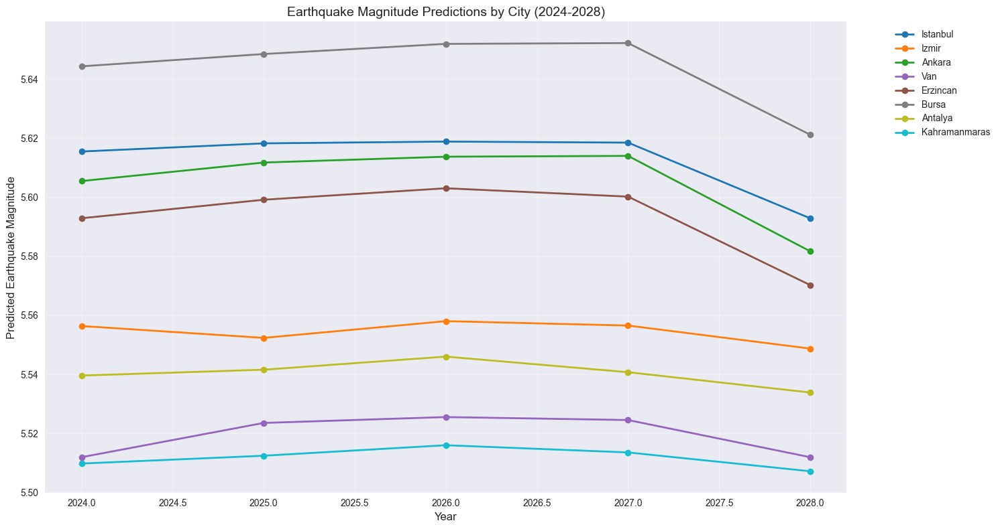

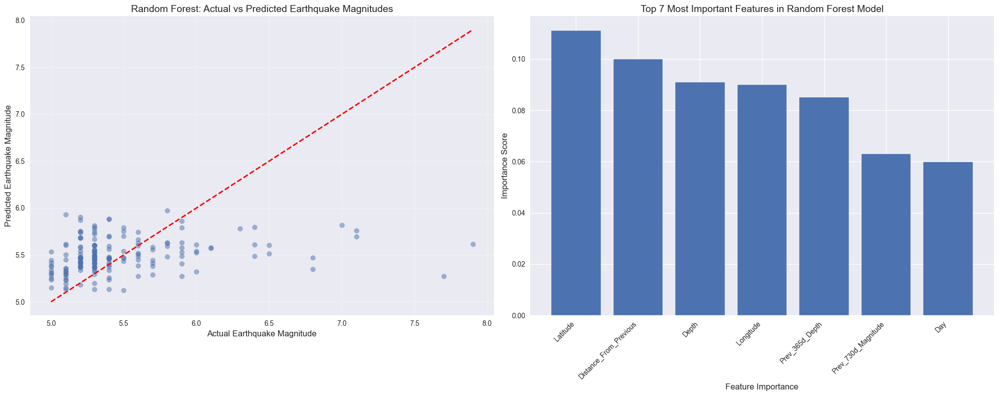

In [73]:
import pandas as pd
import numpy as np
from sklearn.model_selection import train_test_split, GridSearchCV
from sklearn.ensemble import RandomForestRegressor, GradientBoostingRegressor
from sklearn.svm import SVR
from sklearn.preprocessing import StandardScaler
from sklearn.metrics import mean_squared_error, mean_absolute_error, r2_score
import matplotlib.pyplot as plt
from datetime import datetime
from geopy.distance import geodesic

# Data cleaning and preparation
major_quakes = major_quakes.copy()
major_quakes = major_quakes.dropna(subset=['Olus tarihi', 'xM'])
major_quakes = major_quakes.reset_index(drop=True)

# Enhance date features
major_quakes['Olus tarihi'] = pd.to_datetime(major_quakes['Olus tarihi'])
major_quakes['Year'] = major_quakes['Olus tarihi'].dt.year
major_quakes['Month'] = major_quakes['Olus tarihi'].dt.month
major_quakes['Day'] = major_quakes['Olus tarihi'].dt.day
major_quakes['DayOfWeek'] = major_quakes['Olus tarihi'].dt.dayofweek
major_quakes['WeekOfYear'] = major_quakes['Olus tarihi'].dt.isocalendar().week
major_quakes['IsWeekend'] = major_quakes['DayOfWeek'].isin([5,6]).astype(int)
major_quakes['Season'] = pd.cut(major_quakes['Month'], 
                               bins=[0,3,6,9,12], 
                               labels=['Winter','Spring','Summer','Fall'])

# Previous earthquake features
def get_previous_features(df, windows=[365, 730, 1095]):
    df = df.sort_values('Olus tarihi')
    features = pd.DataFrame()
    
    for window in windows:
        prev_mags = df['xM'].rolling(window=window, min_periods=1).mean().shift()
        prev_depths = df['Derinlik'].rolling(window=window, min_periods=1).mean().shift()
        prev_count = df['xM'].rolling(window=window, min_periods=1).count().shift()
        prev_max = df['xM'].rolling(window=window, min_periods=1).max().shift()
        prev_min = df['xM'].rolling(window=window, min_periods=1).min().shift()
        
        features[f'Prev_{window}d_Magnitude'] = prev_mags.fillna(df['xM'].mean())
        features[f'Prev_{window}d_Depth'] = prev_depths.fillna(df['Derinlik'].mean())
        features[f'Prev_{window}d_Count'] = prev_count.fillna(0)
        features[f'Prev_{window}d_MaxMag'] = prev_max.fillna(df['xM'].max())
        features[f'Prev_{window}d_MinMag'] = prev_min.fillna(df['xM'].min())
        
    return features

prev_features = get_previous_features(major_quakes)

# Calculate distance between earthquakes
def calculate_distance_features(df):
    df = df.sort_values('Olus tarihi')
    distances = []
    for i in range(len(df)):
        if i == 0:
            distances.append(0)
        else:
            prev_coords = (df.iloc[i-1]['Enlem'], df.iloc[i-1]['Boylam'])
            curr_coords = (df.iloc[i]['Enlem'], df.iloc[i]['Boylam'])
            distance = geodesic(prev_coords, curr_coords).kilometers
            distances.append(distance)
    return pd.Series(distances, name='Distance_From_Previous')

distance_features = calculate_distance_features(major_quakes)

# Combine features
features = pd.concat([
    major_quakes[['Year', 'Month', 'Day', 'Enlem', 'Boylam', 'Derinlik']].rename(
        columns={'Enlem': 'Latitude', 'Boylam': 'Longitude', 'Derinlik': 'Depth'}),
    prev_features,
    pd.get_dummies(major_quakes['Season'], prefix='Season'),
    pd.DataFrame({
        'DayOfWeek': major_quakes['DayOfWeek'],
        'IsWeekend': major_quakes['IsWeekend'],
        'Distance_From_Previous': distance_features
    })
], axis=1)

# Prepare data for modeling
X = features.fillna(features.mean())
y = major_quakes['xM'].fillna(major_quakes['xM'].mean())

X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

scaler = StandardScaler()
X_train_scaled = scaler.fit_transform(X_train)
X_test_scaled = scaler.transform(X_test)

# Train Random Forest model
rf_model = RandomForestRegressor(
    n_estimators=200,
    max_depth=30,
    min_samples_split=5,
    min_samples_leaf=2,
    random_state=42,
    n_jobs=-1
)
rf_model.fit(X_train_scaled, y_train)

# Predictions for cities
regions = {
    'Istanbul': {'lat': 41.0082, 'lon': 28.9784},
    'Izmir': {'lat': 38.4192, 'lon': 27.1287}, 
    'Ankara': {'lat': 39.9334, 'lon': 32.8597},
    'Van': {'lat': 38.4891, 'lon': 43.4089},
    'Erzincan': {'lat': 39.7500, 'lon': 39.5000},
    'Bursa': {'lat': 40.1885, 'lon': 29.0610},
    'Antalya': {'lat': 36.8969, 'lon': 30.7133},
    'Kahramanmaras': {'lat': 37.5858, 'lon': 36.9371}
}

# City predictions plot
plt.figure(figsize=(15, 8))
years = list(range(2024, 2029))
colors = plt.cm.tab10(np.linspace(0, 1, len(regions)))

for i, (region, coords) in enumerate(regions.items()):
    predictions = []
    for year in years:
        prediction_date = datetime(year, 7, 1)
        
        base_features = {
            'Year': year,
            'Month': 7,
            'Day': 1,
            'Latitude': coords['lat'],
            'Longitude': coords['lon'],
            'Depth': X['Depth'].mean(),
            'DayOfWeek': prediction_date.weekday(),
            'IsWeekend': 1 if prediction_date.weekday() >= 5 else 0,
            'Distance_From_Previous': 0
        }
        
        for col in prev_features.columns:
            base_features[col] = X[col].mean()
            
        season = 'Summer'  # For July
        for s in ['Winter', 'Spring', 'Summer', 'Fall']:
            base_features[f'Season_{s}'] = 1 if s == season else 0
            
        pred_features = pd.DataFrame([base_features])
        
        # Fill missing columns
        for col in X.columns:
            if col not in pred_features.columns:
                pred_features[col] = 0
                
        pred_features = pred_features[X.columns]
        pred_features_scaled = scaler.transform(pred_features)
        predictions.append(rf_model.predict(pred_features_scaled)[0])
    
    plt.plot(years, predictions, marker='o', label=region, color=colors[i], linewidth=2)

plt.title('Earthquake Magnitude Predictions by City (2024-2028)', fontsize=14)
plt.xlabel('Year', fontsize=12)
plt.ylabel('Predicted Earthquake Magnitude', fontsize=12)
plt.grid(True, alpha=0.3)
plt.legend(bbox_to_anchor=(1.05, 1), loc='upper left')
plt.tight_layout()
plt.show()

# Create figure with two subplots side by side
fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(20, 8))

# Actual vs Predicted plot
y_pred_rf = rf_model.predict(X_test_scaled)

ax1.scatter(y_test, y_pred_rf, alpha=0.5)
ax1.plot([y_test.min(), y_test.max()], [y_test.min(), y_test.max()], 'r--', lw=2)
ax1.set_xlabel('Actual Earthquake Magnitude', fontsize=12)
ax1.set_ylabel('Predicted Earthquake Magnitude', fontsize=12)
ax1.set_title('Random Forest: Actual vs Predicted Earthquake Magnitudes', fontsize=14)
ax1.grid(True, alpha=0.3)

# Feature Importance plot - Top 7 features only
feature_importance = pd.DataFrame({
    'feature': X.columns,
    'importance': rf_model.feature_importances_
})
feature_importance = feature_importance.nlargest(7, 'importance')

ax2.bar(range(len(feature_importance)), feature_importance['importance'])
ax2.set_xticks(range(len(feature_importance)))
ax2.set_xticklabels(feature_importance['feature'], rotation=45, ha='right')
ax2.set_xlabel('Feature Importance', fontsize=12)
ax2.set_ylabel('Importance Score', fontsize=12)
ax2.set_title('Top 7 Most Important Features in Random Forest Model', fontsize=14)

plt.tight_layout()
plt.show()


Magnitude Distribution of Earthquakes Above 3:
Magnitude 3-4: 13724 earthquakes (67.6%)
Magnitude 4-5: 5570 earthquakes (27.4%)
Magnitude 5-6: 929 earthquakes (4.6%)
Magnitude 6-7: 68 earthquakes (0.3%)
Magnitude 7-7.5: 11 earthquakes (0.1%)
Magnitude 7.5-8: 5 earthquakes (0.0%)
Magnitude 8-9: 0 earthquakes (0.0%)
Magnitude 9+: 0 earthquakes (0.0%)


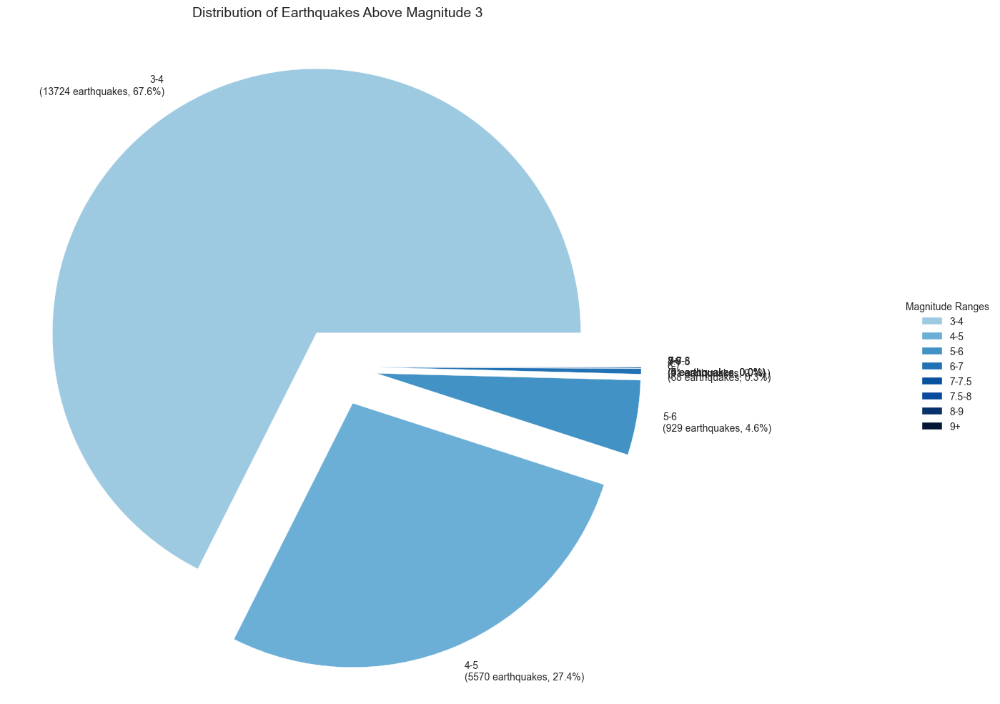

In [74]:
import matplotlib.pyplot as plt

# Filter earthquakes greater than magnitude 3
df_filtered = df[df['xM'] > 3]

magnitude_ranges = pd.cut(df_filtered['xM'],
                        bins=[3, 4, 5, 6, 7, 7.5, 8, 9, 10],
                        labels=['3-4', '4-5', '5-6', '6-7', '7-7.5', '7.5-8', '8-9', '9+'])

magnitude_counts = magnitude_ranges.value_counts().sort_index()
magnitude_percentages = (magnitude_counts / len(df_filtered) * 100).round(1)

# Print percentage distributions
print("\nMagnitude Distribution of Earthquakes Above 3:")
for label, count, pct in zip(magnitude_counts.index, magnitude_counts, magnitude_percentages):
    print(f"Magnitude {label}: {count} earthquakes ({pct}%)")

# Create pie chart
plt.figure(figsize=(15, 12))

# Create pie chart on the left side
plt.pie(magnitude_counts,
        labels=[f'{label}\n({count} earthquakes, {pct}%)' 
                for label, count, pct in zip(magnitude_counts.index,
                                           magnitude_counts, 
                                           magnitude_percentages)],
        autopct='',
        colors=['#9ecae1', '#6baed6', '#4292c6', '#2171b5',
                '#08519c', '#084a9c', '#08306b', '#041835'],
        explode=[0.15] * len(magnitude_counts))

# Add legend on the right side
plt.legend(magnitude_counts.index,
          title="Magnitude Ranges",
          loc="center right",
          bbox_to_anchor=(1.5, 0.5))

plt.title('Distribution of Earthquakes Above Magnitude 3', pad=20, size=14)
plt.show()

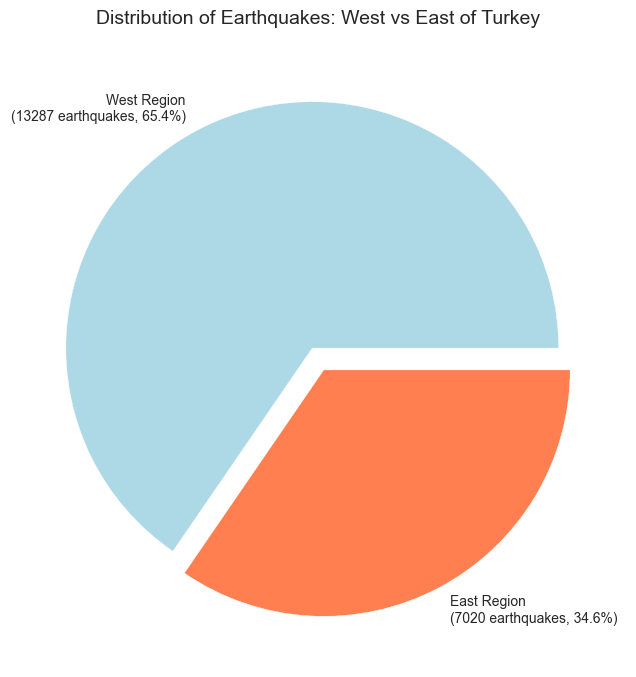


Earthquake Distribution Analysis:
West of 35°E: 13287 earthquakes (65.4%)
East of 35°E: 7020 earthquakes (34.6%)


In [75]:
import matplotlib.pyplot as plt
import numpy as np

# Center longitude of Turkey (approximately 35 degrees)
center_longitude = 35

# West and east earthquakes
west_quakes = df[df['Boylam'] < center_longitude]
east_quakes = df[df['Boylam'] >= center_longitude]

# Calculations
west_count = len(west_quakes)
east_count = len(east_quakes)
total_count = west_count + east_count

west_percentage = np.round(west_count / total_count * 100, 1)
east_percentage = np.round(east_count / total_count * 100, 1)

# Pie chart
plt.figure(figsize=(10, 8))
plt.pie([west_count, east_count],
        labels=[f'West Region\n({west_count} earthquakes, {west_percentage}%)',
                f'East Region\n({east_count} earthquakes, {east_percentage}%)'],
        colors=['lightblue', 'coral'],
        explode=[0.05, 0.05],
        autopct='')

plt.title('Distribution of Earthquakes: West vs East of Turkey', pad=20, size=14)
plt.show()

# Print statistics
print("\nEarthquake Distribution Analysis:")
print(f"West of {center_longitude}°E: {west_count} earthquakes ({west_percentage}%)")
print(f"East of {center_longitude}°E: {east_count} earthquakes ({east_percentage}%)")

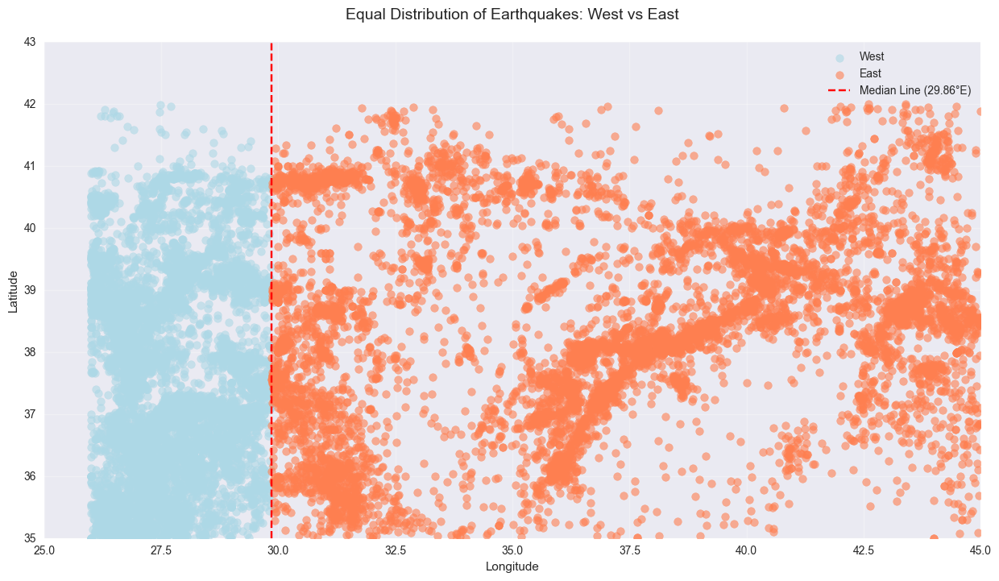


Equal Distribution Analysis:
Median Longitude: 29.86°E
West of median: 10152 earthquakes (50%)
East of median: 10155 earthquakes (50%)


In [76]:
import numpy as np
import matplotlib.pyplot as plt

# Depremleri boylamlarına göre sırala
sorted_longitudes = np.sort(df['Boylam'].values)

# Medyan boylamı bul (depremleri eşit sayıda ikiye bölen boylam)
median_longitude = np.median(sorted_longitudes)

# Batı ve doğu depremleri
west_quakes = df[df['Boylam'] < median_longitude]
east_quakes = df[df['Boylam'] >= median_longitude]

# Türkiye haritası için sınırlar
plt.figure(figsize=(15, 8))

# Depremleri çiz
plt.scatter(west_quakes['Boylam'], west_quakes['Enlem'], 
           c='lightblue', label='West', alpha=0.6)
plt.scatter(east_quakes['Boylam'], east_quakes['Enlem'], 
           c='coral', label='East', alpha=0.6)

# Medyan çizgisi
plt.axvline(x=median_longitude, color='red', linestyle='--', 
           label=f'Median Line ({median_longitude:.2f}°E)')

# Harita sınırları
plt.xlim(25, 45)  # Türkiye'nin boylam sınırları
plt.ylim(35, 43)  # Türkiye'nin enlem sınırları

plt.title('Equal Distribution of Earthquakes: West vs East', pad=20, size=14)
plt.xlabel('Longitude')
plt.ylabel('Latitude')
plt.grid(True, alpha=0.3)
plt.legend()

plt.show()

# İstatistikleri yazdır
print("\nEqual Distribution Analysis:")
print(f"Median Longitude: {median_longitude:.2f}°E")
print(f"West of median: {len(west_quakes)} earthquakes (50%)")
print(f"East of median: {len(east_quakes)} earthquakes (50%)")

In [77]:
import folium
from folium import plugins
import numpy as np

# Depremleri boylamlarına göre sırala ve medyan boylamı bul
sorted_longitudes = np.sort(df['Boylam'].values)
median_longitude = np.median(sorted_longitudes)

# Batı ve doğu depremleri
west_quakes = df[df['Boylam'] < median_longitude]
east_quakes = df[df['Boylam'] >= median_longitude]

# Türkiye'nin merkezi koordinatları
turkey_center = [39.0, 35.0]

# Harita oluştur
m = folium.Map(location=turkey_center, zoom_start=6)

# Batı depremleri (Mavi)
for idx, row in west_quakes.iterrows():
    folium.CircleMarker(
        location=[row['Enlem'], row['Boylam']],
        radius=row['xM'],
        color='blue',
        fill=True,
        fillColor='blue',
        fillOpacity=0.7,
        popup=f"Magnitude: {row['xM']}"
    ).add_to(m)

# Doğu depremleri (Kırmızı)
for idx, row in east_quakes.iterrows():
    folium.CircleMarker(
        location=[row['Enlem'], row['Boylam']],
        radius=row['xM'],
        color='red',
        fill=True,
        fillColor='red',
        fillOpacity=0.7,
        popup=f"Magnitude: {row['xM']}"
    ).add_to(m)

# Medyan çizgisi
folium.PolyLine(
    locations=[[35, median_longitude], [42, median_longitude]],
    color='black',
    weight=2,
    dash_array='10',
    popup=f'Median Line: {median_longitude:.2f}°E'
).add_to(m)

# Lejant ekle
legend_html = folium.Element('''
<div style="position: fixed; 
            bottom: 50px; left: 50px; width: 200px; height: 90px; 
            border:2px solid grey; z-index:9999; background-color:white;
            opacity:0.8;
            font-size:12px;
            padding: 10px">
            <b>Earthquake Distribution</b><br>
            <i class="fa fa-circle" style="color:blue"></i> West Region<br>
            <i class="fa fa-circle" style="color:red"></i> East Region<br>
            <hr style="margin:5px">
            Median Line: {:.2f}°E
</div>
'''.format(median_longitude))

m.get_root().html.add_child(legend_html)
m

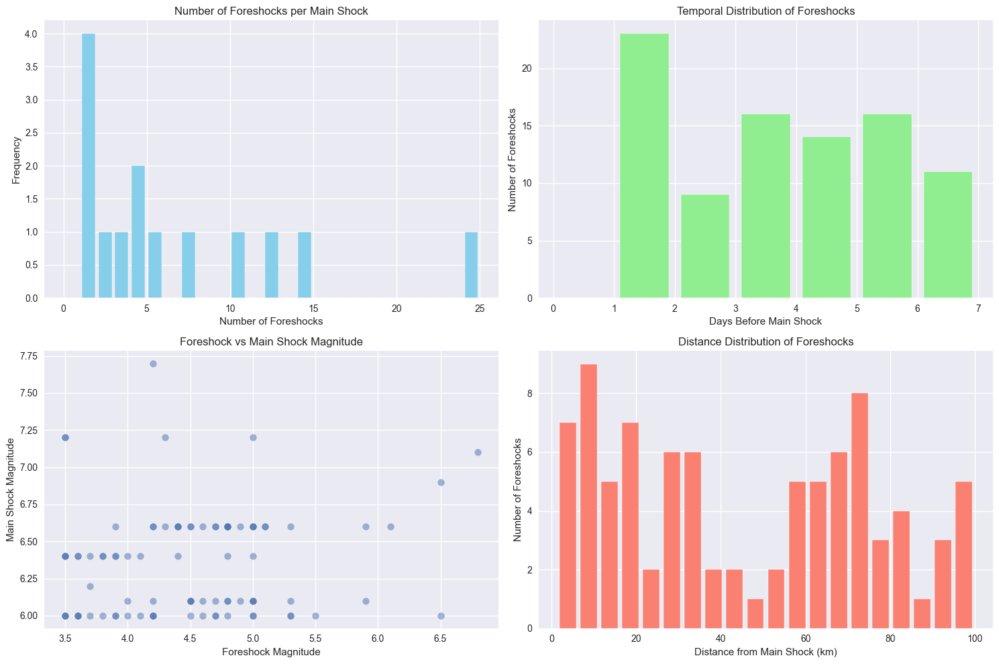


Foreshock Analysis Statistics:
Number of Main Shocks (M≥6.0): 104
Total Number of Foreshocks: 89
Average Foreshocks per Main Shock: 0.9

Foreshock Characteristics:
Average Magnitude: 4.50
Average Distance: 45.5 km
Average Days Before: 3.3 days

Main Shocks with Most Foreshocks:

Date: 1969-03-28
Magnitude: 6.6
Number of Foreshocks: 24

Date: 2023-02-20
Magnitude: 6.4
Number of Foreshocks: 14

Date: 1995-10-01
Magnitude: 6.0
Number of Foreshocks: 12

Date: 1969-03-25
Magnitude: 6.1
Number of Foreshocks: 10

Date: 1966-08-20
Magnitude: 6.0
Number of Foreshocks: 7


In [78]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
from datetime import timedelta

def analyze_foreshocks(df, main_shock_magnitude=6.0, time_window_days=7, distance_km=100):
    """
    Analyzes foreshocks
    
    Parameters:
    - main_shock_magnitude: Minimum magnitude for main shock
    - time_window_days: Time window for foreshocks (days)
    - distance_km: Maximum distance for foreshocks (km)
    """
    
    # Sort data by date
    df = df.sort_values('Olus tarihi')
    
    # Identify main shocks (large earthquakes)
    main_shocks = df[df['xM'] >= main_shock_magnitude].copy()
    
    foreshock_data = []
    
    for _, main_shock in main_shocks.iterrows():
        # Time window before main shock
        time_window_start = pd.to_datetime(main_shock['Olus tarihi']) - timedelta(days=time_window_days)
        
        # Get all earthquakes in this time period
        potential_foreshocks = df[
            (pd.to_datetime(df['Olus tarihi']) >= time_window_start) & 
            (pd.to_datetime(df['Olus tarihi']) < pd.to_datetime(main_shock['Olus tarihi']))
        ]
        
        # Calculate distance and filter
        for _, foreshock in potential_foreshocks.iterrows():
            # Distance between two points (km)
            distance = np.sqrt(
                (main_shock['Enlem'] - foreshock['Enlem'])**2 + 
                (main_shock['Boylam'] - foreshock['Boylam'])**2
            ) * 111  # Approximate degree -> km conversion
            
            if distance <= distance_km:
                foreshock_data.append({
                    'Main_Shock_Date': pd.to_datetime(main_shock['Olus tarihi']),
                    'Main_Shock_Magnitude': main_shock['xM'],
                    'Main_Shock_Lat': main_shock['Enlem'],
                    'Main_Shock_Lon': main_shock['Boylam'],
                    'Foreshock_Date': pd.to_datetime(foreshock['Olus tarihi']),
                    'Foreshock_Magnitude': foreshock['xM'],
                    'Foreshock_Lat': foreshock['Enlem'],
                    'Foreshock_Lon': foreshock['Boylam'],
                    'Distance_km': distance,
                    'Days_Before': (pd.to_datetime(main_shock['Olus tarihi']) - pd.to_datetime(foreshock['Olus tarihi'])).days
                })
    
    foreshocks_df = pd.DataFrame(foreshock_data)
    return main_shocks, foreshocks_df

# Run analysis
main_shocks, foreshocks_df = analyze_foreshocks(df, 
                                               main_shock_magnitude=6.0, 
                                               time_window_days=7, 
                                               distance_km=100)

# Visualize results
plt.figure(figsize=(15, 10))

# 1. Number of Foreshocks
plt.subplot(2, 2, 1)
main_shock_counts = foreshocks_df.groupby('Main_Shock_Date').size()
plt.hist(main_shock_counts, bins=range(max(main_shock_counts)+2), 
         rwidth=0.8, color='skyblue')
plt.title('Number of Foreshocks per Main Shock')
plt.xlabel('Number of Foreshocks')
plt.ylabel('Frequency')

# 2. Temporal Distribution of Foreshocks
plt.subplot(2, 2, 2)
plt.hist(foreshocks_df['Days_Before'], bins=7, 
         range=(0, 7), color='lightgreen', rwidth=0.8)
plt.title('Temporal Distribution of Foreshocks')
plt.xlabel('Days Before Main Shock')
plt.ylabel('Number of Foreshocks')

# 3. Foreshock-Main Shock Magnitude Relationship
plt.subplot(2, 2, 3)
plt.scatter(foreshocks_df['Foreshock_Magnitude'], 
           foreshocks_df['Main_Shock_Magnitude'], 
           alpha=0.5)
plt.title('Foreshock vs Main Shock Magnitude')
plt.xlabel('Foreshock Magnitude')
plt.ylabel('Main Shock Magnitude')

# 4. Distance Distribution
plt.subplot(2, 2, 4)
plt.hist(foreshocks_df['Distance_km'], bins=20, color='salmon', rwidth=0.8)
plt.title('Distance Distribution of Foreshocks')
plt.xlabel('Distance from Main Shock (km)')
plt.ylabel('Number of Foreshocks')

plt.tight_layout()
plt.show()

# Print statistics
print("\nForeshock Analysis Statistics:")
print("=============================")
print(f"Number of Main Shocks (M≥6.0): {len(main_shocks)}")
print(f"Total Number of Foreshocks: {len(foreshocks_df)}")
print(f"Average Foreshocks per Main Shock: {len(foreshocks_df)/len(main_shocks):.1f}")

print("\nForeshock Characteristics:")
print(f"Average Magnitude: {foreshocks_df['Foreshock_Magnitude'].mean():.2f}")
print(f"Average Distance: {foreshocks_df['Distance_km'].mean():.1f} km")
print(f"Average Days Before: {foreshocks_df['Days_Before'].mean():.1f} days")

# List events with most foreshocks
print("\nMain Shocks with Most Foreshocks:")
top_events = foreshocks_df.groupby('Main_Shock_Date').size().sort_values(ascending=False).head()
for date, count in top_events.items():
    main_shock = main_shocks[main_shocks['Olus tarihi'] == date.strftime('%Y-%m-%d')].iloc[0]
    print(f"\nDate: {date.strftime('%Y-%m-%d')}")
    print(f"Magnitude: {main_shock['xM']}")
    print(f"Number of Foreshocks: {count}")

In [79]:
!pip install dash
!pip install plotly
!pip isntall dash-html-components
!pip install plotly

Defaulting to user installation because normal site-packages is not writeable



[notice] A new release of pip is available: 24.3.1 -> 25.0
[notice] To update, run: C:\Users\İSAILICA\AppData\Local\Microsoft\WindowsApps\PythonSoftwareFoundation.Python.3.12_qbz5n2kfra8p0\python.exe -m pip install --upgrade pip


Defaulting to user installation because normal site-packages is not writeable



[notice] A new release of pip is available: 24.3.1 -> 25.0
[notice] To update, run: C:\Users\İSAILICA\AppData\Local\Microsoft\WindowsApps\PythonSoftwareFoundation.Python.3.12_qbz5n2kfra8p0\python.exe -m pip install --upgrade pip
ERROR: unknown command "isntall" - maybe you meant "install"



Defaulting to user installation because normal site-packages is not writeable



[notice] A new release of pip is available: 24.3.1 -> 25.0
[notice] To update, run: C:\Users\İSAILICA\AppData\Local\Microsoft\WindowsApps\PythonSoftwareFoundation.Python.3.12_qbz5n2kfra8p0\python.exe -m pip install --upgrade pip


In [80]:
import dash
from dash import dcc, html
from dash.dependencies import Input, Output
import plotly.express as px
import plotly.graph_objects as go
from datetime import datetime
import pandas as pd

# Prepare dataframe
major_quakes_clean = df.copy()
major_quakes_clean['Date'] = pd.to_datetime(major_quakes_clean['Olus tarihi'])
major_quakes_clean['Magnitude'] = major_quakes_clean['xM']
major_quakes_clean['Depth'] = major_quakes_clean['Derinlik']
major_quakes_clean['Latitude'] = major_quakes_clean['Enlem'] 
major_quakes_clean['Longitude'] = major_quakes_clean['Boylam']

# Initialize Dash app
app = dash.Dash(__name__, suppress_callback_exceptions=True)

# Layout design
app.layout = html.Div([
    # Title
    html.H1("Earthquake Analysis Dashboard", style={'textAlign': 'center', 'margin': '20px'}),
    
    # Filters
    html.Div([
        # Date range picker
        html.Div([
            html.H4("Date Range"),
            dcc.DatePickerRange(
                id='date-picker',
                start_date=major_quakes_clean['Date'].min(),
                end_date=major_quakes_clean['Date'].max(),
                display_format='YYYY-MM-DD',
                style={'margin': '10px 0'}
            )
        ], style={'width': '30%', 'display': 'inline-block', 'padding': '10px'}),
        
        # Magnitude range slider
        html.Div([
            html.H4("Magnitude Range"),
            dcc.RangeSlider(
                id='magnitude-slider',
                min=float(major_quakes_clean['Magnitude'].min()),
                max=float(major_quakes_clean['Magnitude'].max()),
                step=0.1,
                marks={i: f'{i:.1f}' for i in range(int(major_quakes_clean['Magnitude'].min()), 
                                                   int(major_quakes_clean['Magnitude'].max())+1)},
                value=[float(major_quakes_clean['Magnitude'].min()),
                       float(major_quakes_clean['Magnitude'].max())]
            )
        ], style={'width': '40%', 'display': 'inline-block', 'padding': '10px'}),
        
        # Depth range slider
        html.Div([
            html.H4("Depth Range (km)"),
            dcc.RangeSlider(
                id='depth-slider', 
                min=float(major_quakes_clean['Depth'].min()),
                max=float(major_quakes_clean['Depth'].max()),
                step=1,
                marks={i: str(i) for i in range(0, int(major_quakes_clean['Depth'].max())+1, 20)},
                value=[float(major_quakes_clean['Depth'].min()),
                       float(major_quakes_clean['Depth'].max())]
            )
        ], style={'width': '30%', 'display': 'inline-block', 'padding': '10px'})
    ], style={'margin': '20px', 'padding': '20px', 'backgroundColor': '#f8f9fa', 'borderRadius': '5px'}),
    
    # Graphs
    html.Div([
        # Left side - Map and Time Series
        html.Div([
            dcc.Graph(id='map-plot', style={'height': '500px'}),
            dcc.Graph(id='time-series', style={'height': '400px'})
        ], style={'width': '60%', 'display': 'inline-block', 'verticalAlign': 'top'}),
        
        # Right side - Distributions
        html.Div([
            dcc.Graph(id='magnitude-dist', style={'height': '400px'}),
            dcc.Graph(id='depth-dist', style={'height': '400px'})
        ], style={'width': '40%', 'display': 'inline-block', 'verticalAlign': 'top'})
    ]),
    
    # Statistics
    html.Div([
        html.H3("Summary Statistics", style={'textAlign': 'center', 'margin': '20px'}),
        html.Div(id='statistics', style={'padding': '20px', 'backgroundColor': '#f8f9fa', 'borderRadius': '5px'})
    ])
])

# Callback functions
@app.callback(
    [Output('map-plot', 'figure'),
     Output('time-series', 'figure'),
     Output('magnitude-dist', 'figure'),
     Output('depth-dist', 'figure'),
     Output('statistics', 'children')],
    [Input('date-picker', 'start_date'),
     Input('date-picker', 'end_date'),
     Input('magnitude-slider', 'value'),
     Input('depth-slider', 'value')]
)
def update_figures(start_date, end_date, magnitude_range, depth_range):
    try:
        # Filtering
        filtered_df = major_quakes_clean[
            (major_quakes_clean['Date'] >= start_date) &
            (major_quakes_clean['Date'] <= end_date) &
            (major_quakes_clean['Magnitude'] >= magnitude_range[0]) &
            (major_quakes_clean['Magnitude'] <= magnitude_range[1]) &
            (major_quakes_clean['Depth'] >= depth_range[0]) &
            (major_quakes_clean['Depth'] <= depth_range[1])
        ].copy()
        
        # Map
        map_fig = px.scatter_mapbox(filtered_df,
                                  lat='Latitude',
                                  lon='Longitude',
                                  size='Magnitude',
                                  color='Depth',
                                  hover_data=['Date', 'Magnitude', 'Depth'],
                                  zoom=5,
                                  center={'lat': 39, 'lon': 35},
                                  title='Earthquake Locations')
        map_fig.update_layout(mapbox_style='carto-positron')
        
        # Time Series
        time_fig = px.scatter(filtered_df,
                            x='Date',
                            y='Magnitude',
                            size='Magnitude',
                            color='Depth',
                            title='Time Series Analysis')
        
        # Magnitude Distribution
        mag_fig = px.histogram(filtered_df,
                             x='Magnitude',
                             nbins=30,
                             title='Magnitude Distribution')
        
        # Depth Distribution
        depth_fig = px.histogram(filtered_df,
                               x='Depth',
                               nbins=30,
                               title='Depth Distribution')
        
        # Statistics
        stats = html.Div([
            html.P(f"Total Number of Earthquakes: {len(filtered_df):,}"),
            html.P(f"Average Magnitude: {filtered_df['Magnitude'].mean():.2f}"),
            html.P(f"Average Depth: {filtered_df['Depth'].mean():.2f} km"),
            html.P(f"Largest Earthquake: {filtered_df['Magnitude'].max():.2f}"),
            html.P(f"Shallowest Depth: {filtered_df['Depth'].min():.2f} km"),
            html.P(f"Deepest Point: {filtered_df['Depth'].max():.2f} km")
        ])
        
        return map_fig, time_fig, mag_fig, depth_fig, stats
        
    except Exception as e:
        print(f"Error occurred: {str(e)}")
        return {}, {}, {}, {}, html.Div("Error loading data.")

if __name__ == '__main__':
    try:
        app.run_server(debug=True, port=8050)
    except Exception as e:
        print(f"Error starting server: {str(e)}")

In [81]:
import dash
from dash import dcc, html
from dash.dependencies import Input, Output
import plotly.express as px
import plotly.graph_objects as go
from datetime import datetime
import pandas as pd
import numpy as np
from plotly.subplots import make_subplots

try:
    # Data preparation
    major_quakes_clean = df.copy()
    major_quakes_clean['Date'] = pd.to_datetime(major_quakes_clean['Olus tarihi'])
    major_quakes_clean['Magnitude'] = major_quakes_clean['xM']
    major_quakes_clean['Depth'] = major_quakes_clean['Derinlik']
    major_quakes_clean['Latitude'] = major_quakes_clean['Enlem'] 
    major_quakes_clean['Longitude'] = major_quakes_clean['Boylam']
    major_quakes_clean['Year'] = major_quakes_clean['Date'].dt.year
    major_quakes_clean['Month'] = major_quakes_clean['Date'].dt.month
    major_quakes_clean['Hour'] = major_quakes_clean['Date'].dt.hour

    # Theme colors
    colors = {
        'background': '#f8f9fa',
        'text': '#343a40', 
        'primary': '#007bff',
        'secondary': '#6c757d'
    }

    # Dash application
    app = dash.Dash(__name__, suppress_callback_exceptions=True)

    app.layout = html.Div([
        # Header
        html.Div([
            html.H1("Turkey Earthquake Analysis Dashboard",
                    style={'textAlign': 'center', 'color': colors['text'], 'padding': '20px'}),
            html.P("Comprehensive Earthquake Analysis Between 1915-2024", 
                   style={'textAlign': 'center', 'color': colors['secondary']})
        ], style={'backgroundColor': colors['background'], 'padding': '20px', 'marginBottom': '20px'}),

        # Filters 
        html.Div([
            html.Div([
                html.H4("Select Time Range", style={'color': colors['text']}),
                dcc.DatePickerRange(
                    id='date-picker',
                    start_date=major_quakes_clean['Date'].min(),
                    end_date=major_quakes_clean['Date'].max(),
                    display_format='YYYY-MM-DD',
                    style={'margin': '10px'}
                )
            ], style={'width': '30%', 'display': 'inline-block', 'padding': '10px'}),

            html.Div([
                html.H4("Magnitude Range", style={'color': colors['text']}),
                dcc.RangeSlider(
                    id='magnitude-slider',
                    min=float(major_quakes_clean['Magnitude'].min()),
                    max=float(major_quakes_clean['Magnitude'].max()),
                    step=0.1,
                    marks={i: f'{i:.1f}' for i in np.arange(
                        float(major_quakes_clean['Magnitude'].min()),
                        float(major_quakes_clean['Magnitude'].max())+0.5,
                        0.5
                    )},
                    value=[3.0, float(major_quakes_clean['Magnitude'].max())]
                )
            ], style={'width': '35%', 'display': 'inline-block', 'padding': '10px'}),

            html.Div([
                html.H4("Depth Range (km)", style={'color': colors['text']}),
                dcc.RangeSlider(
                    id='depth-slider',
                    min=0,
                    max=100,
                    step=5,
                    marks={i: str(i) for i in range(0, 101, 10)},
                    value=[0, 50]
                )
            ], style={'width': '35%', 'display': 'inline-block', 'padding': '10px'})
        ], style={'backgroundColor': colors['background'], 'padding': '20px', 'marginBottom': '20px'}),

        # Main Dashboard
        html.Div([
            # Left Panel
            html.Div([
                dcc.Graph(id='map-plot', style={'height': '500px'}),
                html.Div([
                    dcc.Graph(id='time-series', style={'width': '50%'}),
                    dcc.Graph(id='monthly-heatmap', style={'width': '50%'})
                ], style={'display': 'flex', 'gap': '20px', 'marginTop': '20px'})
            ], style={'width': '65%', 'padding': '10px'}),

            # Right Panel  
            html.Div([
                html.Div([
                    html.H3("Summary Statistics", style={'textAlign': 'center', 'color': colors['text']}),
                    html.Div(id='statistics', style={'padding': '20px'})
                ], style={'backgroundColor': colors['background'], 'marginBottom': '20px'}),

                dcc.Graph(id='magnitude-dist', style={'marginBottom': '20px'}),
                dcc.Graph(id='depth-dist', style={'marginBottom': '20px'}),
                dcc.Graph(id='hourly-dist', style={'marginBottom': '20px'})
            ], style={'width': '35%', 'padding': '10px'})
        ], style={'display': 'flex', 'gap': '20px', 'marginBottom': '20px'}),

        # Bottom Panel
        html.Div([
            html.H3("Detailed Analysis", style={'textAlign': 'center', 'color': colors['text'], 'marginTop': '20px'}),
            html.Div([
                dcc.Graph(id='magnitude-depth-scatter', style={'width': '50%'}),
                dcc.Graph(id='yearly-trend', style={'width': '50%'})
            ], style={'display': 'flex', 'gap': '20px'})
        ])
    ], style={'padding': '20px', 'maxWidth': '1800px', 'margin': '0 auto'})

    @app.callback(
        [Output('map-plot', 'figure'),
         Output('time-series', 'figure'),
         Output('magnitude-dist', 'figure'),
         Output('depth-dist', 'figure'),
         Output('statistics', 'children'),
         Output('monthly-heatmap', 'figure'),
         Output('hourly-dist', 'figure'),
         Output('magnitude-depth-scatter', 'figure'),
         Output('yearly-trend', 'figure')],
        [Input('date-picker', 'start_date'),
         Input('date-picker', 'end_date'),
         Input('magnitude-slider', 'value'),
         Input('depth-slider', 'value')]
    )
    def update_figures(start_date, end_date, magnitude_range, depth_range):
        try:
            filtered_df = major_quakes_clean[
                (major_quakes_clean['Date'] >= start_date) &
                (major_quakes_clean['Date'] <= end_date) &
                (major_quakes_clean['Magnitude'] >= magnitude_range[0]) &
                (major_quakes_clean['Magnitude'] <= magnitude_range[1]) &
                (major_quakes_clean['Depth'] >= depth_range[0]) &
                (major_quakes_clean['Depth'] <= depth_range[1])
            ].copy()

            if len(filtered_df) == 0:
                raise ValueError("No data found matching the selected criteria")

            map_fig = px.scatter_mapbox(filtered_df,
                                      lat='Latitude',
                                      lon='Longitude', 
                                      size='Magnitude',
                                      color='Depth',
                                      hover_data=['Date', 'Magnitude', 'Depth'],
                                      zoom=5,
                                      center={'lat': 39, 'lon': 35},
                                      title='Earthquake Locations',
                                      color_continuous_scale='Viridis',
                                      height=500)
            map_fig.update_layout(mapbox_style='carto-positron')

            time_fig = px.scatter(filtered_df,
                                x='Date',
                                y='Magnitude',
                                size='Magnitude',
                                color='Depth',
                                title='Earthquake Magnitudes Time Series',
                                height=400)

            mag_fig = px.histogram(filtered_df,
                                 x='Magnitude',
                                 nbins=30,
                                 title='Magnitude Distribution',
                                 color_discrete_sequence=[colors['primary']],
                                 height=300)

            depth_fig = px.histogram(filtered_df,
                                   x='Depth',
                                   nbins=30,
                                   title='Depth Distribution',
                                   color_discrete_sequence=[colors['secondary']],
                                   height=300)

            monthly_data = filtered_df.groupby(['Year', 'Month']).size().reset_index(name='count')
            monthly_heatmap = px.density_heatmap(monthly_data,
                                               x='Month',
                                               y='Year',
                                               z='count',
                                               title='Monthly Earthquake Density',
                                               height=400)

            hourly_fig = px.histogram(filtered_df,
                                    x='Hour',
                                    title='Hourly Earthquake Distribution',
                                    nbins=24,
                                    height=300)

            mag_depth_scatter = px.scatter(filtered_df,
                                         x='Magnitude',
                                         y='Depth',
                                         title='Magnitude-Depth Relationship',
                                         height=400)

            yearly_trend = px.box(filtered_df,
                                x='Year',
                                y='Magnitude',
                                title='Earthquake Magnitudes by Year',
                                height=400)

            stats = html.Div([
                html.Div([
                    html.H4("General Statistics"),
                    html.P(f"Total Number of Earthquakes: {len(filtered_df):,}"),
                    html.P(f"Average Magnitude: {filtered_df['Magnitude'].mean():.2f}"),
                    html.P(f"Average Depth: {filtered_df['Depth'].mean():.2f} km")
                ], style={'marginBottom': '20px'}),
                html.Div([
                    html.H4("Extreme Values"),
                    html.P(f"Largest Earthquake: {filtered_df['Magnitude'].max():.2f}"),
                    html.P(f"Deepest Earthquake: {filtered_df['Depth'].max():.2f} km"),
                    html.P(f"Shallowest Earthquake: {filtered_df['Depth'].min():.2f} km")
                ], style={'marginBottom': '20px'}),
                html.Div([
                    html.H4("Distribution Statistics"),
                    html.P(f"Magnitude Median: {filtered_df['Magnitude'].median():.2f}"),
                    html.P(f"Depth Median: {filtered_df['Depth'].median():.2f} km"),
                    html.P(f"Standard Deviation (Magnitude): {filtered_df['Magnitude'].std():.2f}")
                ])
            ])

            return map_fig, time_fig, mag_fig, depth_fig, stats, monthly_heatmap, hourly_fig, mag_depth_scatter, yearly_trend

        except Exception as e:
            print(f"Error: {str(e)}")
            return [{} for _ in range(8)] + [html.Div("Error loading data")]

    if __name__ == '__main__':
        app.run_server(debug=True, port=8050)

except Exception as e:
    print(f"Error starting application: {str(e)}")